# BverI Miniprojekt: Underwater Imagery

## Introduction
Dieses Notebook beschäftigt sich mit Image Segmentation von Unterwasser-Bilder. Dazu wird zuerst eine Analyse des SUIM Dataset gemacht. Anschliessend wird auf Grundlage des Papers von Islam Et al. eine Baseline implementiert. Die Baseline dient als Referenz für weitere implementierte Architekturen.

## Notebook Configuration

In [ ]:
%pip install pytorch-lightning
%pip install torchmetrics
%pip install torchshow
%pip install torchinfo
%pip install albumentations

In [ ]:
import os
import zipfile
from pathlib import Path
from typing import Callable, Tuple

import gdown

import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib.colors import ListedColormap, BoundaryNorm
import pandas as pd

import torch
import torch.nn as nn
import torch.nn.functional as F
import torchshow as ts
import torch.optim as optim
import torchmetrics
import torchinfo
from torch.utils.data import Dataset, DataLoader
from torchvision import transforms
from torchvision.models import VGG16_Weights, resnet50, ResNet50_Weights, vgg16
from pytorch_lightning.callbacks import ModelCheckpoint
import pytorch_lightning as pl

from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"
from tqdm.notebook import tqdm
from IPython.display import Image, display
from PIL import Image
import re

import albumentations as A

from collections import Counter

In [ ]:
try:
    import google.colab

    IN_COLAB = True
except:
    IN_COLAB = False

if IN_COLAB:
    from google.colab import drive

    drive.mount("/content/drive")

Die `RUN_TRAINING` Variable kann auf `True` gesetzt werden, um beim Ausführen des Notebooks die Trainings jeweils auszuführen. Wenn die Variable auf `False` gesetzt wird, wird das Notebook nur die bereits gespeicherten Modelle laden und die Evaluation durchführen.

In [4]:
RUN_TRAINING = False

## Utility Functions

In [5]:
val_to_color = {
    0: "#000000",
    1: "#0000FF",
    2: "#00FFFF",
    3: "#FF0000",
    4: "#FF00FF",
    5: "#FFFF00",
}
cmap = ListedColormap([val_to_color[key] for key in __builtins__.sorted(val_to_color.keys())])
norm = BoundaryNorm(range(len(val_to_color) + 1), cmap.N)

colors_to_8cats = {
    (0, 0, 0): 0,        # #000000 --> [BW] Background waterbody
    (0, 0, 255): 1,      # #0000FF --> [HD] Human divers
    (0, 255, 0): 2,      # #00FF00 --> [PF] Plants/sea-grass
    (0, 255, 255): 3,    # #00FFFF --> [WR] Wrecks/ruins
    (255, 0, 0): 4,      # #FF0000 --> [RO] Robots/instruments
    (255, 0, 255): 5,    # #FF00FF --> [RI] Reefs and invertebrates
    (255, 255, 0): 6,    # #FFFF00 --> [FV] Fish and vertebrates
    (255, 255, 255): 7,  # #FFFFFF --> [SR] Sand/sea-floor (& rocks)
}
colors_to_5cats = {
    (0, 0, 0): 0,        # #000000 --> [BW] Background waterbody
    (0, 255, 0): 0,      # #00FF00 --> [PF] Plants/sea-grass
    (255, 255, 255): 0,  # #FFFFFF --> [SR] Sand/sea-floor (& rocks)
    (0, 0, 255): 1,      # #0000FF --> [HD] Human divers
    (0, 255, 255): 2,    # #00FFFF --> [WR] Wrecks/ruins
    (255, 0, 0): 3,      # #FF0000 --> [RO] Robots/instruments
    (255, 0, 255): 4,    # #FF00FF --> [RI] Reefs and invertebrates
    (255, 255, 0): 5,    # #FFFF00 --> [FV] Fish and vertebrates
}

def plot_image_label(base_dir, dataset, filename, show_plot = True, save_path = None):
    """
    Plots the image and label side by side.

    Args:
        base_dir (str): The base directory of the project.
        dataset (str): The dataset to use.
        filename (str): The filename of the image and label.
        show_plot (bool): Whether to show the plot.
        save_path (str): The path to save the plot.
    """

    image = Image.open(os.path.join(base_dir, "data", "dataset", dataset, "images", filename + ".jpg"))
    label = Image.open(os.path.join(base_dir, "data", "dataset", dataset, "masks", filename + ".bmp"))

    fig, ax = plt.subplots(1, 2, figsize = (15, 5))

    _ = ax[0].imshow(image)
    _ = ax[0].axis("off")
    _ = ax[0].set_title("Image")

    _ = ax[1].imshow(label, cmap = cmap, norm = norm)
    _ = ax[1].axis("off")
    _ = ax[1].set_title("Label")

    fig.tight_layout()

    if show_plot:
        plt.show()

    if save_path:
        plt.savefig(save_path)

def plot_image_label_prediction(image, label, prediction, show_plot = True, save_path = None):
    """
    Plots the image, label, and prediction side by side.

    Args:
        image (np.array): The image.
        label (np.array): The label.
        prediction (np.array): The prediction.
        show_plot (bool): Whether to show the plot.
        save_path (str): The path to save the plot.
    """

    fig, ax = plt.subplots(1, 3, figsize = (15, 5))

    _ = ax[0].imshow(image)
    _ = ax[0].axis("off")
    _ = ax[0].set_title("Image")

    _ = ax[1].imshow(prediction, cmap = cmap, norm = norm)
    _ = ax[1].axis("off")
    _ = ax[1].set_title("Prediction")

    _ = ax[2].imshow(label, cmap = cmap, norm = norm)
    _ = ax[2].axis("off")
    _ = ax[2].set_title("Label")

    fig.tight_layout()

    if show_plot:
        plt.show()

    if save_path:
        plt.savefig(save_path)

def plot_image_label_labelcategorical(image_path, image, label, label_categorical, show_plot = True, save_path = None):
    """
    Plots the image, label, and label (categorical) side by side.

    Args:
        image_path (str): The path to the image.
        image (np.array): The image.
        label (np.array): The label.
        label_categorical (np.array): The label (categorical).
        show_plot (bool): Whether to show the plot.
        save_path (str): The path to save the plot.
    """

    fig, ax = plt.subplots(1, 3, figsize = (15, 5))
    image_name = os.path.basename(image_path)

    _ = ax[0].imshow(image)
    _ = ax[0].axis("off")
    _ = ax[0].set_title(f"Image {image_name}")

    _ = ax[1].imshow(label)
    _ = ax[1].axis("off")
    _ = ax[1].set_title("Label")

    _ = ax[2].imshow(label_categorical, cmap = cmap, norm = norm)
    _ = ax[2].axis("off")
    _ = ax[2].set_title("Label (5 categories)")

    fig.tight_layout()

    if show_plot:
        plt.show()

    if save_path:
        plt.savefig(save_path)

def plot_distribution(train_dist, val_dist, test_dist, xlabel, ylabel, title, max_number_of_classes, label_attribute, use_log_scale = False, show_plot = True, save_path = None):
    """
    Plots the distribution of the train, val, and test datasets.

    Args:
        train_dist (pd.DataFrame): The distribution of the train dataset.
        val_dist (pd.DataFrame): The distribution of the val dataset.
        test_dist (pd.DataFrame): The distribution of the test dataset.
        xlabel (str): The x-axis label.
        ylabel (str): The y-axis label.
        title (str): The title of the plot.
        max_number_of_classes (int): The maximum number of classes to show.
        label_attribute (str): The label attribute.
        use_log_scale (bool): Whether to use log scale.
        show_plot (bool): Whether to show the plot.
        save_path (str): The path to save the plot.
    """

    map_label = {
        '0': "Background",
        '1': "Human divers",
        '2': "Wrecks/ruins",
        '3': "Robots/instruments",
        '4': "Reefs/invertebrates",
        '5': "Fish/vertebrates"
    }

    fig, ax = plt.subplots(1, 3, figsize = (15, 5))

    train_dist_sorted = train_dist.sort_values(by='Count', ascending=False)
    train_dist_sorted[label_attribute] = train_dist_sorted[label_attribute].apply(lambda x: map_label[x] if x in map_label.keys() else x)
    train_top_labels = train_dist_sorted.iloc[:max_number_of_classes]
    train_other_count = train_dist_sorted.iloc[max_number_of_classes:]['Count'].sum()
    train_other_row = pd.DataFrame({
        label_attribute: ['Other'],
        'Count': [train_other_count]
    })
    train_top_labels = pd.concat([train_top_labels[[label_attribute, 'Count']], train_other_row], ignore_index=True)
    train_labels = train_top_labels[label_attribute]
    train_counts = train_top_labels['Count']

    _ = ax[0].bar(train_labels, train_counts)
    _ = ax[0].set_xticks(range(len(train_labels)))
    _ = ax[0].set_xticklabels(train_labels, rotation=45)
    _ = ax[0].set_xlabel(xlabel)
    _ = ax[0].set_ylabel(ylabel)
    _ = ax[0].set_title("Train " + title)
    if use_log_scale:
      _ = ax[0].set_yscale("log")

    val_dist_sorted = val_dist.sort_values(by='Count', ascending=False)
    val_dist_sorted[label_attribute] = val_dist_sorted[label_attribute].apply(lambda x: map_label[x] if x in map_label.keys() else x)
    val_top_labels = val_dist_sorted.iloc[:max_number_of_classes]
    val_other_count = val_dist_sorted.iloc[max_number_of_classes:]['Count'].sum()
    val_other_row = pd.DataFrame({
        label_attribute: ['Other'],
        'Count': [val_other_count]
    })
    val_top_labels = pd.concat([val_top_labels[[label_attribute, 'Count']], val_other_row], ignore_index=True)
    val_labels = val_top_labels[label_attribute]
    val_counts = val_top_labels['Count']

    _ = ax[1].bar(val_labels, val_counts)
    _ = ax[1].set_xticks(range(len(val_labels)))
    _ = ax[1].set_xticklabels(val_labels, rotation=45)
    _ = ax[1].set_xlabel(xlabel)
    _ = ax[1].set_ylabel(ylabel)
    _ = ax[1].set_title("Val " + title)
    if use_log_scale:
      _ = ax[1].set_yscale("log")

    test_dist_sorted = test_dist.sort_values(by='Count', ascending=False)
    test_dist_sorted[label_attribute] = test_dist_sorted[label_attribute].apply(lambda x: map_label[x] if x in map_label.keys() else x)
    test_top_labels = test_dist_sorted.iloc[:max_number_of_classes]
    test_other_count = test_dist_sorted.iloc[max_number_of_classes:]['Count'].sum()
    test_other_row = pd.DataFrame({
        label_attribute: ['Other'],
        'Count': [test_other_count]
    })
    test_top_labels = pd.concat([test_top_labels[[label_attribute, 'Count']], test_other_row], ignore_index=True)
    test_labels = test_top_labels[label_attribute]
    test_counts = test_top_labels['Count']

    _ = ax[2].bar(test_labels, test_counts)
    _ = ax[2].set_xticks(range(len(test_labels)))
    _ = ax[2].set_xticklabels(test_labels, rotation=45)
    _ = ax[2].set_xlabel(xlabel)
    _ = ax[2].set_ylabel(ylabel)
    _ = ax[2].set_title("Test " + title)
    if use_log_scale:
      _ = ax[2].set_yscale("log")

    fig.tight_layout()

    if show_plot:
        plt.show()

    if save_path:
        plt.savefig(save_path)

def plot_four_images(img_1, title_1, img_2, title_2, img_3, title_3, img_4, title_4):
    """
    Plots four images side by side.

    Args:
        img_1 (np.array): The first image.
        title_1 (str): The title of the first image.
        img_2 (np.array): The second image.
        title_2 (str): The title of the second image.
        img_3 (np.array): The third image.
        title_3 (str): The title of the third image.
        img_4 (np.array): The fourth image.
        title_4 (str): The title of the fourth image.
    """

    fig, ax = plt.subplots(1, 4, figsize=(16, 4))

    _ = ax[0].imshow(img_1)
    _ = ax[0].set_title(title_1)
    _ = ax[0].axis('off')

    _ = ax[1].imshow(img_2)
    _ = ax[1].set_title(title_2)
    _ = ax[1].axis('off')

    _ = ax[2].imshow(img_3)
    _ = ax[2].set_title(title_3)
    _ = ax[2].axis('off')

    _ = ax[3].imshow(img_4)
    _ = ax[3].set_title(title_4)
    _ = ax[3].axis('off')

    fig.tight_layout()
    plt.show()

def rgb_to_hex(rgb):
    """
    Converts RGB to HEX.

    Args:
        rgb (tuple): The RGB tuple.
    """
    return "#{:02x}{:02x}{:02x}".format(rgb[0], rgb[1], rgb[2])

def ensure_dir(dir):
    """
    Ensures the directory exists.

    Args:
        dir (str): The directory.
    """
    if not os.path.exists(dir):
        os.makedirs(dir)

def download_from_google_drive(url, file_path):
    """
    Downloads a file from Google Drive.

    Args:
        url (str): The URL.
        file_path (str): The file path.
    """
    print(f"Downloading {url} to {file_path}...")
    gdown.download_folder(url, quiet = False, output = file_path)
    print("Download completed.")

def unzip_file(zip_path, target_dir):
    """
    Unzips a file to the target directory.

    Args:
        zip_path (str): The path to the ZIP file.
        target_dir (str): The target directory.
    """
    ensure_dir(target_dir)
    if not os.path.exists(target_dir) or len(os.listdir(target_dir)) == 0:
        print(f"extracting {zip_path} to {target_dir}...")
        file_name = os.path.basename(zip_path)
        with zipfile.ZipFile(zip_path, "r") as zip_ref:
            zip_ref.extractall(target_dir)
        for file in os.listdir(os.path.join(target_dir, file_name.split(".")[0])):
            os.rename(
                os.path.join(target_dir, file_name.split(".")[0], file),
                os.path.join(target_dir, file),
            )
        os.rmdir(os.path.join(target_dir, file_name.split(".")[0]))
        print(f"{zip_path} successfully extracted to {target_dir}.")
    else:
        print(f"{zip_path} already extracted to {target_dir}.")

## Data

### Data Acquisition

In [6]:
url__data_origin = "https://drive.google.com/drive/folders/10KMK0rNB43V2g30NcA1RYipL535DuZ-h"
fil__raw_dataset_trainvalidation = "train_val.zip"
fil__raw_dataset_test = "TEST.zip"

if IN_COLAB:
  dir__running = Path("/content/drive/MyDrive/bveri")
else:
  dir__running = os.path.join(os.getcwd(), "..")
dir__raw_data = os.path.join(dir__running, "data", "raw")

path__raw_dataset_trainvalidation = os.path.join(dir__raw_data, fil__raw_dataset_trainvalidation)
path__raw_dataset_test = os.path.join(dir__raw_data, fil__raw_dataset_test)

dir__dataset = os.path.join(dir__running, "data", "dataset")
dir__dataset_trainvalidation = os.path.join(dir__dataset, "train-validation")
dir__dataset_test = os.path.join(dir__dataset, "test")

dir__dataset_trainvalidation_images = os.path.join(dir__dataset_trainvalidation, "images")
dir__dataset_trainvalidation_labels = os.path.join(dir__dataset_trainvalidation, "masks")

dir__dataset_test_images = os.path.join(dir__dataset_test, "images")
dir__dataset_test_labels = os.path.join(dir__dataset_test, "masks")

dir__executions = os.path.join(dir__running, "executions")

In [ ]:
ensure_dir(dir__raw_data)

if not os.path.isfile(path__raw_dataset_trainvalidation) or not os.path.isfile(path__raw_dataset_test):
    download_from_google_drive(url__data_origin, dir__raw_data)
else:
    print("Raw datasets already downloaded.")

if not os.path.isfile(path__raw_dataset_trainvalidation) or not os.path.isfile(path__raw_dataset_test):
    raise FileNotFoundError("Raw datasets not found.")

unzip_file(path__raw_dataset_trainvalidation, dir__dataset_trainvalidation)
unzip_file(path__raw_dataset_test, dir__dataset_test)

### Data Split

Das SUIMNet-Dataset beinhaltet ein Test-Set und ein Train-Set. Ein dediziertes Validation-Set gibt es nicht.
Nachfolgend wird das Train-Set in ein Train- und ein Validation-Set aufgeteilt. Dabei werden 80% der Bilder dem Trainings-Set zugewiesen und 20% der Bilder dem Validation-Set

In [8]:
trainvalidation_paths = os.listdir(dir__dataset_trainvalidation_images)
split_index = int(0.8 * len(trainvalidation_paths))

train_tuples_paths = [
    (
        os.path.join(dir__dataset_trainvalidation_images, file_name),
        os.path.join(dir__dataset_trainvalidation_labels, file_name.split(".")[0] + ".bmp"),
    )
    for file_name in trainvalidation_paths[: split_index]
]

validation_tuples_paths = [
    (
        os.path.join(dir__dataset_trainvalidation_images, file_name),
        os.path.join(dir__dataset_trainvalidation_labels, file_name.split(".")[0] + ".bmp"),
    )
    for file_name in trainvalidation_paths[split_index :]
]

test_tuples_paths = [
    (
        os.path.join(dir__dataset_test_images, file_name),
        os.path.join(dir__dataset_test_labels, file_name.split(".")[0] + ".bmp"),
    )
    for file_name in os.listdir(dir__dataset_test_images)
]

### Data Analysis

#### Data Size

In [ ]:
print(f"Das Trainings-Dataset besteht aus {len(train_tuples_paths)} Bildern.")
print(f"Das Validierungs-Dataset besteht aus {len(validation_tuples_paths)} Bildern.")
print(f"Das Test-Dataset besteht aus {len(test_tuples_paths)} Bildern.")

Das Trainings-Dataset besteht aus 1220 Bildern.
Das Validierungs-Dataset besteht aus 305 Bildern.
Das Test-Dataset besteht aus 110 Bildern.


#### Examples

Bei der Analyse haben wir uns einige Bilder angeschaut. In einem Bild ist ein falsches Labelling vorhanden.

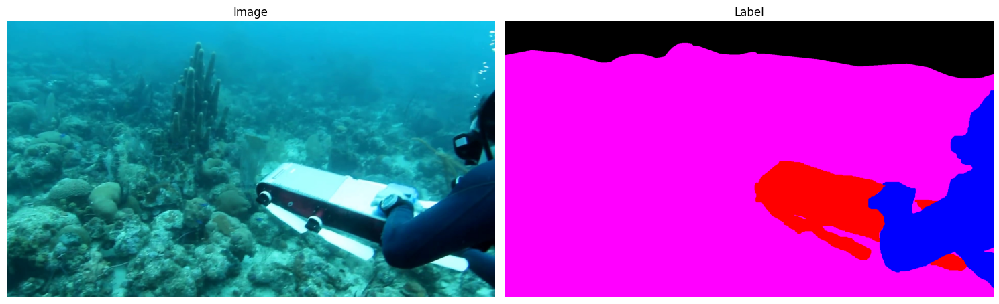

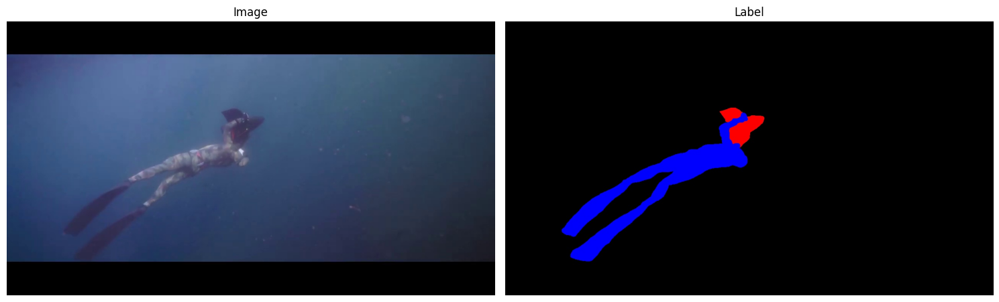

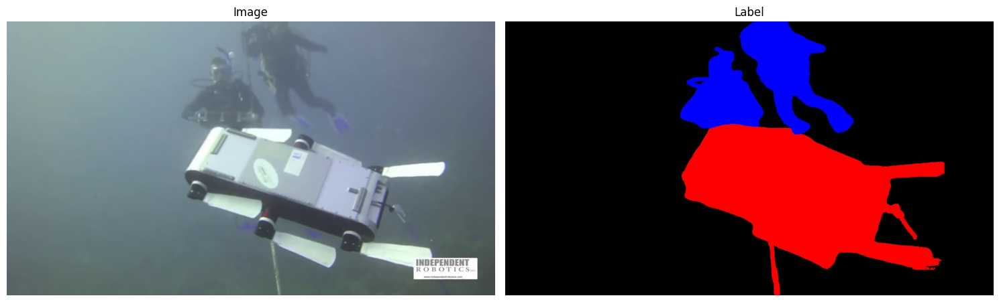

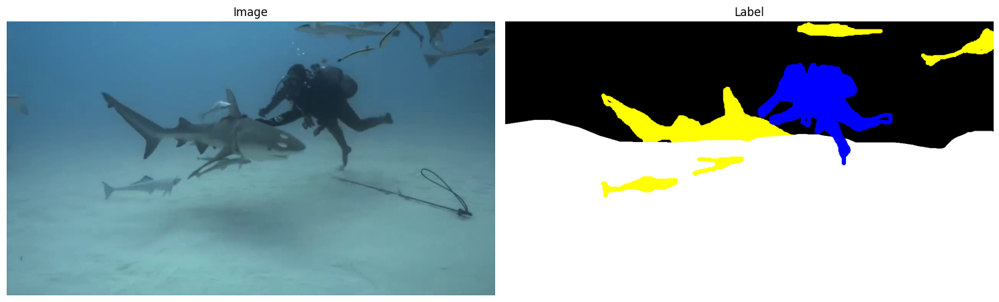

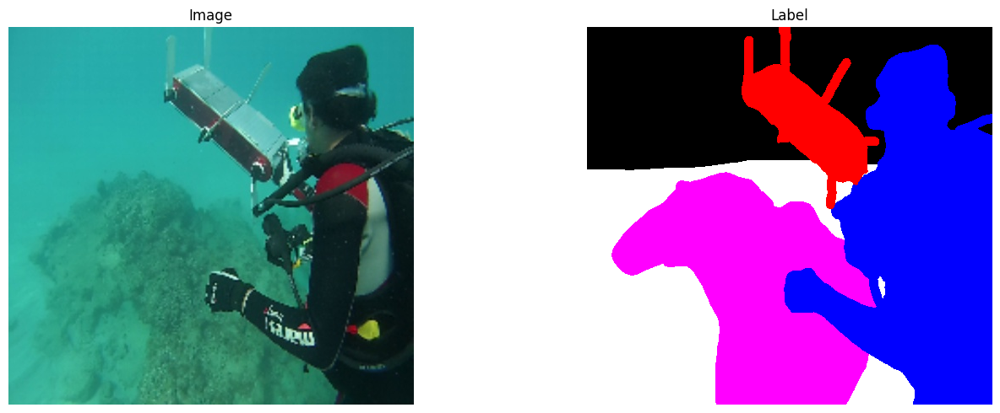

...

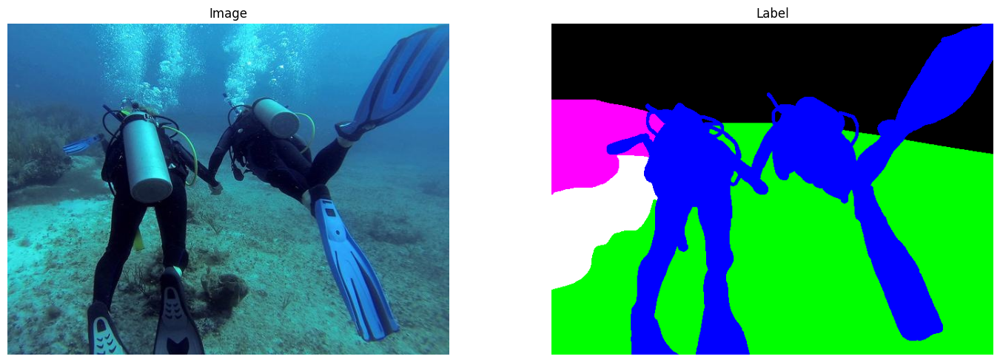

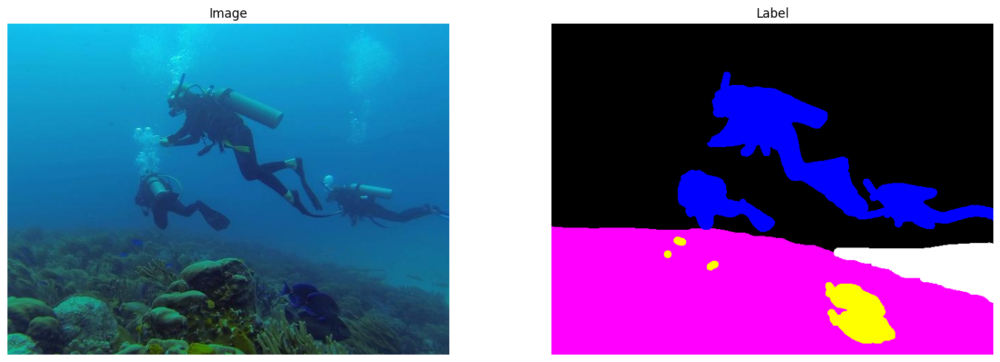

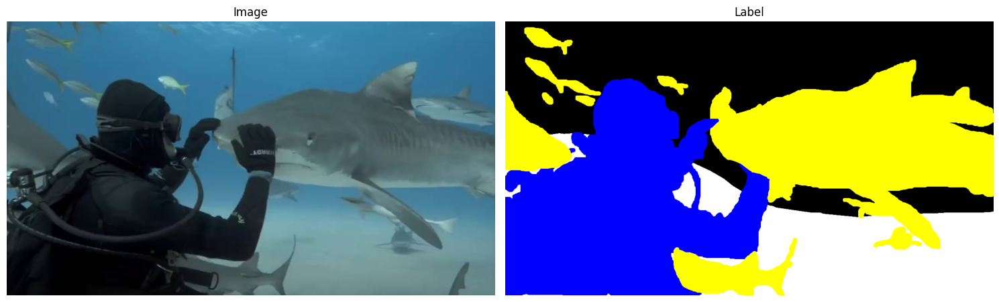

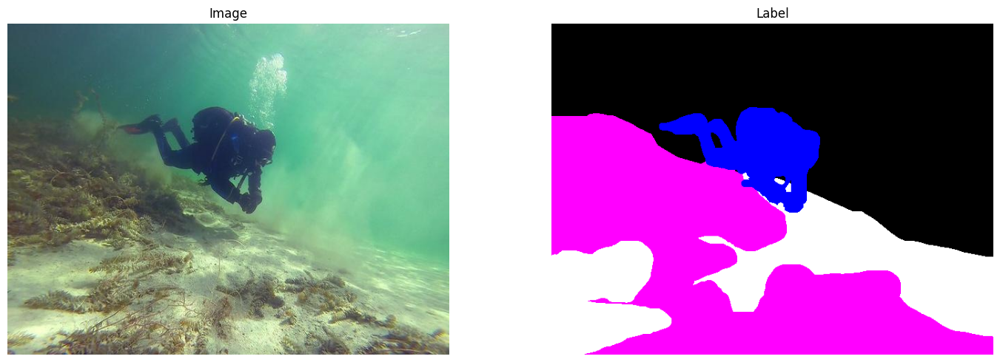

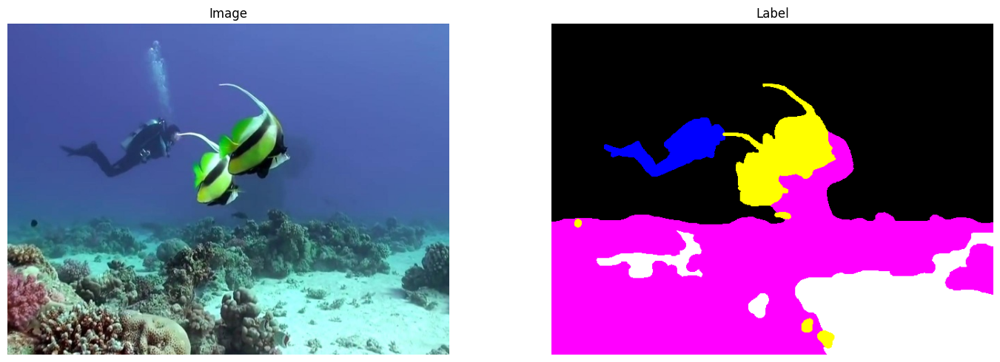

Bild mit falschem Label:


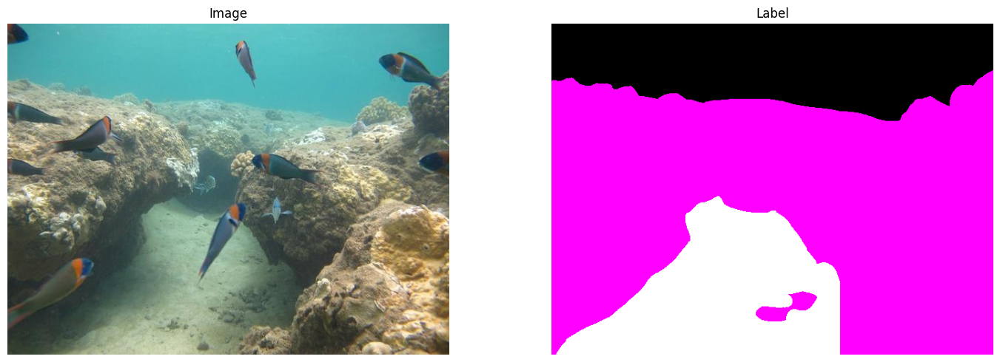

In [ ]:
plot_image_label(dir__running, "train-validation", "d_r_3_")
plot_image_label(dir__running, "train-validation", "d_r_5_")
plot_image_label(dir__running, "train-validation", "d_r_20_")
plot_image_label(dir__running, "train-validation", "d_r_22_")
plot_image_label(dir__running, "train-validation", "d_r_23_")
plot_image_label(dir__running, "train-validation", "d_r_65_")
plot_image_label(dir__running, "train-validation", "d_r_78_")
plot_image_label(dir__running, "train-validation", "d_r_87_")
plot_image_label(dir__running, "train-validation", "d_r_148_")
plot_image_label(dir__running, "train-validation", "d_r_258_")

plot_image_label(dir__running, "test", "d_r_58_")
plot_image_label(dir__running, "test", "d_r_182_")

print("Bild mit falschem Label:")
plot_image_label(dir__running, "test", "f_r_478_")

#### Categories

Die gelabelten Bilder beinhlaten insgesamt 8 Kategorien:

| Color                                 | Description               | Class |
| ------------------------------------- | ------------------------- | ----- |
| <span style="color:#000000;">⬤</span> | Background waterbody      | 0    |
| <span style="color:#0000FF;">⬤</span> | Human divers              | 1    |
| <span style="color:#00FF00;">⬤</span> | Plants/sea-grass          | 2    |
| <span style="color:#00FFFF;">⬤</span> | Wrecks/ruins              | 3    |
| <span style="color:#FF0000;">⬤</span> | Robots/instruments        | 4    |
| <span style="color:#FF00FF;">⬤</span> | Reefs and invertebrates   | 5    |
| <span style="color:#FFFF00;">⬤</span> | Fish and vertebrates      | 6    |
| <span style="color:#FFFFFF;">⬤</span> | Sand/sea-floor (& rocks)  | 7    |

Im in der Aufgabenstellung referenzierten Paper wird die Anzahl Kategorien zur Zusammenlegen einzelner Kategorien auf 6 reduziert. Damit die Werte des Papers mit denjenigen in diesem Notebook verglichen werden können, wird hier dieselbe Reduktion der Kategorien vorgenommen, sodass noch folgende Kategorien verbleiben:

| Color                                 | Description               | Class |
| ------------------------------------- | ------------------------- | ----- |
| <span style="color:#000000;">⬤</span> | Background waterbody      | 0    |
| <span style="color:#000000;">⬤</span> | Plants/sea-grass          | 0    |
| <span style="color:#000000;">⬤</span> | Sand/sea-floor (& rocks)  | 0    |
| <span style="color:#0000FF;">⬤</span> | Human divers              | 1    |
| <span style="color:#00FFFF;">⬤</span> | Wrecks/ruins              | 2    |
| <span style="color:#FF0000;">⬤</span> | Robots/instruments        | 3    |
| <span style="color:#FF00FF;">⬤</span> | Reefs and invertebrates   | 4    |
| <span style="color:#FFFF00;">⬤</span> | Fish and vertebrates      | 5    |

#### Pixel Value Distribution

Nachfolgend wird analysiert, welche Pixelwerte wie oft im Train-, Validation- und Test-Set vorkommen

In [ ]:
def analyze_category_distribution(label_paths, dataset_name, storage_filename):
    """
    Analyzes the category distribution of the labels.
    If the storage file already exists, it will be loaded. Otherwise, it will be created.

    Args:
        label_paths (list): The list of label paths.
        dataset_name (str): The dataset name.
        storage_filename (str): The storage filename.

    Returns:
        pd.DataFrame: The image color distribution (how many images contain a certain color).
        pd.DataFrame: The pixel color distribution (how many pixels in the dataset have a certain color).
        pd.DataFrame: The image category distribution (how many images contain a certain category).
        pd.DataFrame: The pixel category distribution (how many pixels in the dataset have a certain category).
    """

    output_path = os.path.join(dir__running, "executions", "data-analysis", storage_filename)

    if not os.path.isfile(output_path):
      image_color_distribution = Counter()
      pixel_color_distribution = Counter()

      image_category_distribution = Counter()
      pixel_category_distribution = Counter()

      for label_path in tqdm(label_paths):
          label = Image.open(label_path).convert("RGB")
          label_array = np.array(label)
          label_hex_array = np.apply_along_axis(lambda rgb: rgb_to_hex(rgb), 2, label_array)

          unique_colors, color_counts = np.unique(label_hex_array, return_counts = True)
          image_color_distribution.update(unique_colors)
          pixel_color_distribution.update(dict(zip(unique_colors, color_counts)))

          label_categorical = np.zeros((label.height, label.width), dtype = np.uint8)
          label_array = np.where(label_array < 128, 0, 255)

          for color, cat in colors_to_5cats.items():
              color_array = np.array(color)
              mask = np.all(np.abs(label_array - color_array) <= 10, axis=-1)
              label_categorical[mask] = cat

          unique_categories, category_counts = np.unique(label_categorical, return_counts = True)
          image_category_distribution.update(unique_categories)
          pixel_category_distribution.update(dict(zip(unique_categories, category_counts)))

      image_color_series = pd.Series(image_color_distribution)
      pixel_color_series = pd.Series(pixel_color_distribution)
      image_category_series = pd.Series(image_category_distribution)
      pixel_category_series = pd.Series(pixel_category_distribution)

      combined_df = pd.concat([
        pd.DataFrame({
            'Dataset': dataset_name,
            'Distribution Type': 'Image Color',
            'Category/Color': image_color_series.index,
            'Count': image_color_series.values
        }),
        pd.DataFrame({
            'Dataset': dataset_name,
            'Distribution Type': 'Pixel Color',
            'Category/Color': pixel_color_series.index,
            'Count': pixel_color_series.values
        }),
        pd.DataFrame({
            'Dataset': dataset_name,
            'Distribution Type': 'Image Category',
            'Category/Color': image_category_series.index,
            'Count': image_category_series.values
        }),
        pd.DataFrame({
            'Dataset': dataset_name,
            'Distribution Type': 'Pixel Category',
            'Category/Color': pixel_category_series.index,
            'Count': pixel_category_series.values
        }),
      ], ignore_index=True)

      output_path = os.path.join(dir__running, "logs", "metrics", storage_filename)
      combined_df.to_csv(output_path, index=False)

    df = pd.read_csv(output_path)
    return df[df['Distribution Type'] == 'Image Color'], df[df['Distribution Type'] == 'Pixel Color'], df[df['Distribution Type'] == 'Image Category'], df[df['Distribution Type'] == 'Pixel Category']

In [ ]:
train_image_color_dist, train_pixel_color_dist, train_image_category_dist, train_pixel_category_dist = analyze_category_distribution([label_path for _, label_path in train_tuples_paths], 'Train', 'label_distribution_train.csv')
val_image_color_dist, val_pixel_color_dist, val_image_category_dist, val_pixel_category_dist = analyze_category_distribution([label_path for _, label_path in validation_tuples_paths], 'Validation', 'label_distribution_val.csv')
test_image_color_dist, test_pixel_color_dist, test_image_category_dist, test_pixel_category_dist = analyze_category_distribution([label_path for _, label_path in test_tuples_paths], 'Test', 'label_distribution_test.csv')

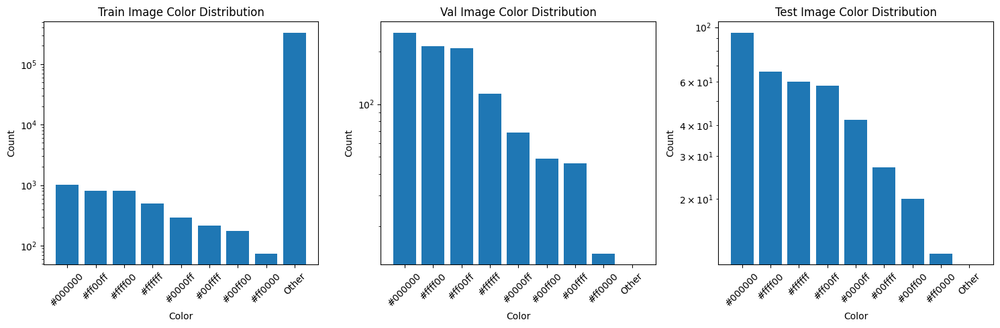

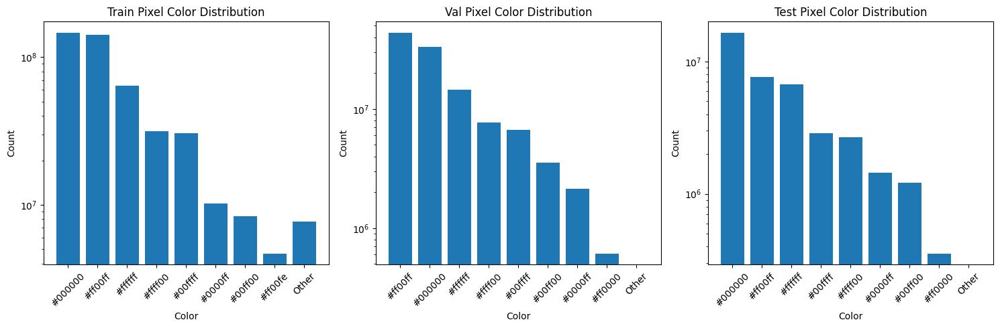

In [ ]:
plot_distribution(train_image_color_dist, val_image_color_dist, test_image_color_dist, "Color", "Count", "Image Color Distribution", max_number_of_classes=8, label_attribute='Category/Color', use_log_scale=True)
plot_distribution(train_pixel_color_dist, val_pixel_color_dist, test_pixel_color_dist, "Color", "Count", "Pixel Color Distribution", max_number_of_classes=8, label_attribute='Category/Color', use_log_scale=True)

Die obige Auswertung zeigt, dass es viele Bilder gibt, welche nebst den definierten RGB-Werten andere Werte beinhalten. Dies kommt nur beim Train-Set vor, beim Validation- und Test-Set nicht. Gemessen an der gesamten Anzahl Pixel ist die Anzahl die Pixel, welche einen solchen nicht standardmässigen Pixelwert haben, gering.

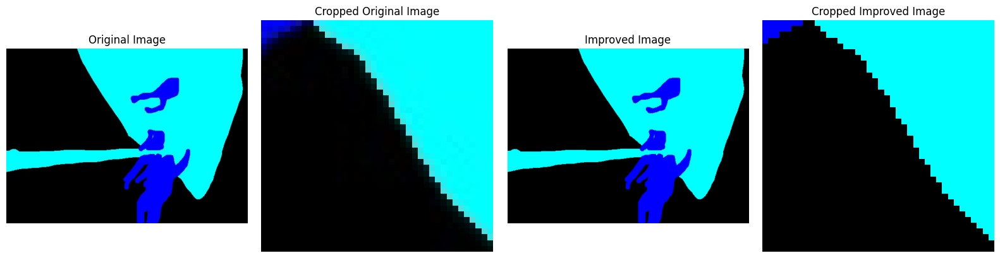

In [ ]:
original_image = Image.open(os.path.join(dir__running, "data", "dataset", "train-validation", "masks", "w_r_1_.bmp"))
crop_box = (410, 315, 450, 355)
cropped_original_image = original_image.crop(crop_box)
improved_image = np.where(np.array(original_image.convert("RGB")) < 128, 0, 255)
improved_image_cropped = Image.fromarray(improved_image.astype(np.uint8)).crop(crop_box)
plot_four_images(original_image, "Original Image", cropped_original_image, "Cropped Original Image", improved_image, "Improved Image", improved_image_cropped, "Cropped Improved Image")

Die Ursache für die Farbwerte, welche nicht einer fixen Kategorie entsprechen, sind Farbübergänge und etwas Noise im Hintergrund, welche bei einigen Bildern vorhanden sind.

Dies kann korrigiert werden, indem die RGB-Werte entsprechend auf- oder abgerundet werden, was im nachfolgend implementierten Dataset auch gemacht wird.

#### Label Distribution
In einem nächsten Schritt wird analysiert, welche Labels wie oft vorkommen. Dazu wird einerseits gezählt, in wie vielen Bildern eine Kategorie vorkommt, andererseits auch wie viele Pixel einer Kategorie im gesamten Datenset vorhanden sind. Vor der Auswertung wird die im vorherigen Block beschriebene Verbesserung der Labels vorgenommen, so dass nur noch die 6 Klassen vorkommen.

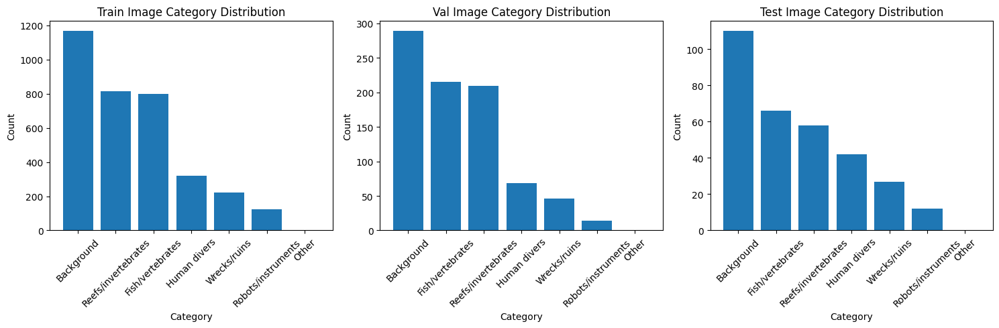

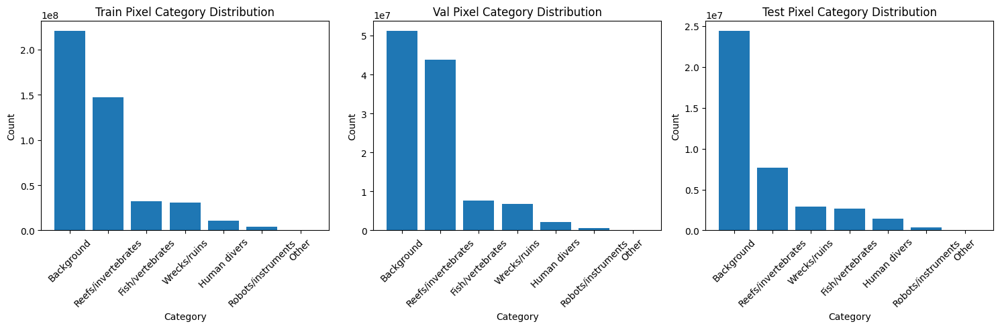

In [ ]:
plot_distribution(train_image_category_dist, val_image_category_dist, test_image_category_dist, "Category", "Count", "Image Category Distribution", max_number_of_classes=8, label_attribute='Category/Color')
plot_distribution(train_pixel_category_dist, val_pixel_category_dist, test_pixel_category_dist, "Category", "Count", "Pixel Category Distribution", max_number_of_classes=8, label_attribute='Category/Color')

Die Verteilung der Klassen zeigt auf, dass die Klassen 1 (Human Divers), 2 (Wrecks / Ruins) und 3 (Robots / Instruments) selten vorkommen. Wird die Verteilung der Pixelwerte betrachtet, ist diese Untervertretung noch stärker ersichtlich.

Diese Verteilung zieht sich in ähnlichem Ausmasse durch alle drei Datasets (Training, Validation, Test). Daraus wird geschlossen, dass im Split der Datensets keine Veränderung notwendig ist.

Die Untervertretung wird jedoch mit grosser Wahrscheinlichkeit die Accuracy-Werte dieser Klassen negativ beeinflussen. Die Untervertretung könnte durch Beschaffung zusätzlicher Daten gemindert werden. Im Rahmen dieses Mini-Projektes wird jedoch darauf verzichtet.

#### Resolution Distribution
In einem nächsten Schritt wird die Verteilung der Auflösungen in den Datasets betrachtet.

In [ ]:
def analyze_image_resolution_distribution(label_paths, dataset_name, storage_filename):
    """
    Analyzes the image resolution distribution.
    If the storage file already exists, it will be loaded. Otherwise, it will be created.

    Args:
        label_paths (list): The list of label paths.
        dataset_name (str): The dataset name.
        storage_filename (str): The storage filename.

    Returns:
        pd.DataFrame: The image resolution distribution.
    """

    output_path = os.path.join(dir__running, "executions", "data-analysis", storage_filename)

    if not os.path.isfile(output_path):
      image_resolution_distribution = Counter()

      for label_path in tqdm(label_paths):
          label = Image.open(label_path).convert("RGB")
          image_resolution_distribution[label.size] += 1

      image_resolution_series = pd.Series(image_resolution_distribution)
      combined_df = pd.DataFrame({
          'Dataset': dataset_name,
          'Distribution Type': 'Image Resolution',
          'Resolution': image_resolution_series.index,
          'Count': image_resolution_series.values
      })
      combined_df.to_csv(output_path, index=False)

    df = pd.read_csv(output_path)
    return df[df['Distribution Type'] == 'Image Resolution']

In [ ]:
train_image_resolutions_dist = analyze_image_resolution_distribution([label_path for _, label_path in train_tuples_paths], 'Train', 'image_resolution_distribution_train.csv')
val_image_resolutions_dist = analyze_image_resolution_distribution([label_path for _, label_path in validation_tuples_paths], 'Validation', 'image_resolution_distribution_val.csv')
test_image_resolutions_dist = analyze_image_resolution_distribution([label_path for _, label_path in test_tuples_paths], 'Test', 'image_resolution_distribution_test.csv')

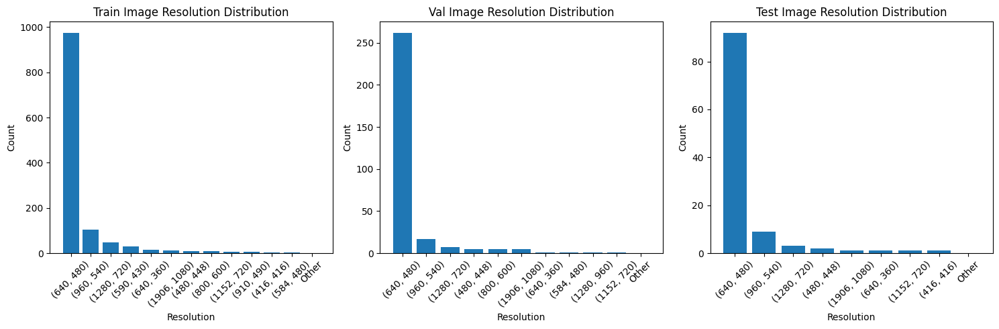

In [ ]:
plot_distribution(train_image_resolutions_dist, val_image_resolutions_dist, test_image_resolutions_dist, "Resolution", "Count", "Image Resolution Distribution", max_number_of_classes=12, label_attribute='Resolution')

Die Verteilung zeigt, dass in allen drei Datensets Bilder mit der Auflösung 640x480 am häufigsten vorkommen. Alle Auflösungen, welche im Test-Set vorkommen, sind auch im Trainings-Set vorhanden.

### Dataset

In [ ]:
_ = torch.manual_seed(123)

In [20]:
class SuimDataset(Dataset):

    def __init__(
        self,
        data_tuples_paths,
        color_mapping: dict,
        transform_images: Callable,
        transform_labels: Callable,
        augmentations: Callable = None,
        verbose: bool = False,
    ):
        """
        Initializes the dataset.

        Args:
            data_tuples_paths (Path): Path to the dataset directory.
            color_mapping (dict): Mapping of RGB colors to class indices.
            transform_images (callable): Transformation function for images.
            transform_labels (callable): Transformation function for labels.
            tolerance (int): Tolerance for color matching.
            augmentations (callable): Augmentation function for images and labels.
            verbose (bool): Whether to display images and labels.
        """
        self.data_tuples_paths              = data_tuples_paths
        self.color_mapping                  = color_mapping
        self.num_classes_with_background    = max(color_mapping.values()) + 1
        self.transform_images               = transform_images
        self.transform_labels               = transform_labels
        self.tolerance                      = 10
        self.augmentations                  = augmentations
        self.verbose                        = verbose

    def __len__(self) -> int:
        """
        Returns the length of the dataset.
        """
        return len(self.data_tuples_paths)

    def __getitem__(self, idx):
        """
        Retrieves the image and corresponding label masks for a given index.

        Args:
            idx (int): The index of the item to retrieve.

        Returns:
            tuple: A tuple containing:
                - image (torch.Tensor | Image.Image): The transformed image or original image.
                - labels_tensor (torch.Tensor): A segmentation map tensor of shape (H, W) indicating class indices for each pixel.
        """
        image_path, label_path = self.data_tuples_paths[idx]

        image = Image.open(image_path).convert("RGB")
        label = Image.open(label_path).convert("RGB")

        if self.augmentations:
            augmented = self.augmentations(image = np.array(image), mask = np.array(label))
            image = Image.fromarray(augmented["image"])
            label = Image.fromarray(augmented["mask"])

        image_tensor = self.transform_images(image)
        label = self.transform_labels(label)

        label_categorical = np.zeros((label.height, label.width), dtype = np.uint8)
        label_array = np.array(label)
        label_array = np.where(label_array < 128, 0, 255)

        for color, cat in self.color_mapping.items():
            color_array = np.array(color)
            mask = np.all(np.abs(label_array - color_array) <= self.tolerance, axis=-1)
            label_categorical[mask] = cat

        labels_tensor = torch.from_numpy(label_categorical).long()

        if self.verbose:
            print(f"Image shape: {image_tensor.shape}, type: {type(image_tensor)}, dtype: {image_tensor.dtype}")
            print(f"Label shape: {label.size}, type: {type(label)}")
            print(f"Labels tensor shape: {labels_tensor.shape}, type: {type(labels_tensor)}, dtype: {labels_tensor.dtype}, min: {labels_tensor.min()}, max: {labels_tensor.max()}")
            plot_image_label_labelcategorical(image_path, image, label, label_categorical)

        return image_tensor, labels_tensor

#### Validation

Image shape: torch.Size([3, 256, 320]), type: <class 'torch.Tensor'>, dtype: torch.float32
Label shape: (320, 256), type: <class 'PIL.Image.Image'>
Labels tensor shape: torch.Size([256, 320]), type: <class 'torch.Tensor'>, dtype: torch.int64, min: 0, max: 2


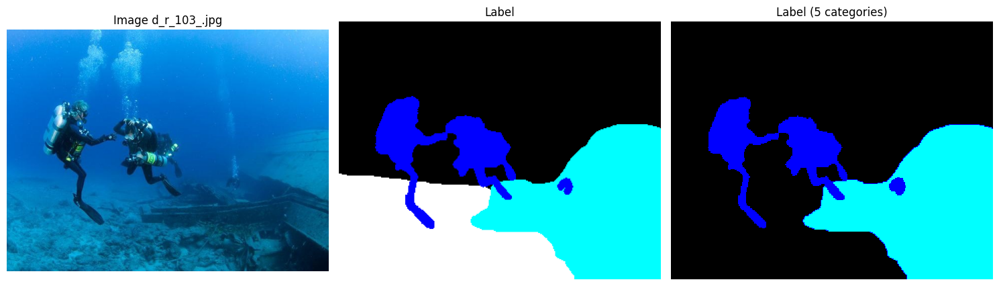

Image shape: torch.Size([3, 256, 320]), type: <class 'torch.Tensor'>, dtype: torch.float32
Label shape: (320, 256), type: <class 'PIL.Image.Image'>
Labels tensor shape: torch.Size([256, 320]), type: <class 'torch.Tensor'>, dtype: torch.int64, min: 0, max: 5


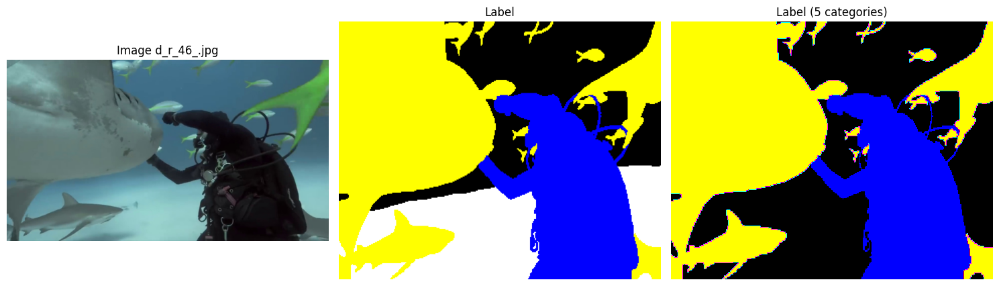

Image shape: torch.Size([3, 256, 320]), type: <class 'torch.Tensor'>, dtype: torch.float32
Label shape: (320, 256), type: <class 'PIL.Image.Image'>
Labels tensor shape: torch.Size([256, 320]), type: <class 'torch.Tensor'>, dtype: torch.int64, min: 0, max: 3


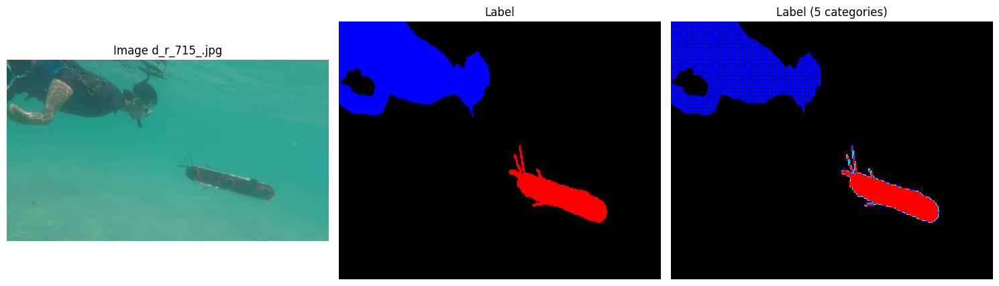

Image shape: torch.Size([3, 256, 320]), type: <class 'torch.Tensor'>, dtype: torch.float32
Label shape: (320, 256), type: <class 'PIL.Image.Image'>
Labels tensor shape: torch.Size([256, 320]), type: <class 'torch.Tensor'>, dtype: torch.int64, min: 0, max: 4


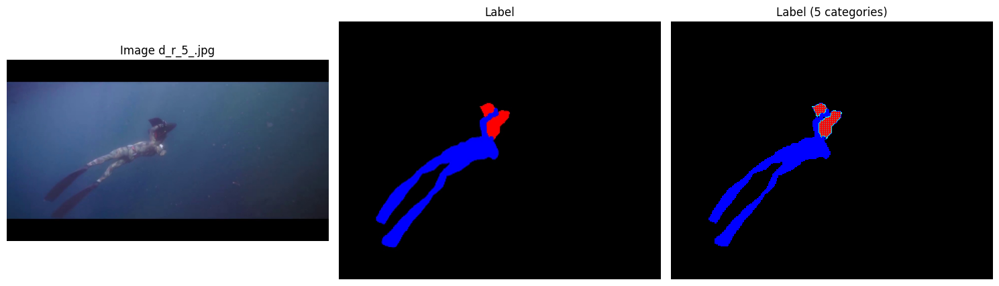

Image shape: torch.Size([3, 256, 320]), type: <class 'torch.Tensor'>, dtype: torch.float32
Label shape: (320, 256), type: <class 'PIL.Image.Image'>
Labels tensor shape: torch.Size([256, 320]), type: <class 'torch.Tensor'>, dtype: torch.int64, min: 0, max: 4


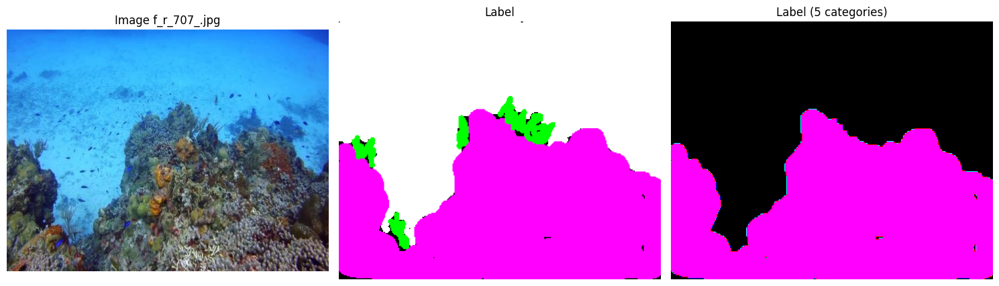

Image shape: torch.Size([3, 256, 320]), type: <class 'torch.Tensor'>, dtype: torch.float32
Label shape: (320, 256), type: <class 'PIL.Image.Image'>
Labels tensor shape: torch.Size([256, 320]), type: <class 'torch.Tensor'>, dtype: torch.int64, min: 0, max: 5


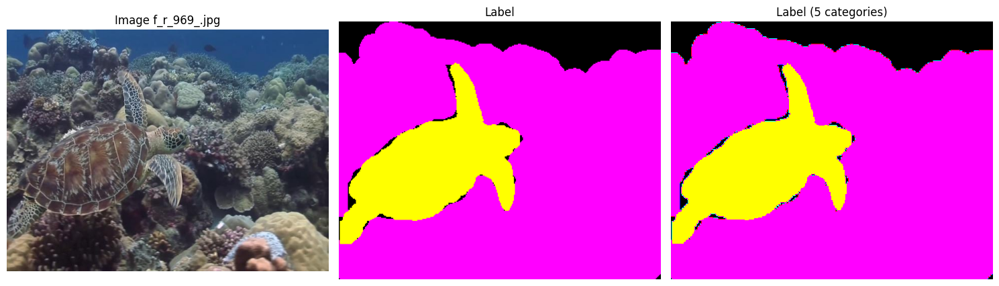

Image shape: torch.Size([3, 256, 320]), type: <class 'torch.Tensor'>, dtype: torch.float32
Label shape: (320, 256), type: <class 'PIL.Image.Image'>
Labels tensor shape: torch.Size([256, 320]), type: <class 'torch.Tensor'>, dtype: torch.int64, min: 0, max: 5


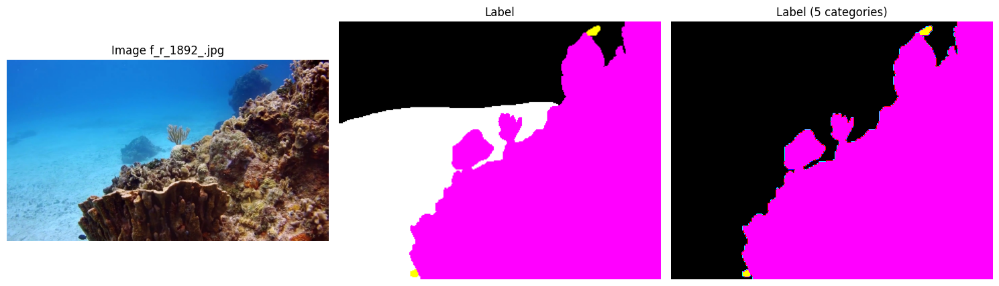

In [ ]:
augmentations = A.Compose([
    # Random rotation
    A.ShiftScaleRotate(
        rotate_limit    =0.2 * 360,   # Rotate range ±20% of 360 degrees
        shift_limit     =0.05,        # Both width and height shift range
        scale_limit     =0.05,        # Zoom range
    ),
    # Random shearing
    A.Affine(
        shear={"x": 0.05, "y": 0.05},  # Apply shear transformations
    ),
    # Horizontal flip
    A.HorizontalFlip(p=0.5)
])

transform_images = transforms.Compose([
    transforms.Resize((256, 320)),
    transforms.ToTensor(), # Converts the image to a tensor with values between 0 and 1
])
transform_labels = transforms.Compose([
    transforms.Resize((256, 320), interpolation = Image.NEAREST),
])

dataset = SuimDataset(
    [(
        os.path.join(dir__dataset_trainvalidation_images, "d_r_103_.jpg"),
        os.path.join(dir__dataset_trainvalidation_labels, "d_r_103_.bmp"),
    )],
    color_mapping       = colors_to_5cats,
    transform_images    = transform_images,
    transform_labels    = transform_labels,
    verbose             = True,
)
assert len(dataset) == 1
image, labels_tensor = dataset[0]

assert image.shape == (3, 256, 320)
assert image.min() >= 0
assert image.max() <= 1

# image contains 3 classes (0, 1, 2)
assert labels_tensor.shape == (256, 320)
assert labels_tensor.min() == 0
assert labels_tensor.max() == 2

trainvalidation_image_names = [
    "d_r_46_",
    "d_r_715_",
    "d_r_5_",
    "f_r_707_",
    "f_r_969_",
]

test_image_names = [
    "f_r_1892_",
]

for image_name in trainvalidation_image_names:
    dataset = SuimDataset(
        [(
            os.path.join(dir__dataset_trainvalidation_images, f"{image_name}.jpg"),
            os.path.join(dir__dataset_trainvalidation_labels, f"{image_name}.bmp"),
        )],
        color_mapping       = colors_to_5cats,
        transform_images    = transform_images,
        transform_labels    = transform_labels,
        verbose             = True,
    )
    image, labels_tensor = dataset[0]

for image_name in test_image_names:
    dataset = SuimDataset(
        [(
            os.path.join(dir__dataset_test_images, f"{image_name}.jpg"),
            os.path.join(dir__dataset_test_labels, f"{image_name}.bmp"),
        )],
        color_mapping       = colors_to_5cats,
        transform_images    = transform_images,
        transform_labels    = transform_labels,
        verbose             = True,
    )
    image, labels_tensor = dataset[0]


## Models

### Model Testing

In [9]:
def test_model(model_6_classes, model_8_classes):
    """
    Validates the model output shape for the given input tensor.
    """

    input_tensor = torch.randn(8, 3, 320, 256)  # Batch size 8, RGB, 320x256
    output = model_6_classes(input_tensor)
    assert output.shape == (8, 6, 320, 256)

    input_tensor = torch.randn(1, 3, 320, 256)  # Batch size 1, RGB, 320x256
    output = model_8_classes(input_tensor)
    assert output.shape == (1, 8, 320, 256)

    print("Validation successful")

### Evaluation Pipeline

Die Evaluation Pipeline beinhaltet Methoden & Konfigurationen für Training & Evaluierung des Models.

Die Accurracy des Models wird mit zwei Metriken berechnet:
- F1-Score
    $$F_1 = {2 * P * R \over P + R}.$$
    wobei:
    $$
    P = {\text{True Positives} \over \text{True Positives} + \text{False Positives}}, \quad
    R = {\text{True Positives} \over \text{True Positives} + \text{False Negatives}}
    $$

- Jaccard-Index / Intersection of Units
    $$
    \text{IoU} = {\lvert A \cap B \rvert \over \lvert A \cup B \rvert}
   $$
   wobei:
   $$
   \text{A} = \text{Vorhergesagte positive Elemente}, \quad
   \text{B} = \text{Tatsächlich positive Elemente}
   $$
   
Der Loss des Models wird als Durchschnitt des Cross Entropy Loss der einzelnen Klassen berechnet.

In [10]:
class UnderwaterSegmentation(pl.LightningModule):
    """
    PyTorch Lightning module for underwater image segmentation.

    Args:
        model (nn.Module): The segmentation model.
        num_classes (int): Number of classes in the dataset.
        lr (float): Learning rate for the optimizer.
    """

    def __init__(self, model, num_classes, lr = 1e-3):
        """
        Initializes the Lightning module.

        Args:
            model (nn.Module): The segmentation model.
            num_classes (int): Number of classes in the dataset.
            lr (float): Learning rate for the optimizer.
        """
        super().__init__()
        self.model = model
        self.lr = lr
        self.criterion = nn.CrossEntropyLoss()

        self.train_accuracy_f1score     = torchmetrics.F1Score(task = "multiclass", num_classes = num_classes, average="none")
        self.train_accuracy_mIoU        = torchmetrics.JaccardIndex(task = "multiclass", num_classes = num_classes, average="none")
        self.train_loss                 = torchmetrics.MeanMetric()

        self.val_accuracy_f1score       = torchmetrics.F1Score(task = "multiclass", num_classes = num_classes, average="none")
        self.val_accuracy_mIoU          = torchmetrics.JaccardIndex(task = "multiclass", num_classes = num_classes, average="none")
        self.val_loss                   = torchmetrics.MeanMetric()

        self.test_accuracy_f1score      = torchmetrics.F1Score(task = "multiclass", num_classes = num_classes, average="none")
        self.test_accuracy_mIoU         = torchmetrics.JaccardIndex(task = "multiclass", num_classes = num_classes, average="none")
        self.test_loss                  = torchmetrics.MeanMetric()

    def forward(self, x):
        """
        Forward pass of the model.

        Args:
            x (torch.Tensor): Input tensor.
        """
        return self.model(x)

    def configure_optimizers(self):
        """
        Configures the optimizer for training.

        Returns:
            torch.optim.Optimizer: The optimizer.
        """
        return torch.optim.Adam(self.model.parameters(), lr = self.lr)

    def training_step(self, batch, _):
        """
        Training step for the Lightning module.

        Args:
            batch (tuple): Input batch.
            _ (int): Batch index.
        """
        images, labels = batch

        logits  = self(images)
        loss    = self.criterion(logits, labels)
        probs   = F.softmax(logits, dim = 1)
        preds   = torch.argmax(probs, dim = 1)

        self.train_loss(loss)
        self.log("train/loss", self.train_loss, prog_bar = True, on_step = True)

        for cls, (iou, f1) in enumerate(zip(self.train_accuracy_f1score(preds, labels), self.train_accuracy_mIoU(preds, labels))):
            self.log(f"train/iou_class_{cls}", iou, prog_bar = True, on_step = True)
            self.log(f"train/f1_class_{cls}", f1, prog_bar = True, on_step = True)

        return loss

    def on_train_epoch_end(self):
        """
        Resets the metrics at the end of the training epoch.
        """
        self.train_accuracy_f1score.reset()
        self.train_accuracy_mIoU.reset()

    def validation_step(self, batch, _):
        """
        Validation step for the Lightning module.

        Args:
            batch (tuple): Input batch.
            _ (int): Batch index.
        """
        images, labels = batch

        logits  = self(images)
        loss    = self.criterion(logits, labels)
        probs   = F.softmax(logits, dim = 1)
        preds   = torch.argmax(probs, dim = 1)

        self.val_loss(loss)
        self.log("val/loss", self.val_loss, prog_bar = True, on_step = True)

        for cls, (iou, f1) in enumerate(zip(self.val_accuracy_f1score(preds, labels), self.val_accuracy_mIoU(preds, labels))):
            self.log(f"val/iou_class_{cls}", iou, prog_bar = True, on_step = True)
            self.log(f"val/f1_class_{cls}", f1, prog_bar = True, on_step = True)

        return loss

    def on_validation_epoch_end(self):
        """
        Resets the metrics at the end of the validation epoch.
        """
        self.val_accuracy_f1score.reset()
        self.val_accuracy_mIoU.reset()

    def test_step(self, batch, _):
        """
        Test step for the Lightning module.

        Args:
            batch (tuple): Input batch.
            _ (int): Batch index.
        """
        images, labels = batch

        logits  = self(images)
        loss    = self.criterion(logits, labels)
        probs   = F.softmax(logits, dim = 1)
        preds   = torch.argmax(probs, dim = 1)

        self.test_loss(loss)
        self.log("test/loss", self.test_loss, prog_bar = True, on_step = True)

        for cls, (iou, f1) in enumerate(zip(self.test_accuracy_f1score(preds, labels), self.test_accuracy_mIoU(preds, labels))):
            self.log(f"test/iou_class_{cls}", iou, on_step = True)
            self.log(f"test/f1_class_{cls}", f1, on_step = True)

        plot_image_label_prediction(images[0].cpu().permute(1, 2, 0), labels[0].cpu().squeeze(0), preds[0].cpu().numpy())

        return loss

In [11]:
def train_model(model, train_dataloader, validation_dataloader, test_dataloader, model_name, lr, max_epochs = 50):
    """
    Trains the model on the given data.

    Args:
        model (nn.Module): The model to train.
        train_dataloader (DataLoader): The training data.
        validation_dataloader (DataLoader): The validation data.
        test_dataloader (DataLoader): The test data.
        model_name (str): The name of the model.
        lr (float): The learning rate.
        max_epochs (int): The maximum number of epochs to train.

    Returns:
        str: The path to the model checkpoint.
    """

    if not RUN_TRAINING:
        return None

    timestamp = pd.Timestamp.now().strftime("%Y%m%d_%H%M%S")
    dir__executions_model = os.path.join(dir__executions, model_name)
    dir__executions_checkpoint = os.path.join(dir__executions_model, timestamp)
    ensure_dir(dir__executions_checkpoint)

    with open(os.path.join(dir__executions_checkpoint, "run_info.txt"), "w") as f:
        f.write(f"lr: {lr}\n")
        f.write(f"batch_size: {train_dataloader.batch_size}\n")
        f.write(f"max_epochs: {max_epochs}\n")

    print(torchinfo.summary(model, input_size=(1, 3, 256, 320)))

    segmentation = UnderwaterSegmentation(model = model, num_classes = 6, lr = lr)

    checkpoint_callback = ModelCheckpoint(
        dirpath             = dir__executions_checkpoint,
        mode                = "min",
        monitor             = "val/loss",
        save_weights_only   = True,
        save_top_k          = 1,
        filename            = model_name,
        verbose             = True
    )

    trainer = pl.Trainer(
        max_epochs          = max_epochs,
        callbacks           = [checkpoint_callback],
        accelerator         = "gpu",
        devices             = 1 if torch.cuda.is_available() else None,
        log_every_n_steps   = 10,
        logger              = pl.loggers.CSVLogger(dir__executions_model, name = None, version = timestamp),
    )

    _ = trainer.fit(segmentation, train_dataloader, validation_dataloader)
    _ = trainer.test(segmentation, test_dataloader)

    return dir__executions_checkpoint

In [12]:
def load_and_test_model(model, test_dataloader, version, model_name):
    """
    Loads a model from a checkpoint and tests it on the given data.

    Args:
        model (nn.Module): The model to test.
        test_dataloader (DataLoader): The test data.
        version (str): The timestamp or configuration of the checkpoint.
        model_name (str): The name of the model.
    """

    dir__executions_model = os.path.join(dir__executions, model_name)
    dir__executions_checkpoint = os.path.join(dir__executions_model, version)
    checkpoint_path = os.path.join(dir__executions_checkpoint, f"{model_name}.ckpt")

    if not os.path.exists(dir__executions_checkpoint):
        raise FileNotFoundError(f"Checkpoint directory '{dir__executions_checkpoint}' does not exist.")

    if not os.path.exists(checkpoint_path):
        raise FileNotFoundError(f"Checkpoint file '{checkpoint_path}' does not exist.")

    trainer = pl.Trainer(
        accelerator="gpu",
        devices=1 if torch.cuda.is_available() else None,
        logger=False)

    segmentation = UnderwaterSegmentation.load_from_checkpoint(checkpoint_path, model=model, num_classes=6, strict=False)

    _ = trainer.test(segmentation, test_dataloader)

In [13]:
def analyze_metrics(folder = None, model_name = None, version = None):
    """
    Analyzes the metrics of a given model. Either the folder or the model name and version must be provided.

    Args:
        folder (str): The folder containing the metrics.
        model_name (str): The name of the model.
        version (str): The timestamp or configuration of the checkpoint.
    """
    if folder is not None:
        path = os.path.join(folder, "metrics.csv")
    elif model_name is not None and version is not None:
        path = os.path.join(dir__executions, model_name, version, "metrics.csv")
    else:
        return

    df = pd.read_csv(path)

    df['train/f1_mean'] = df[[f'train/f1_class_{i}' for i in range(1, 6)]].mean(axis=1)
    df['train/iou_mean'] = df[[f'train/iou_class_{i}' for i in range(1, 6)]].mean(axis=1)
    df['val/f1_mean'] = df[[f'val/f1_class_{i}_epoch' for i in range(1, 6)]].mean(axis=1)
    df['val/iou_mean'] = df[[f'val/iou_class_{i}_epoch' for i in range(1, 6)]].mean(axis=1)

    df_validation = df[df['val/loss_epoch'].notna() & df['val/loss_epoch'].notnull()][['epoch', 'val/loss_epoch', 'val/f1_mean', 'val/iou_mean']]

    df_training_per_step = df[df['train/loss'].notna() & df['train/loss'].notnull()][['epoch', 'train/loss', 'train/f1_mean', 'train/iou_mean']]
    df_training = df_training_per_step.groupby('epoch').mean().reset_index()

    df_test = df[df['epoch'] == df['epoch'].max()]
    df_test = pd.concat([
        df_test[[f'test/f1_class_{i}_epoch' for i in range(1, 6)]].rename(columns={f'test/f1_class_{i}_epoch': i for i in range(1, 6)}),
        df_test[[f'test/iou_class_{i}_epoch' for i in range(1, 6)]].rename(columns={f'test/iou_class_{i}_epoch': i for i in range(1, 6)}),
    ], axis=0)

    fig, ax = plt.subplots(1, 3, figsize=(15, 5))

    if version:
        fig.suptitle(f"Model with {version}")

    _ = ax[0].plot(df_training['epoch'], df_training['train/loss'], label='Train Loss')
    _ = ax[0].plot(df_validation['epoch'], df_validation['val/loss_epoch'], label='Validation Loss')
    ylim = max(df_training['train/loss'].max(), df_validation['val/loss_epoch'].max())
    _ = ax[0].set_ylim(top=min(ylim, 2), bottom=0)
    _ = ax[0].set_xlabel('Epoch')
    _ = ax[0].set_ylabel('Loss')
    _ = ax[0].set_title('Loss (Train and Validation Set)')
    _ = ax[0].legend()
    _ = ax[0].grid(True)

    _ = ax[1].plot(df_validation['epoch'], df_validation['val/f1_mean'], label='Validation F1')
    _ = ax[1].plot(df_validation['epoch'], df_validation['val/iou_mean'], label='Validation IoU')
    _ = ax[1].plot(df_training['epoch'], df_training['train/f1_mean'], label='Train F1')
    _ = ax[1].plot(df_training['epoch'], df_training['train/iou_mean'], label='Train IoU')
    _ = ax[1].set_xlabel('Epoch')
    _ = ax[1].set_ylabel('Loss')
    _ = ax[1].set_title('Accuracy (Train and Validation Set)')
    _ = ax[1].legend()
    _ = ax[1].grid(True)

    _ = ax[2].bar(df_test.columns - 0.2, df_test.values[0], 0.4)
    _ = ax[2].set_xticks(df_test.columns, [
        "Human divers",
        "Wrecks/ruins",
        "Robots/instruments",
        "Reefs/invertebrates",
        "Fish/vertebrates"
    ], rotation=45)
    _ = ax[2].bar(df_test.columns + 0.2, df_test.values[1], 0.4)
    _ = ax[2].set_xlabel('Class')
    _ = ax[2].set_ylabel('Value')
    _ = ax[2].set_title('Accuracy per class (Test Set)')
    _ = ax[2].legend(['F1', 'IoU'])

    fig.tight_layout()
    plt.show()

In [14]:
def evaluate_model(model, test_dataloader, version, model_name):
    """
    Evaluates the model on the test data.

    Args:
        model (nn.Module): The model to evaluate.
        test_dataloader (DataLoader): The test data.
        version (str): The timestamp or configuration of the checkpoint.
        model_name (str): The name of the model.
    """
    analyze_metrics(model_name=model_name, version=version)
    load_and_test_model(model, test_dataloader, version, model_name)

### Baseline

Als Baseline wird das SUIM-Net VGG16 Model implementiert, welches vom Paper als das Model mit den besten Ergebnissen beschrieben wird.

- Transformationen: Bilder und Labels werden alle auf eine Grösse von 256x320 transformiert
- Augmentation: Es wird keine Data Augmentation angewendet
- Modell-Aufbau: Für die vier Encoder-Blöcke werden vortrainierte VGG16 Blöcke verwendet. Danach folgen vier Decoder-Blöcke und ein Convolution Layer. Zwischen den Encoder und Decoder Blöcken gibt es Skip-Connections

![](img/baseline_model.drawio.png "SUIMNet VGG 16 Architektur")

In [ ]:
batch_size = 32
transform_images = transforms.Compose([
    transforms.Resize((256, 320)),
    transforms.ToTensor(), # Converts the image to a tensor with values between 0 and 1
])
transform_labels = transforms.Compose([
    transforms.Resize((256, 320)),
])

baseline_train_dataset = SuimDataset(
    data_tuples_paths   = train_tuples_paths,
    color_mapping       = colors_to_5cats,
    transform_images    = transform_images,
    transform_labels    = transform_labels)
baseline_train_dataloader = DataLoader(baseline_train_dataset, batch_size = batch_size, shuffle = True)

baseline_validation_dataset = SuimDataset(
    data_tuples_paths   = validation_tuples_paths,
    color_mapping       = colors_to_5cats,
    transform_images    = transform_images,
    transform_labels    = transform_labels)
baseline_validation_dataloader = DataLoader(baseline_validation_dataset, batch_size = batch_size, shuffle = False)

baseline_test_dataset = SuimDataset(
    data_tuples_paths   = test_tuples_paths,
    color_mapping       = colors_to_5cats,
    transform_images    = transform_images,
    transform_labels    = transform_labels)
baseline_test_dataloader = DataLoader(baseline_test_dataset, batch_size = batch_size, shuffle = False)

In [ ]:
class UpSampleBlock(nn.Module):
    """
    Upsampling block for the SUIMNet model.

    Args:
        in_channels (int): Number of input channels.
        out_channels (int): Number of output channels.
    """

    def __init__(self, in_channels, out_channels):
        """
        Initializes the upsampling block.

        Args:
            in_channels (int): Number of input channels.
            out_channels (int): Number of output channels.
        """
        super(UpSampleBlock, self).__init__()
        self.upsample   = nn.Upsample(scale_factor = 2, mode = 'bilinear', align_corners = False)
        self.conv       = nn.Conv2d(in_channels, out_channels, kernel_size = 3, padding = 1, stride = 1)
        self.relu       = nn.ReLU(inplace = True)
        self.bn         = nn.BatchNorm2d(out_channels, momentum = 0.8)

    def forward(self, x, skip):
        """
        Forward pass of the upsampling block.

        Args:
            x (torch.Tensor): Input tensor.
            skip (torch.Tensor): Skip connection tensor.

        Returns:
            torch.Tensor: The output tensor.
        """
        x = self.upsample(x)
        x = self.conv(x)
        x = self.relu(x)
        x = self.bn(x)
        x = torch.cat([x, skip], dim = 1)
        return x


class SUIMNetVGG16(nn.Module):
    """
    SUIMNet model based on VGG16.

    Args:
        num_classes (int): Number of classes in the dataset.
    """
    def __init__(self, num_classes = 8):
        """
        Initializes the model.

        Args:
            num_classes (int): Number of classes in the dataset.
        """
        super(SUIMNetVGG16, self).__init__()
        vgg                 = vgg16(weights = VGG16_Weights.IMAGENET1K_V1)
        self.encoder1       = nn.Sequential(*vgg.features[:5])     # Block 1
        self.encoder2       = nn.Sequential(*vgg.features[5:10])   # Block 2
        self.encoder3       = nn.Sequential(*vgg.features[10:17])  # Block 3
        self.encoder4       = nn.Sequential(*vgg.features[17:24])  # Block 4

        self.decoder1       = UpSampleBlock(512,       768)
        self.decoder2       = UpSampleBlock(768 + 256, 384)
        self.decoder3       = UpSampleBlock(384 + 128, 192)
        self.final_deconv   = nn.ConvTranspose2d(256, 192, kernel_size = 2, stride = 2)
        self.output         = nn.Conv2d(192, num_classes, kernel_size = 3, padding = 1)

    def forward(self, x):
        """
        Forward pass of the model.

        Args:
            x (torch.Tensor): Input tensor.

        Returns:
            torch.Tensor: The output tensor.
        """
        # Encoder
        e1  = self.encoder1(x)
        e2  = self.encoder2(e1)
        e3  = self.encoder3(e2)
        e4  = self.encoder4(e3)

        # Decoder
        d1  = self.decoder1(e4, e3)
        d2  = self.decoder2(d1, e2)
        d3  = self.decoder3(d2, e1)
        d4  = self.final_deconv(d3)
        out = self.output(d4)
        return out

#### Testing

In [ ]:
test_model(
    model_6_classes = SUIMNetVGG16(num_classes = 6),
    model_8_classes = SUIMNetVGG16(num_classes = 8))

#### Training

In [ ]:
path = train_model(
    model                   = SUIMNetVGG16(num_classes = 6),
    train_dataloader        = baseline_train_dataloader,
    validation_dataloader   = baseline_validation_dataloader,
    test_dataloader         = baseline_test_dataloader,
    model_name              = "SUIMNetVGG16_Baseline",
    lr                      = 1e-3,
    max_epochs              = 20)

analyze_metrics(path)

#### Evaluation

Mit der Baseline wollten wir sicherstellen, dass unsere Pipeline funktioniert. Wir haben diese deshalb lediglich mit einer Konfiguration trainiert:

- Learning Rate: $10^{-3}$
- Batch Size: 32
- Epochs: 20
- Augmentation: keine

Der Loss und die Accuracy Werte des Models zeigen, dass sich das Modell verbessert - dies ist auf den Trainingsdaten sowie auch auf den Validierungsdaten ersichtlich. Allerdings ist die erhaltene Loss-Kurve noch nicht optimal. Die gewählte Learning Rate ist für dieses Modell zu hoch, weshalb es innerhalb der ersten Epochen beim Validation Loss immer wieder zu grossen Sprüngen kommt. Mit weiteren Anpassungen an der Konfiguration werden wir in den nächsten Schritten versuchen, die Loss-Kurve und Accuracy-Werte zu verbessern. Mit diesem Modell haben wir gezeigt, dass die Pipeline funktioniert.

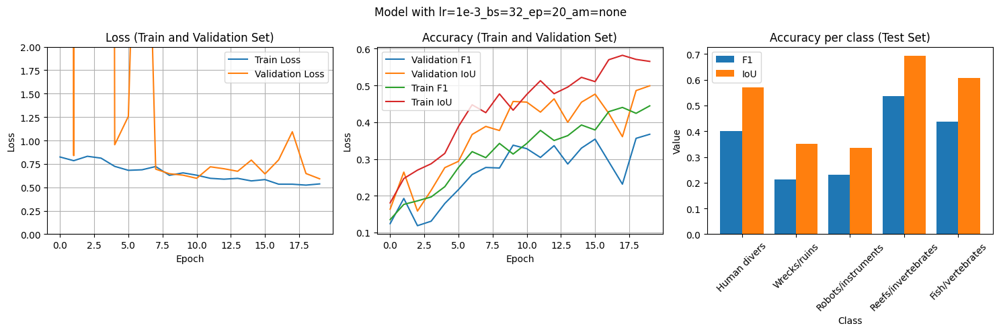

In [ ]:
analyze_metrics(model_name="SUIMNetVGG16_Baseline", version="lr=1e-3_bs=32_ep=20_am=none")

Betrachten wir die Prediction des Models (unten) sowie auch die Accuracy-Werte (oben) auf den Test-Bildern, so ist ersichtlich, dass das Modell noch nicht gute Resultate liefert.

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
c:\Python312\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:425: The 'test_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=7` in the `DataLoader` to improve performance.


Testing: |          | 0/? [00:00<?, ?it/s]

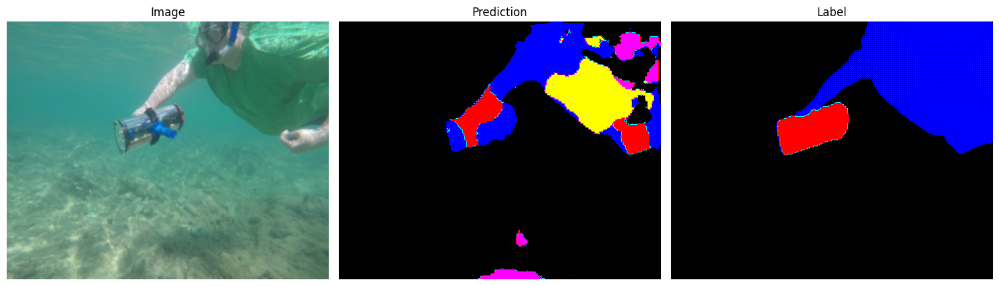

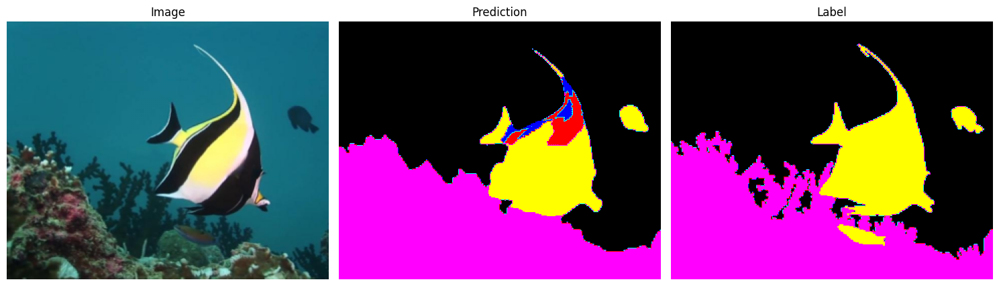

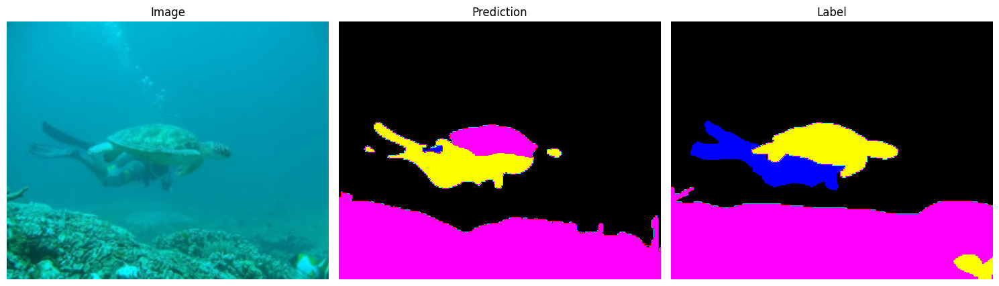

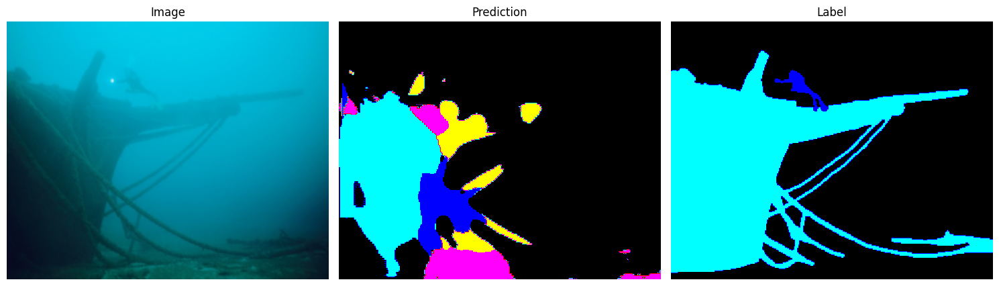

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│   test/f1_class_0_epoch   │    0.8215951919555664     │
│   test/f1_class_1_epoch   │    0.3223857879638672     │
│   test/f1_class_2_epoch   │    0.1118120476603508     │
│   test/f1_class_3_epoch   │    0.12854714691638947    │
│   test/f1_class_4_epoch   │     0.542247474193573     │
│   test/f1_class_5_epoch   │    0.39458611607551575    │
│  test/iou_class_0_epoch   │    0.9016587734222412     │
│  test/iou_class_1_epoch   │    0.46990662813186646    │
│  test/iou_class_2_epoch   │    0.17447184026241302    │
│  test/iou_class_3_epoch   │    0.18958687782287598    │
│  test/iou_class_4_epoch   │    0.6891462802886963     │
│  test/iou_class_5_epoch   │    0.5478570461273193     │
│      test/loss_epoch      │    0.7214394807815552     │
└───────────────────────────┴───────────────────────────┘

In [ ]:
load_and_test_model(SUIMNetVGG16(num_classes = 6), baseline_test_dataloader, "lr=1e-3_bs=32_ep=20_am=none", "SUIMNetVGG16_Baseline")

### Encoder Decoder Network

Das implementierte Encoder Decoder Netzwerk basiert auf den Unterlagen der Vorlesungen.

- Transformationen: Bilder und Labels werden alle auf eine Grösse von 256x320 transformiert
- Augmentation: Es wird keine Data Augmentation angewendet
- Modell-Aufbau: Das Modell besteht aus je vier Encoder- und Decoder-Blöcke. Die Encoder-Blöcke bestehen aus einer Convolution, Batch-Normalization, ReLu-Activation, Convolution und Batch-Normalization. Die Decoder-Blöcke 1 - 3 bestehen aus einer De-Convolution, Batch-Normalization, ReLu-Activation, Convolution und Batch-Normalization. Der vierte Decoder-Block besteht aus einer Convolution, um die Feature-Size auf die Anzahl Klassen zu reduzieren.

![](img/encoder_decoder_model.drawio.png "Encoder-Decoder Architektur")

In [ ]:
class SimpleEncoderBlock(nn.Module):
    """
    Simple encoder block.

    Args:
        in_channels (int): Number of input channels.
        out_channels (int): Number of output channels.
        kernel_size (int): Kernel size.
        padding (int): Padding.
    """

    def __init__(self, in_channels, out_channels, kernel_size = 3, padding = 1):
        """
        Initializes the encoder block.

        Args:
            in_channels (int): Number of input channels.
            out_channels (int): Number of output channels.
            kernel_size (int): Kernel size.
            padding (int): Padding.
        """
        super().__init__()

        self.conv1 = nn.Conv2d(
            in_channels     = in_channels,
            out_channels    = in_channels,
            kernel_size     = kernel_size,
            stride          = 1,
            padding         = padding)

        self.bn1 = nn.BatchNorm2d(num_features = in_channels)

        self.relu = nn.ReLU()

        self.conv2 = nn.Conv2d(
            in_channels     = in_channels,
            out_channels    = out_channels,
            kernel_size     = kernel_size,
            stride          = 2,
            padding         = padding)

        self.bn2 = nn.BatchNorm2d(num_features = out_channels)

    def forward(self, x):
        """
        Forward pass of the encoder block.

        Args:
            x (torch.Tensor): Input tensor.

        Returns:
            torch.Tensor: The output tensor.
        """
        x = self.conv1(x)
        x = self.bn1(x)
        x = self.relu(x)
        x = self.conv2(x)
        x = self.bn2(x)
        x = self.relu(x)
        return x

class SimpleDecoderBlock(nn.Module):
    """
    Simple decoder block.

    Args:
        in_channels (int): Number of input channels.
        out_channels (int): Number of output channels.
        kernel_size (int): Kernel size.
        stride (int): Stride.
        padding (int): Padding.
        output_padding (int): Output padding.
    """

    def __init__(self, in_channels, out_channels, kernel_size = 3, stride = 2, padding = 1,output_padding = 1):
        """
        Initializes the decoder block.

        Args:
            in_channels (int): Number of input channels.
            out_channels (int): Number of output channels.
            kernel_size (int): Kernel size.
            stride (int): Stride.
            padding (int): Padding.
            output_padding (int): Output padding.
        """
        super().__init__()

        self.deconv1 = nn.ConvTranspose2d(
            in_channels     = in_channels,
            out_channels    = out_channels,
            kernel_size     = kernel_size,
            stride          = stride,
            padding         = padding,
            output_padding  = output_padding)

        self.bn1 = nn.BatchNorm2d(num_features = out_channels)

        self.relu = nn.ReLU()

        self.conv2 = nn.Conv2d(
            in_channels     = out_channels,
            out_channels    = out_channels,
            kernel_size     = kernel_size,
            stride          = 1,
            padding         = padding)

        self.bn2 = nn.BatchNorm2d(num_features=out_channels)

    def forward(self, x):
        """
        Forward pass of the decoder block.

        Args:
            x (torch.Tensor): Input tensor.

        Returns:
            torch.Tensor: The output tensor.
        """
        x = self.deconv1(x)
        x = self.bn1(x)
        x = self.relu(x)
        x = self.conv2(x)
        x = self.bn2(x)
        x = self.relu(x)
        return x

class SimpleEncoder(nn.Module):
    """
    Simple encoder.

    Args:
        num_channels_in (int): Number of input channels.
        num_channels (list): List of output channels.
    """

    def __init__(self, num_channels_in, num_channels):
        """
        Initializes the encoder.

        Args:
            num_channels_in (int): Number of input channels.
            num_channels (list): List of output channels.
        """
        super().__init__()

        num_channels = [num_channels_in] + num_channels
        self.layers_ = nn.ModuleList()
        for in_channels, out_channels in zip(num_channels, num_channels[1:]):
            self.layers_.append(SimpleEncoderBlock(in_channels = in_channels, out_channels = out_channels))

    def forward(self, x):
        """
        Forward pass of the encoder.

        Args:
            x (torch.Tensor): Input tensor.

        Returns:
            torch.Tensor: The output tensor.
        """
        for layer in self.layers_:
            x = layer(x)
        return x

class SimpleDecoder(nn.Module):
    """
    Simple decoder.

    Args:
        num_channels_in (int): Number of input channels.
        num_channels (list): List of output channels.
    """

    def __init__(self, num_channels_in, num_channels):
        """
        Initializes the decoder.

        Args:
            num_channels_in (int): Number of input channels.
            num_channels (list): List of output channels.
        """
        super().__init__()

        num_channels = [num_channels_in] + num_channels
        self.layers_ = nn.ModuleList()
        for in_channels, out_channels in zip(num_channels, num_channels[1:]):
            self.layers_.append(SimpleDecoderBlock(in_channels=in_channels, out_channels=out_channels))

    def forward(self, x):
        for layer in self.layers_:
            x = layer(x)
        return x

class SimpleEncoderDecoder(nn.Module):
    """
    Simple encoder-decoder model.

    Args:
        channels (int): Number of input channels.
        num_classes (int): Number of classes in the dataset.
    """

    def __init__(self, channels = 3, num_classes = 8):
        """
        Initializes the encoder-decoder model.

        Args:
            channels (int): Number of input channels.
            num_classes (int): Number of classes in the dataset.
        """
        super().__init__()

        self.input = nn.Conv2d(
            in_channels     = channels,
            out_channels    = 8,
            kernel_size     = 3,
            stride          = 1,
            padding         = 1,
        )
        self.encoder = SimpleEncoder(num_channels_in = 8, num_channels = [16, 32, 64])
        self.decoder = SimpleDecoder(num_channels_in = 64, num_channels = [32, 16, 8])

        self.output = nn.Conv2d(
            in_channels     = 8,
            out_channels    = num_classes,
            kernel_size     = 1,
            stride          = 1,
            padding         = 0,
        )

    def forward(self, x):
        """
        Forward pass of the model.

        Args:
            x (torch.Tensor): Input tensor.

        Returns:
            torch.Tensor: The output tensor.
        """
        x = self.input(x)
        x = self.encoder(x)
        x = self.decoder(x)
        x = self.output(x)
        return x

#### Testing

In [ ]:
test_model(
    model_6_classes = SimpleEncoderDecoder(num_classes = 6),
    model_8_classes = SimpleEncoderDecoder(num_classes = 8))

Validation successful


#### Training

In [ ]:
path = train_model(
    model                   = SimpleEncoderDecoder(num_classes = 6),
    train_dataloader        = baseline_train_dataloader,
    validation_dataloader   = baseline_validation_dataloader,
    test_dataloader         = baseline_test_dataloader,
    model_name              = "SimpleEncoderDecoder",
    lr                      = 1e-3)

analyze_metrics(path)

#### Evaluation

Dieses Model wurde mit folgender Konfiguration trainiert:

- Learning Rate: $10^{-3}$
- Batch Size: 32
- Epochs: 50
- Augmentation: keine

Die eigene Implementation von einem Encoder Decoder Modell funktioniert deutlich schlechter als die Baseline (Version aus dem Paper):

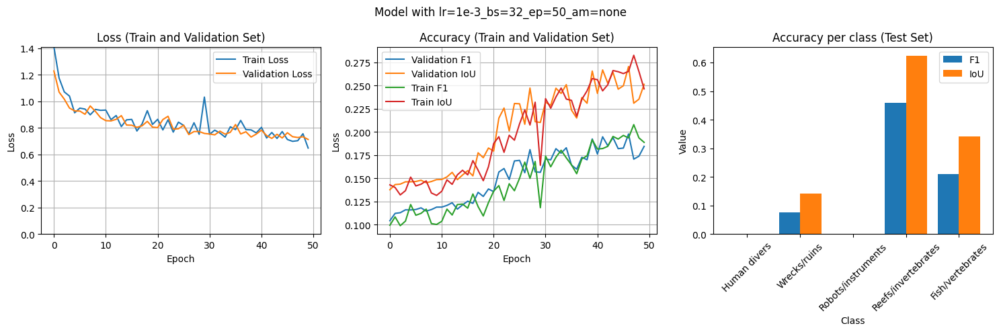

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
c:\Python312\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:425: The 'test_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=7` in the `DataLoader` to improve performance.


Testing: |          | 0/? [00:00<?, ?it/s]

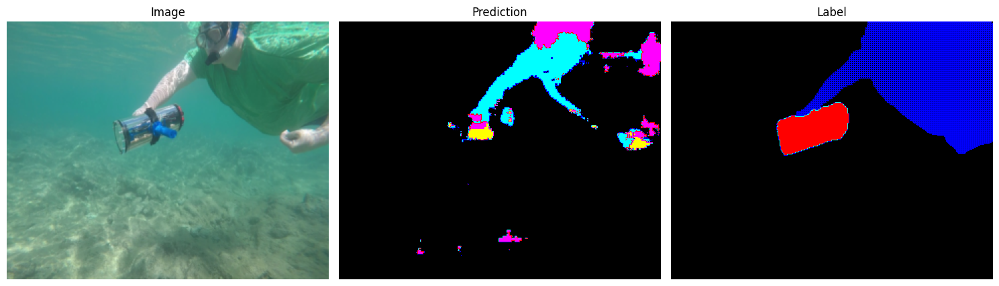

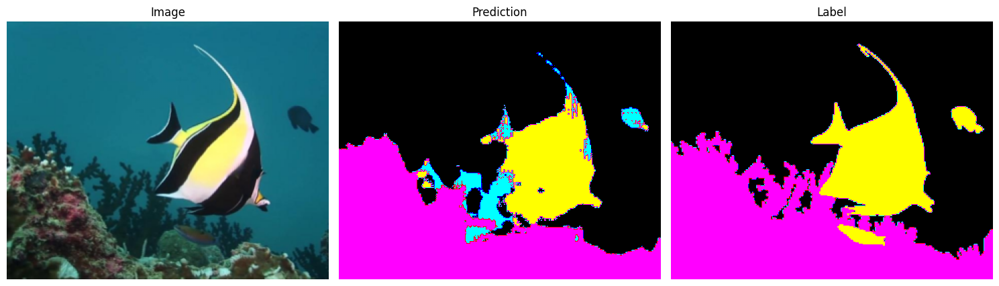

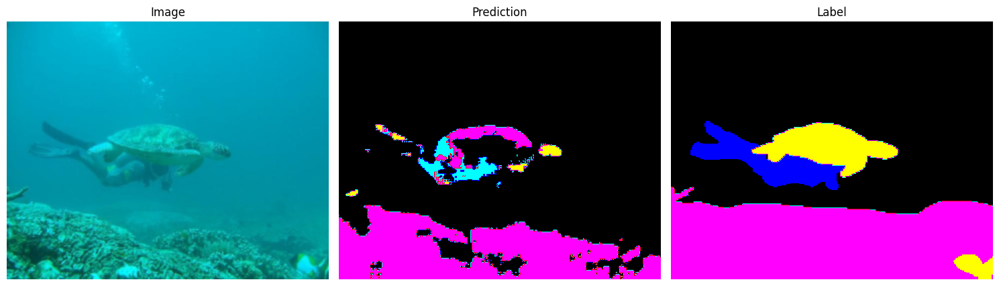

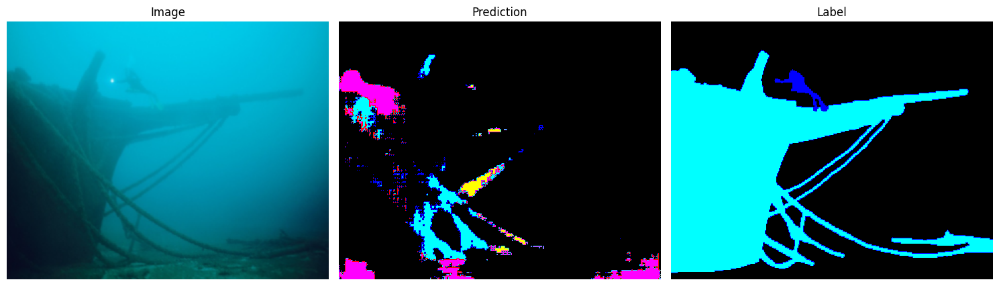

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│   test/f1_class_0_epoch   │    0.7662404775619507     │
│   test/f1_class_1_epoch   │            0.0            │
│   test/f1_class_2_epoch   │    0.04334089905023575    │
│   test/f1_class_3_epoch   │            0.0            │
│   test/f1_class_4_epoch   │    0.4664897322654724     │
│   test/f1_class_5_epoch   │    0.19040840864181519    │
│  test/iou_class_0_epoch   │    0.8668721914291382     │
│  test/iou_class_1_epoch   │            0.0            │
│  test/iou_class_2_epoch   │    0.08037851750850677    │
│  test/iou_class_3_epoch   │            0.0            │
│  test/iou_class_4_epoch   │    0.6249510049819946     │
│  test/iou_class_5_epoch   │    0.3152306377887726     │
│      test/loss_epoch      │    0.7609358429908752     │
└───────────────────────────┴───────────────────────────┘

In [ ]:
evaluate_model(SimpleEncoderDecoder(num_classes = 6), baseline_test_dataloader, "lr=1e-3_bs=32_ep=50_am=none", "SimpleEncoderDecoder")

### Encoder Decoder Network with Skip Connection

Das vorhergehende Encoder Decoder Netzwerk wird um Skip Connections erweitert

- Transformationen: Bilder und Labels werden alle auf eine Grösse von 256x320 transformiert
- Augmentation: Es wird keine Data Augmentation angewendet
- Modell-Aufbau: Das Modell besteht aus je vier Encoder- und Decoder-Blöcke. Zwischen diesen Blöcken wird jeweils eine Skip-Connection aufbebaut (siehe Diagramm unten). Die Encoder-Blöcke bestehen aus einer Convolution, Batch-Normalization, ReLu-Activation, Convolution und Batch-Normalization. Die Decoder-Blöcke 1 - 3 bestehen aus einer De-Convolution, Batch-Normalization, ReLu-Activation, Convolution und Batch-Normalization. Der vierte Decoder-Block besteht aus einer Convolution, um die Feature-Size auf die Anzahl Klassen zu reduzieren.

![](img/encoder_decoder_with_skip_connections_model.drawio.png "Encoder-Decoder Architektur mit Skip-Connection")

In [ ]:
class EncoderWithSkipConnectionBlock(nn.Module):
    """
    Encoder block with skip connection.

    Args:
        in_channels (int): Number of input channels.
        out_channels (int): Number of output channels.
        kernel_size (int): Kernel size.
        padding (int): Padding.
    """

    def __init__(self, in_channels, out_channels, kernel_size = 3, padding = 1):
        """
        Initializes the encoder block.

        Args:
            in_channels (int): Number of input channels.
            out_channels (int): Number of output channels.
            kernel_size (int): Kernel size.
            padding (int): Padding.
        """
        super().__init__()

        self.conv1 = nn.Conv2d(
            in_channels     = in_channels,
            out_channels    = in_channels,
            kernel_size     = kernel_size,
            stride          = 1,
            padding         = padding)

        self.bn1 = nn.BatchNorm2d(num_features = in_channels)

        self.relu = nn.ReLU()

        self.conv2 = nn.Conv2d(
            in_channels     = in_channels,
            out_channels    = out_channels,
            kernel_size     = kernel_size,
            stride          = 2,
            padding         = padding)

        self.bn2 = nn.BatchNorm2d(num_features = out_channels)

    def forward(self, x):
        """
        Forward pass of the encoder block.

        Args:
            x (torch.Tensor): Input tensor.

        Returns:
            torch.Tensor: The output tensor.
        """
        skip = x
        x = self.conv1(x)
        x = self.bn1(x)
        x = self.relu(x)
        x = self.conv2(x)
        x = self.bn2(x)
        x = self.relu(x)
        return x, skip

class DecoderWithSkipConnectionBlock(nn.Module):
    """
    Decoder block with skip connection.

    Args:
        in_channels (int): Number of input channels.
        out_channels (int): Number of output channels.
        kernel_size (int): Kernel size.
        stride (int): Stride.
        padding (int): Padding.
        output_padding (int): Output padding.
    """

    def __init__(self, in_channels, out_channels, kernel_size = 3, stride = 2, padding = 1, output_padding = 1):
        """
        Initializes the decoder block.

        Args:
            in_channels (int): Number of input channels.
            out_channels (int): Number of output channels.
            kernel_size (int): Kernel size.
            stride (int): Stride.
            padding (int): Padding.
            output_padding (int): Output padding.
        """
        super().__init__()

        self.deconv1 = nn.ConvTranspose2d(
            in_channels     = in_channels,
            out_channels    = out_channels,
            kernel_size     = kernel_size,
            stride          = stride,
            padding         = padding,
            output_padding  = output_padding)

        self.bn1 = nn.BatchNorm2d(num_features = out_channels)

        self.relu = nn.ReLU()

        self.conv2 = nn.Conv2d(
            in_channels     = out_channels,
            out_channels    = out_channels,
            kernel_size     = kernel_size,
            stride          = 1,
            padding         = padding)

        self.bn2 = nn.BatchNorm2d(num_features = out_channels)

    def forward(self, x, skip):
        """
        Forward pass of the decoder block.

        Args:
            x (torch.Tensor): Input tensor.
            skip (torch.Tensor): Skip connection tensor.

        Returns:
            torch.Tensor: The output tensor.
        """
        x = self.deconv1(x)
        x = self.bn1(x)
        x = self.relu(x)
        x = self.conv2(x)
        x = self.bn2(x)
        x = self.relu(x)
        x = torch.cat([x, skip], dim = 1)
        return x

class EncoderWithSkipConnection(nn.Module):
    """
    Encoder with skip connections.

    Args:
        num_channels_in (int): Number of input channels.
        num_channels (list): List of output channels.
    """

    def __init__(self, num_channels_in, num_channels):
        """
        Initializes the encoder.

        Args:
            num_channels_in (int): Number of input channels.
            num_channels (list): List of output channels.
        """
        super().__init__()

        num_channels = [num_channels_in] + num_channels
        self.layers_ = nn.ModuleList()
        for in_channels, out_channels in zip(num_channels, num_channels[1:]):
            self.layers_.append(EncoderWithSkipConnectionBlock(in_channels = in_channels, out_channels = out_channels))

    def forward(self, x):
        """
        Forward pass of the encoder.

        Args:
            x (torch.Tensor): Input tensor.

        Returns:
            torch.Tensor: The output tensor.
        """
        skips = []
        for layer in self.layers_:
            x, skip = layer(x)
            skips.append(skip)
        return x, skips


class DecoderWithSkipConnection(nn.Module):
    """
    Decoder with skip connections.

    Args:
        dimensions (list): List of dimensions.
    """

    def __init__(self, dimensions):
        """
        Initializes the decoder.

        Args:
            dimensions (list): List of dimensions.
        """
        super().__init__()

        self.layers_ = nn.ModuleList()
        for in_channels, out_channels in dimensions:
            self.layers_.append(DecoderWithSkipConnectionBlock(in_channels = in_channels, out_channels = out_channels))

    def forward(self, x, skips):
        """
        Forward pass of the decoder.

        Args:
            x (torch.Tensor): Input tensor.
            skips (list): List of skip connections.

        Returns:
            torch.Tensor: The output tensor.
        """
        for layer, skip in zip(self.layers_, reversed(skips)):
            x = layer(x, skip)
        return x

class EncoderDecoderWithSkipConnection(nn.Module):
    """
    Encoder-decoder with skip connections.

    Args:
        channels (int): Number of input channels.
        num_classes (int): Number of classes in the dataset.
    """

    def __init__(self, channels = 3, num_classes = 8):
        """
        Initializes the encoder-decoder.

        Args:
            channels (int): Number of input channels.
            num_classes (int): Number of classes in the dataset.
        """
        super().__init__()

        self.input = nn.Conv2d(
            in_channels     = channels,
            out_channels    = 8,
            kernel_size     = 3,
            stride          = 1,
            padding         = 1,
        )

        self.encoder = EncoderWithSkipConnection(num_channels_in =  8, num_channels = [16, 32, 64])
        self.decoder = DecoderWithSkipConnection(dimensions = [[64, 32], [64, 16], [32, 8]])

        self.output = nn.Conv2d(
            in_channels     = 16,
            out_channels    = num_classes,
            kernel_size     = 1,
            stride          = 1,
            padding         = 0,
        )

    def forward(self, x):
        """
        Forward pass of the model.

        Args:
            x (torch.Tensor): Input tensor.

        Returns:
            torch.Tensor: The output tensor.
        """
        x = self.input(x)
        x, skips = self.encoder(x)
        x = self.decoder(x, skips)
        x = self.output(x)
        return x

#### Testing

In [ ]:
test_model(
    model_6_classes = EncoderDecoderWithSkipConnection(num_classes = 6),
    model_8_classes = EncoderDecoderWithSkipConnection(num_classes = 8))

Validation successful


#### Training

In [ ]:
path = train_model(
    model                   = EncoderDecoderWithSkipConnection(num_classes = 6),
    train_dataloader        = baseline_train_dataloader,
    validation_dataloader   = baseline_validation_dataloader,
    test_dataloader         = baseline_test_dataloader,
    model_name              = "EncoderDecoderWithSkipConnection",
    lr                      = 1e-3)

analyze_metrics(path)

#### Evaluation

Dieses Model wurde mit folgender Konfiguration trainiert:

- Learning Rate: $10^{-3}$
- Batch Size: 32
- Epochs: 50
- Augmentation: keine

Die Verwendung von SkipConnections konnte das Encoder Decoder Modell gemäss Accuracy-Werten leicht verbessern. Gute Resultate haben wir aber auch mit diesem Modell nicht erhalten. Die Loss-Kurve unterscheidet sich nicht wesentlich von derjenigen des Encoder Decoder Modells ohne Skip Connections.

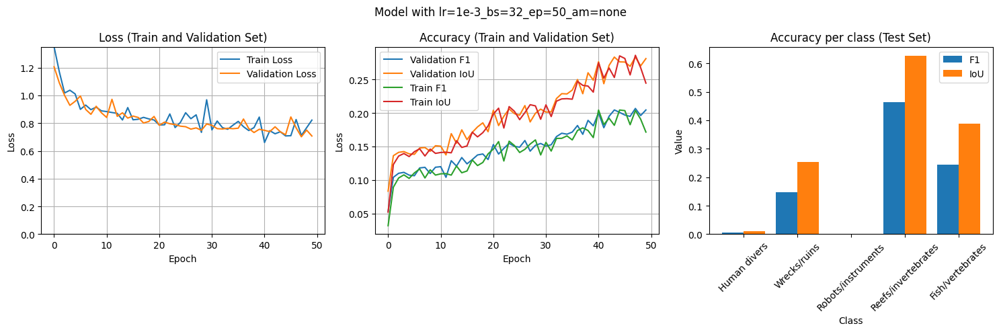

In [ ]:
analyze_metrics(model_name="EncoderDecoderWithSkipConnection", version="lr=1e-3_bs=32_ep=50_am=none")

Bei der genaueren Betrachtung der Predictions auf den Test-Bildern spiegelt sich die marginal verbesserte Accuracy in den Resultaten wider. So wurden im zweiten Test-Bild die beiden Fische besser erkannt als im Encoder Decoder Modell ohne Skip Connections. Die restlichen Bilder zeigen jedoch keine erkennbare Verbesserung.

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
c:\Python312\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:425: The 'test_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=7` in the `DataLoader` to improve performance.


Testing: |          | 0/? [00:00<?, ?it/s]

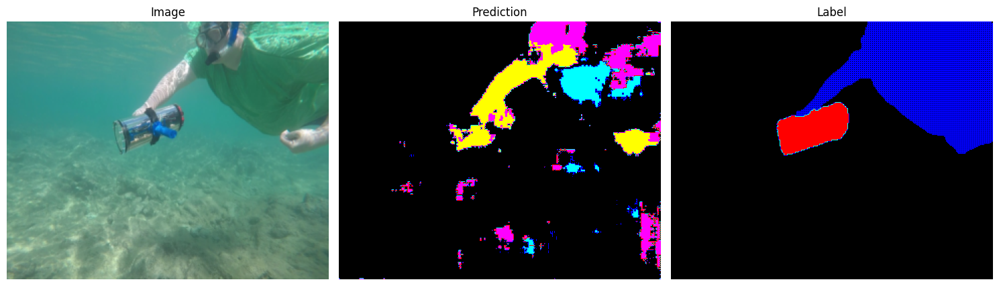

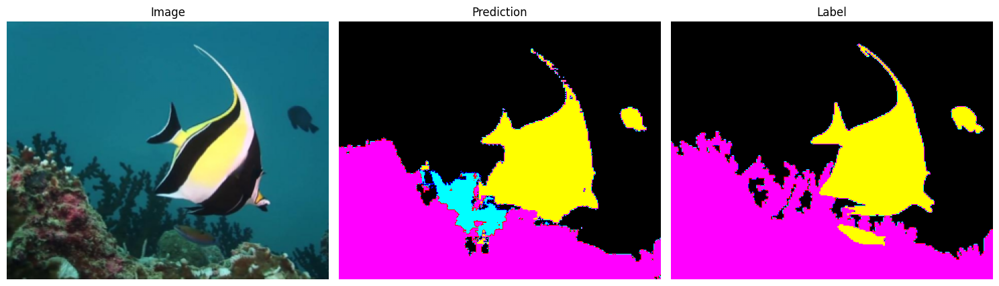

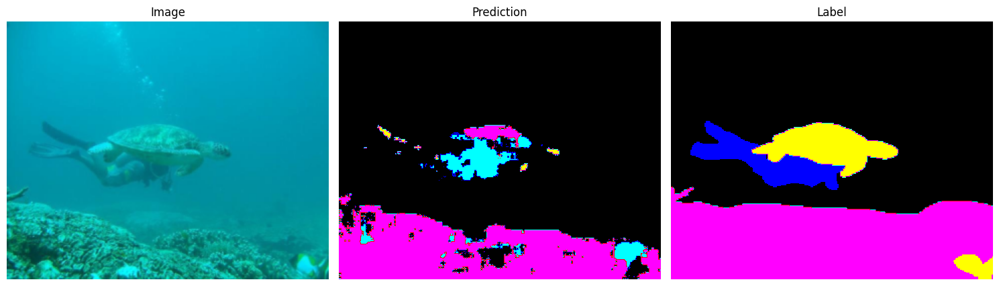

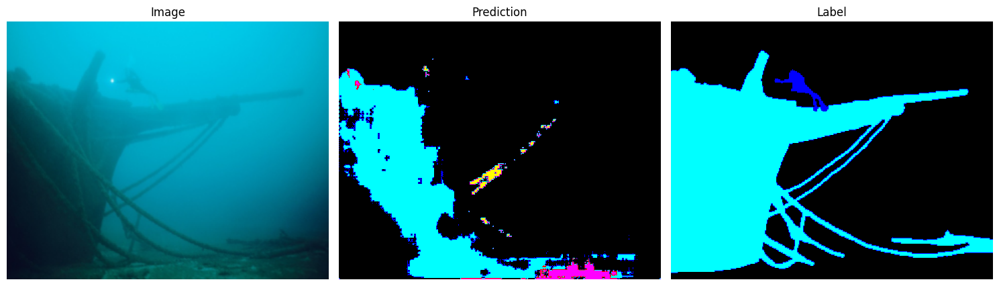

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│   test/f1_class_0_epoch   │     0.761867880821228     │
│   test/f1_class_1_epoch   │   0.0032510447781533003   │
│   test/f1_class_2_epoch   │    0.07660835981369019    │
│   test/f1_class_3_epoch   │            0.0            │
│   test/f1_class_4_epoch   │    0.46545910835266113    │
│   test/f1_class_5_epoch   │     0.213147833943367     │
│  test/iou_class_0_epoch   │    0.8640455007553101     │
│  test/iou_class_1_epoch   │   0.006471114698797464    │
│  test/iou_class_2_epoch   │    0.12960688769817352    │
│  test/iou_class_3_epoch   │            0.0            │
│  test/iou_class_4_epoch   │    0.6229164600372314     │
│  test/iou_class_5_epoch   │    0.3469582200050354     │
│      test/loss_epoch      │    0.7753804922103882     │
└───────────────────────────┴───────────────────────────┘

In [ ]:
load_and_test_model(EncoderDecoderWithSkipConnection(num_classes = 6), baseline_test_dataloader, "lr=1e-3_bs=32_ep=50_am=none", "EncoderDecoderWithSkipConnection")

### ResNet50

In diesem Abschnitt wird ResNet50 Model mit den vortrainierten Gewichtungen (ImageNet) verwendet

- Transformationen: Bilder und Labels werden alle auf eine Grösse von 224x224 transformiert und normalisiert `(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])`
- Augmentation: Es wird keine Data Augmentation angewendet

In [15]:
class ResNet50Segmentation(nn.Module):
    """
    ResNet50 model for segmentation.

    Args:
        num_classes (int): Number of classes in the dataset.
    """

    def __init__(self, num_classes=8):
        """
        Initializes the model.

        Args:
            num_classes (int): Number of classes in the dataset.
        """
        super(ResNet50Segmentation, self).__init__()
        resnet = resnet50(weights = ResNet50_Weights.IMAGENET1K_V2)

        self.base_layers = nn.Sequential(
            *list(resnet.children())[:-2]
        )

        self.segmentation_head = nn.Sequential(
            nn.Conv2d(2048, 512, kernel_size=3, padding=1),
            nn.ReLU(inplace=True),
            nn.Conv2d(512, num_classes, kernel_size=1)
        )

        self.upsample = nn.Upsample(scale_factor=32, mode='bilinear', align_corners=True)

    def forward(self, x):
        """
        Forward pass of the model.

        Args:
            x (torch.Tensor): Input tensor.

        Returns:
            torch.Tensor: The output tensor.
        """
        x = self.base_layers(x)
        x = self.segmentation_head(x)
        x = self.upsample(x)
        return x

#### Testing

In [ ]:
test_model(
    model_6_classes = ResNet50Segmentation(num_classes = 6),
    model_8_classes = ResNet50Segmentation(num_classes = 8))

Validation successful


#### Training

In [21]:
batch_size = 32

transform_labels = transforms.Compose([
    transforms.Resize((224, 224)),
])

resnet50_train_dataset = SuimDataset(
    data_tuples_paths   = train_tuples_paths,
    color_mapping       = colors_to_5cats,
    transform_images    = ResNet50_Weights.IMAGENET1K_V1.transforms(),
    transform_labels    = transform_labels)
resnet50_train_dataloader = DataLoader(resnet50_train_dataset, batch_size = batch_size, shuffle = True)

resnet50_validation_dataset = SuimDataset(
    data_tuples_paths   = validation_tuples_paths,
    color_mapping       = colors_to_5cats,
    transform_images    = ResNet50_Weights.IMAGENET1K_V1.transforms(),
    transform_labels    = transform_labels)
resnet50_validation_dataloader = DataLoader(resnet50_validation_dataset, batch_size = batch_size, shuffle = False)

resnet50_test_dataset = SuimDataset(
    data_tuples_paths   = test_tuples_paths,
    color_mapping       = colors_to_5cats,
    transform_images    = ResNet50_Weights.IMAGENET1K_V1.transforms(),
    transform_labels    = transform_labels)
resnet50_test_dataloader = DataLoader(resnet50_test_dataset, batch_size = batch_size, shuffle = False)


path = train_model(
    model                   = ResNet50Segmentation(num_classes = 6),
    train_dataloader        = resnet50_train_dataloader,
    validation_dataloader   = resnet50_validation_dataloader,
    test_dataloader         = resnet50_test_dataloader,
    model_name              = "ResNet50Segmentation",
    lr                      = 1e-5)

analyze_metrics(path)

Downloading: "https://download.pytorch.org/models/resnet50-11ad3fa6.pth" to /root/.cache/torch/hub/checkpoints/resnet50-11ad3fa6.pth
100%|██████████| 97.8M/97.8M [00:00<00:00, 151MB/s]


#### Evaluation

Dieses Model wurde mit folgenden Konfigurationen trainiert:

| Run | Learning Rate | Batch Size | Epochs | Augmentation |
|-----|---------------|------------|--------|--------------|
| 1   | $ 10^{-4} $   | 32         | 50     | keine        |
| 2   | $ 10^{-5} $   | 32         | 50     | keine        |
| 3   | $ 10^{-5} $   | 32         | 50     | ja           |
| 4   | $ 10^{-6} $   | 8          | 100    | keine        |
| 5   | $ 10^{-6} $   | 32         | 50     | keine        |
| 6   | $ 10^{-6} $   | 32         | 100    | keine        |
| 7   | $ 10^{-6} $   | 32         | 100    | ja           |

Die Learning Rates $ 10^{-4} $ und $ 10^{-5} $ zeigen einen nicht optimalen Verlauf der Loss-Kurve auf dem Validations-Set. Mit einer Learning Rate von $ 10^{-6} $ konnte die Loss-Kurve verbessert werden, dies erfordert jedoch eine längere Trainingsdauer. Bei $ 10^{-6} $ beginnt die Loss-Kurve auf dem Validationset erst bei 100 Epochen langsam zu stagnieren. Die Unterschiede der Accuracy-Werte zwischen Trainings- und Validationsdaten (mittlerer Plot) verringerten sich durch die kleineren Learning Rates - es wurde also eine bessere Generalisierung erreicht (weniger Overfitting). Insgesamt sanken die Accuracy-Werten mit kleineren Learning Rates jedoch, was bei dem Test-Set (Plot ganz rechts) jeweils gut sichtbar ist. Die Batch Size von 8 konnte die Loss-Kurve zusätzlich verbessern.

Auch dieses Modell mit den getesteten Konfigurationen führte nicht zu zufriedenstellenden Resultaten. Die Accuracy-Werte auf dem Test-Set sind sehr tief und die Predictions zeigen keine guten Resultate.

Die Data Augmentation wird in einem späteren Kapitel genauer betrachtet.

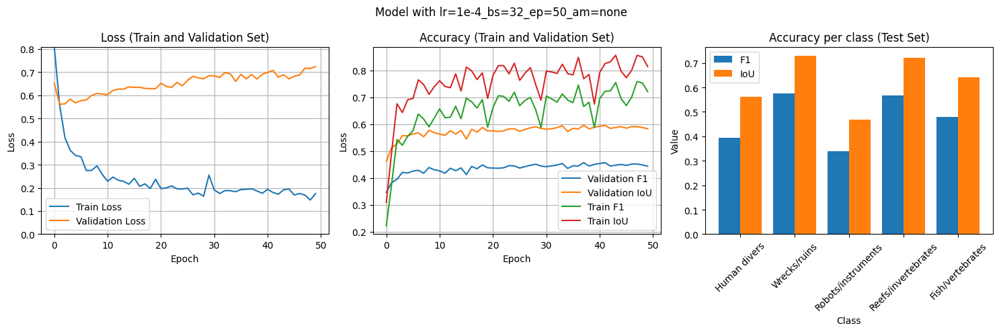

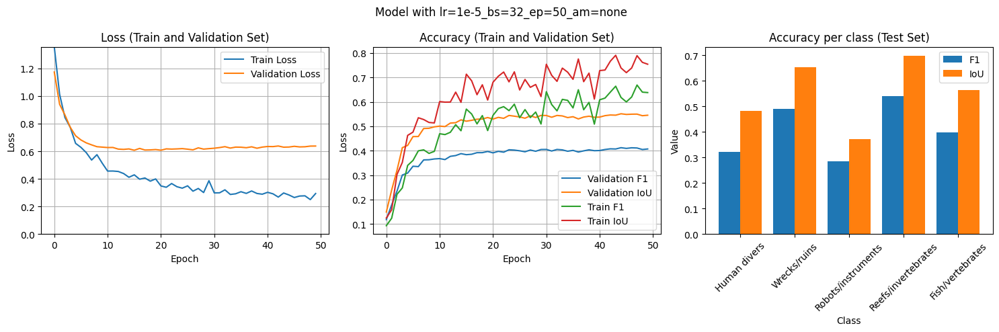

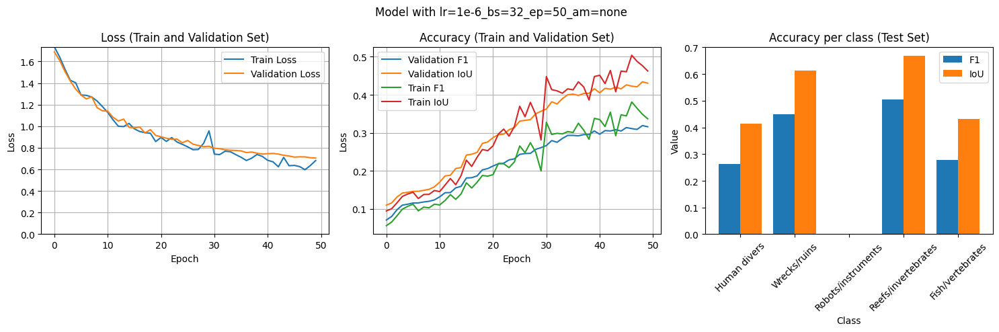

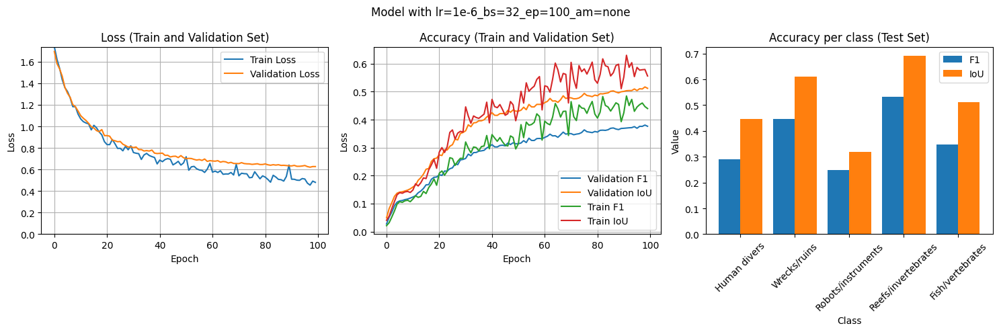

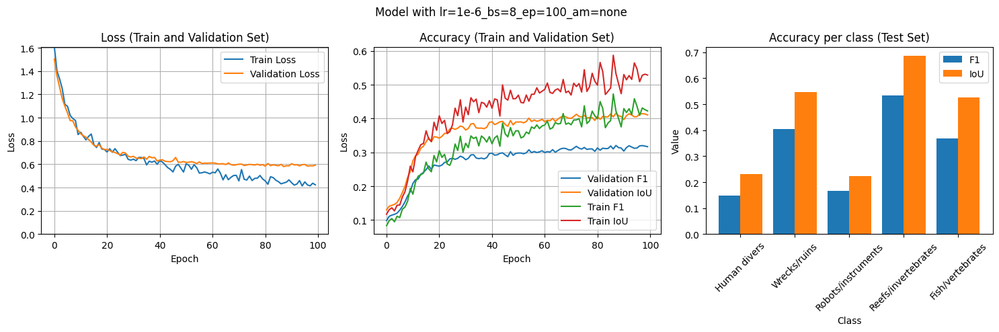

In [ ]:
analyze_metrics(model_name="ResNet50Segmentation", version="lr=1e-4_bs=32_ep=50_am=none")
analyze_metrics(model_name="ResNet50Segmentation", version="lr=1e-5_bs=32_ep=50_am=none")
analyze_metrics(model_name="ResNet50Segmentation", version="lr=1e-6_bs=32_ep=50_am=none")
analyze_metrics(model_name="ResNet50Segmentation", version="lr=1e-6_bs=32_ep=100_am=none")
analyze_metrics(model_name="ResNet50Segmentation", version="lr=1e-6_bs=8_ep=100_am=none")

Die Predictions sind über die getesteten Konfigurationen hinweg sehr ähnlich. Im Vergleich zu den vorherigen Modellen beinhalten die Predictions mit ResNet50 weniger Noise - Flächen wurden insgesamt besser erkannt. Dies lässt auf eine bessere Generalisierung schliessen.

#####  Learning Rate: $10^{-4}$, Batch Size: 32, Epochs: 50, Augmentation: keine

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: |          | 0/? [00:00<?, ?it/s]

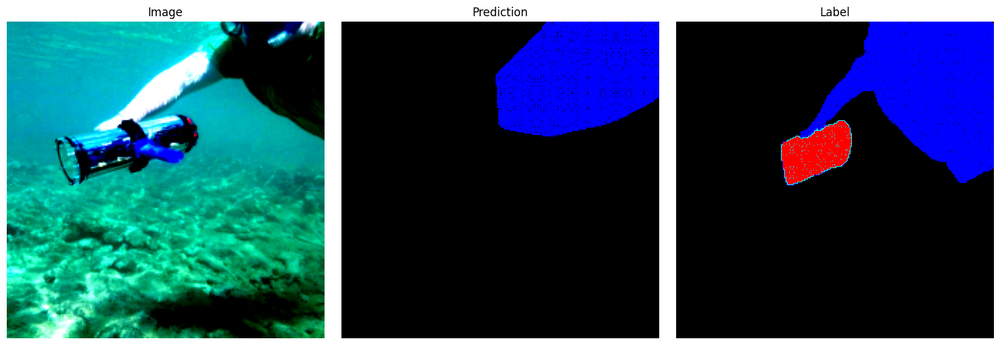

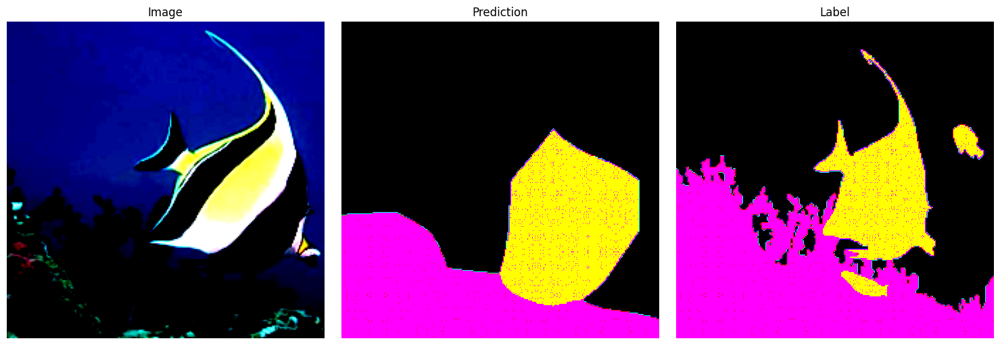

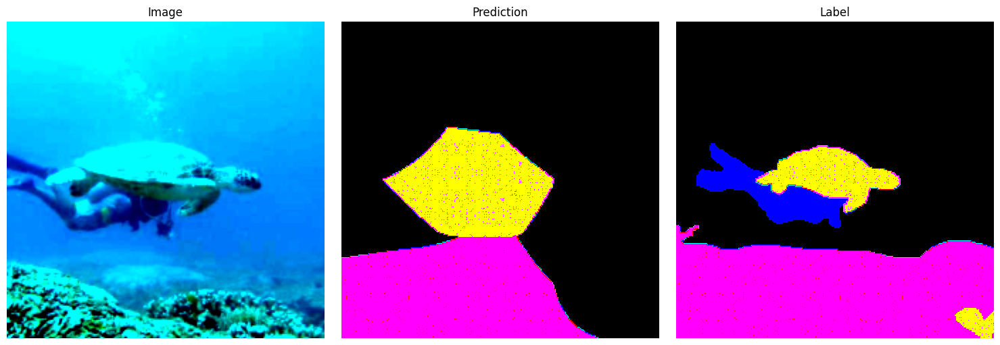

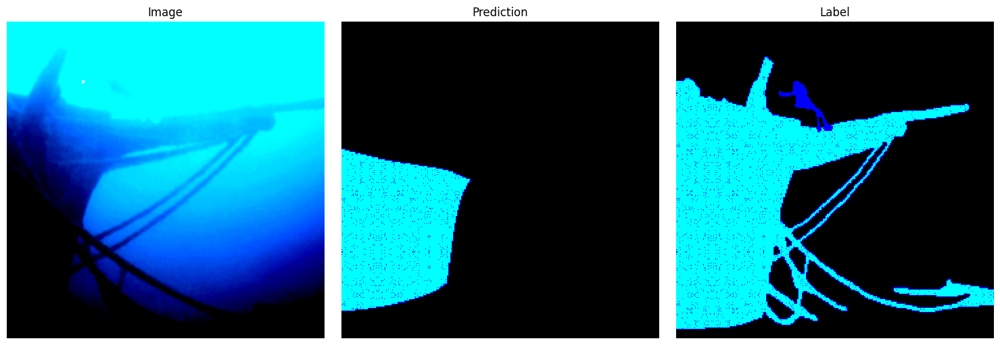

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│   test/f1_class_0_epoch   │    0.7496505975723267     │
│   test/f1_class_1_epoch   │    0.15279702842235565    │
│   test/f1_class_2_epoch   │    0.4178699254989624     │
│   test/f1_class_3_epoch   │    0.25048789381980896    │
│   test/f1_class_4_epoch   │    0.5454339385032654     │
│   test/f1_class_5_epoch   │    0.34760305285453796    │
│  test/iou_class_0_epoch   │    0.8564139604568481     │
│  test/iou_class_1_epoch   │    0.2471083253622055     │
│  test/iou_class_2_epoch   │    0.5237160921096802     │
│  test/iou_class_3_epoch   │    0.3482605814933777     │
│  test/iou_class_4_epoch   │    0.7027376294136047     │
│  test/iou_class_5_epoch   │    0.49526137113571167    │
│      test/loss_epoch      │    0.6084790229797363     │
└───────────────────────────┴───────────────────────────┘

In [ ]:
load_and_test_model(ResNet50Segmentation(num_classes = 6), resnet50_test_dataloader, "lr=1e-4_bs=32_ep=50_am=none",  "ResNet50Segmentation")

#####  Learning Rate: $10^{-5}$, Batch Size: 32, Epochs: 50, Augmentation: keine

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: |          | 0/? [00:00<?, ?it/s]

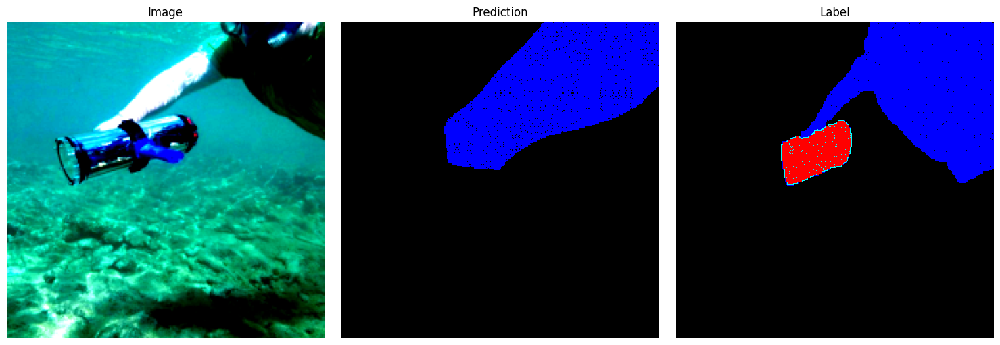

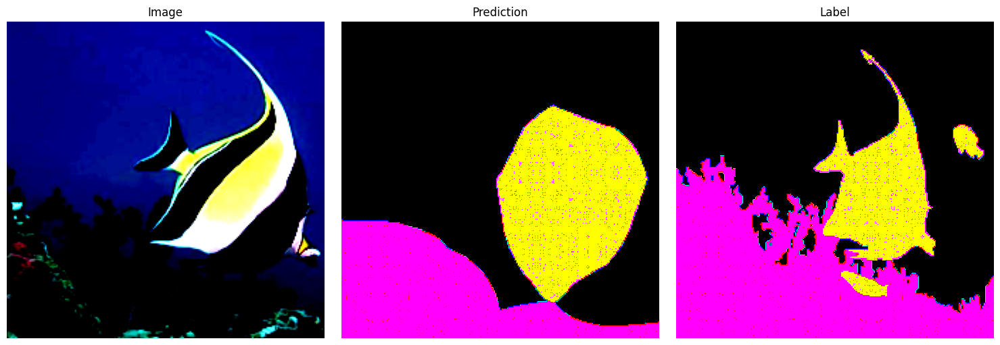

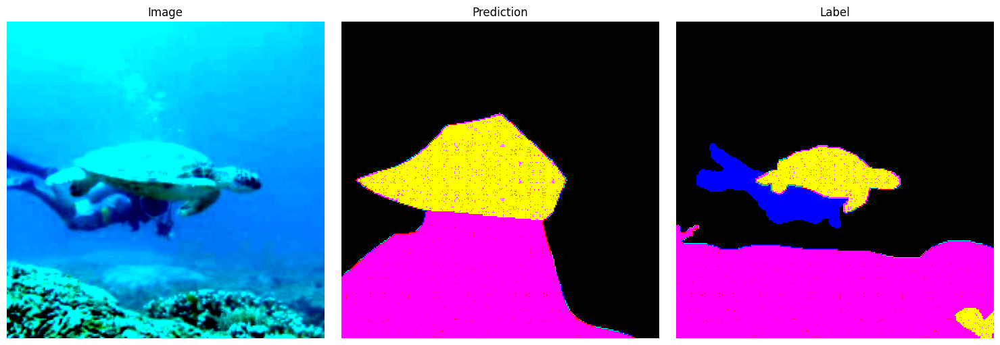

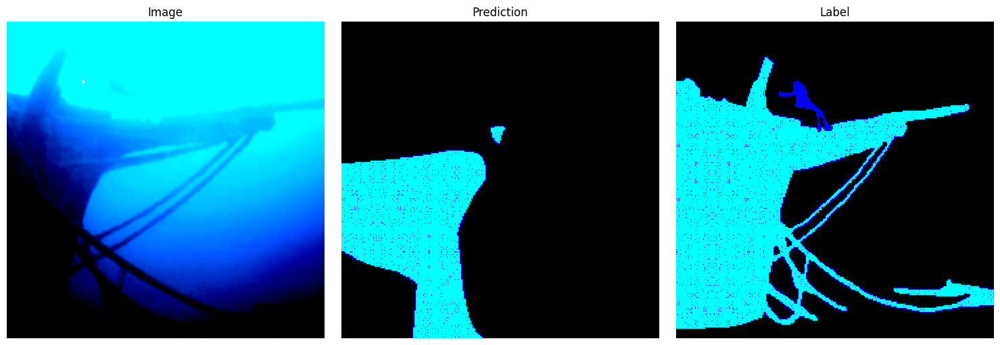

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│   test/f1_class_0_epoch   │    0.7364620566368103     │
│   test/f1_class_1_epoch   │    0.19190005958080292    │
│   test/f1_class_2_epoch   │    0.36041513085365295    │
│   test/f1_class_3_epoch   │    0.2676275074481964     │
│   test/f1_class_4_epoch   │    0.5322825908660889     │
│   test/f1_class_5_epoch   │    0.32512199878692627    │
│  test/iou_class_0_epoch   │    0.8476395606994629     │
│  test/iou_class_1_epoch   │    0.3008236289024353     │
│  test/iou_class_2_epoch   │    0.4771398603916168     │
│  test/iou_class_3_epoch   │    0.36606118083000183    │
│  test/iou_class_4_epoch   │    0.6917775273323059     │
│  test/iou_class_5_epoch   │    0.47271203994750977    │
│      test/loss_epoch      │     0.686058759689331     │
└───────────────────────────┴───────────────────────────┘

In [ ]:
load_and_test_model(ResNet50Segmentation(num_classes = 6), resnet50_test_dataloader, "lr=1e-5_bs=32_ep=50_am=none",  "ResNet50Segmentation")

#####  Learning Rate: $10^{-6}$, Batch Size: 32, Epochs: 50, Augmentation: keine

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: |          | 0/? [00:00<?, ?it/s]

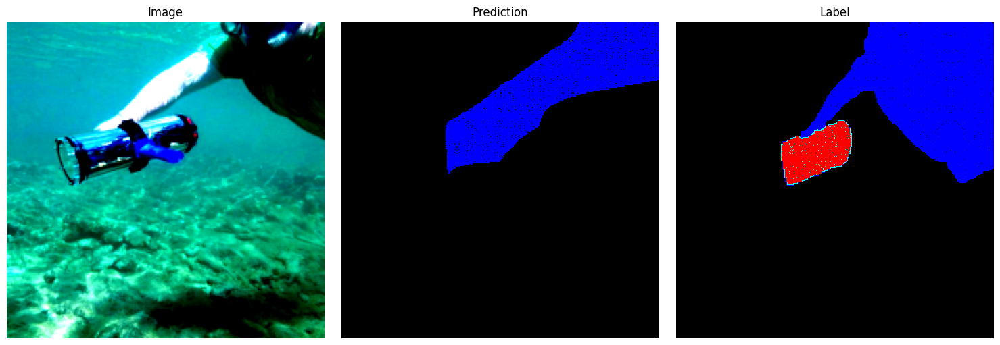

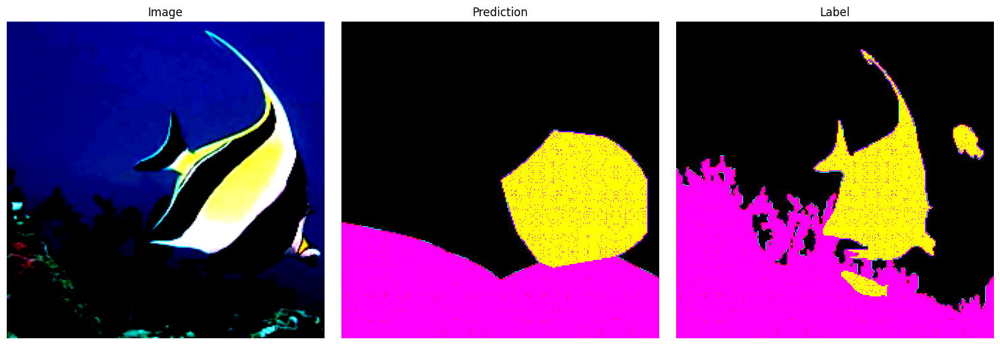

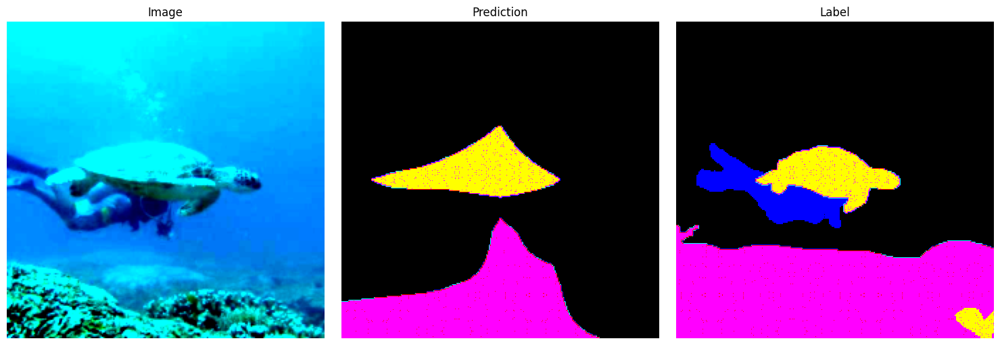

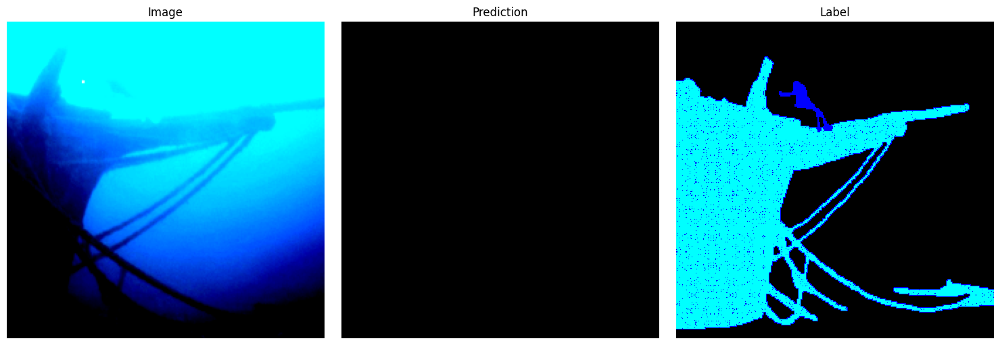

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│   test/f1_class_0_epoch   │    0.7156820297241211     │
│   test/f1_class_1_epoch   │    0.17792733013629913    │
│   test/f1_class_2_epoch   │    0.3578847050666809     │
│   test/f1_class_3_epoch   │   0.0005477603990584612   │
│   test/f1_class_4_epoch   │     0.501446545124054     │
│   test/f1_class_5_epoch   │    0.25371837615966797    │
│  test/iou_class_0_epoch   │     0.833732545375824     │
│  test/iou_class_1_epoch   │    0.28159093856811523    │
│  test/iou_class_2_epoch   │    0.47436636686325073    │
│  test/iou_class_3_epoch   │   0.0010934618767350912   │
│  test/iou_class_4_epoch   │    0.6652685403823853     │
│  test/iou_class_5_epoch   │    0.39184752106666565    │
│      test/loss_epoch      │    0.7599869966506958     │
└───────────────────────────┴───────────────────────────┘

In [ ]:
load_and_test_model(ResNet50Segmentation(num_classes = 6), resnet50_test_dataloader, "lr=1e-6_bs=32_ep=50_am=none",  "ResNet50Segmentation")

#####  Learning Rate: $10^{-6}$, Batch Size: 32, Epochs: 100, Augmentation: keine

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: |          | 0/? [00:00<?, ?it/s]

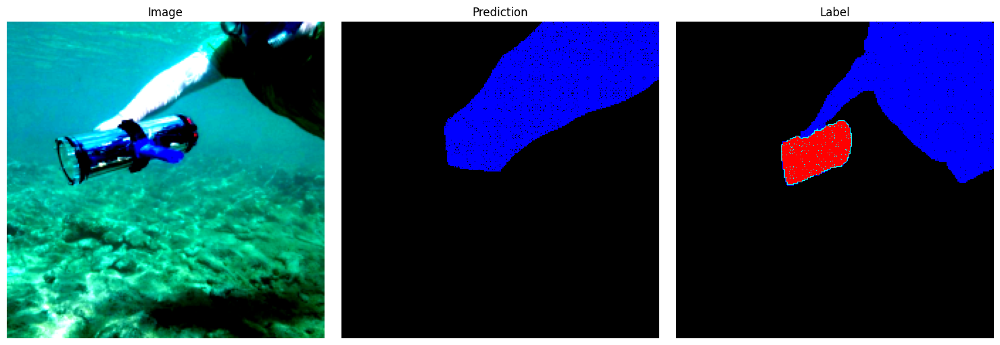

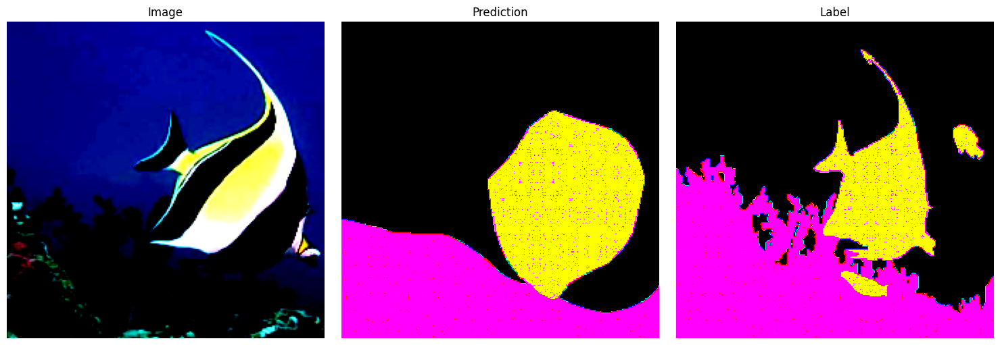

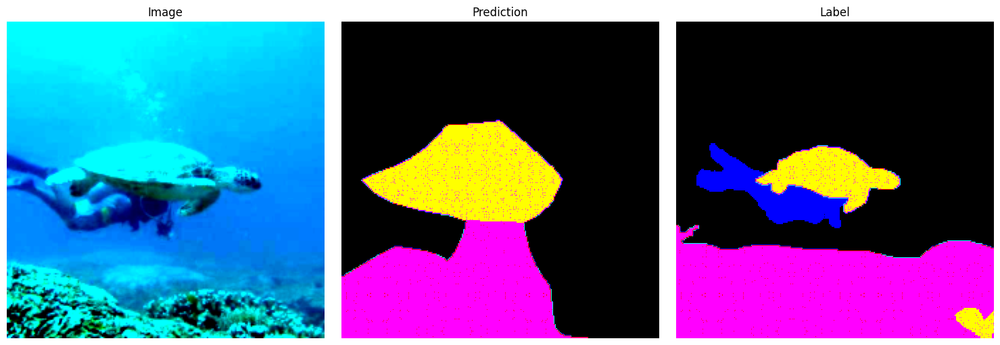

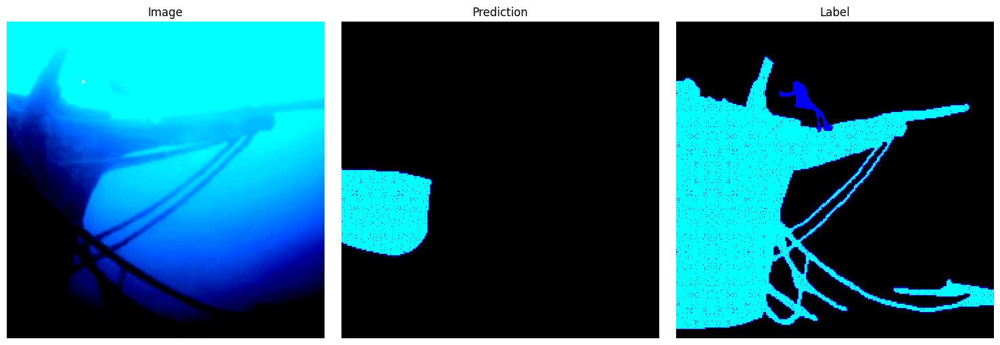

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│   test/f1_class_0_epoch   │    0.7301467657089233     │
│   test/f1_class_1_epoch   │    0.18932734429836273    │
│   test/f1_class_2_epoch   │    0.37060341238975525    │
│   test/f1_class_3_epoch   │    0.2339988350868225     │
│   test/f1_class_4_epoch   │    0.5180361270904541     │
│   test/f1_class_5_epoch   │    0.3107603192329407     │
│  test/iou_class_0_epoch   │    0.8435147404670715     │
│  test/iou_class_1_epoch   │    0.29679739475250244    │
│  test/iou_class_2_epoch   │    0.4858624339103699     │
│  test/iou_class_3_epoch   │    0.3331248164176941     │
│  test/iou_class_4_epoch   │    0.6786495447158813     │
│  test/iou_class_5_epoch   │    0.4575490653514862     │
│      test/loss_epoch      │    0.6982359290122986     │
└───────────────────────────┴───────────────────────────┘

In [ ]:
load_and_test_model(ResNet50Segmentation(num_classes = 6), resnet50_test_dataloader, "lr=1e-6_bs=32_ep=100_am=none", "ResNet50Segmentation")

##### Learning Rate: $10^{-6}$, Batch Size: 8, Epochs: 100, Augmentation: keine

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: |          | 0/? [00:00<?, ?it/s]

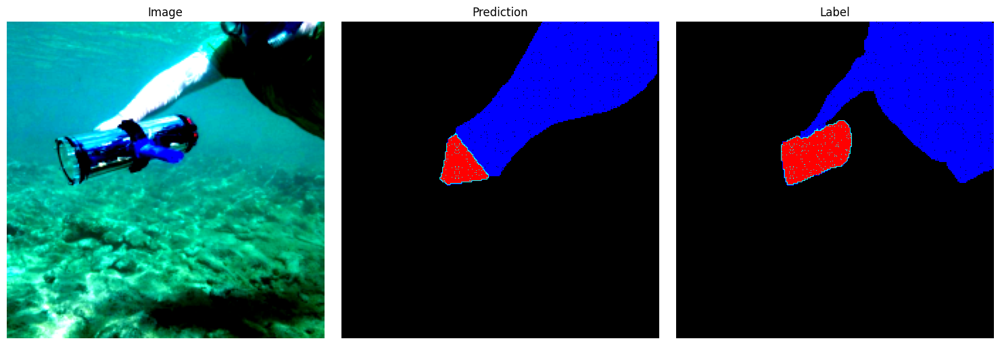

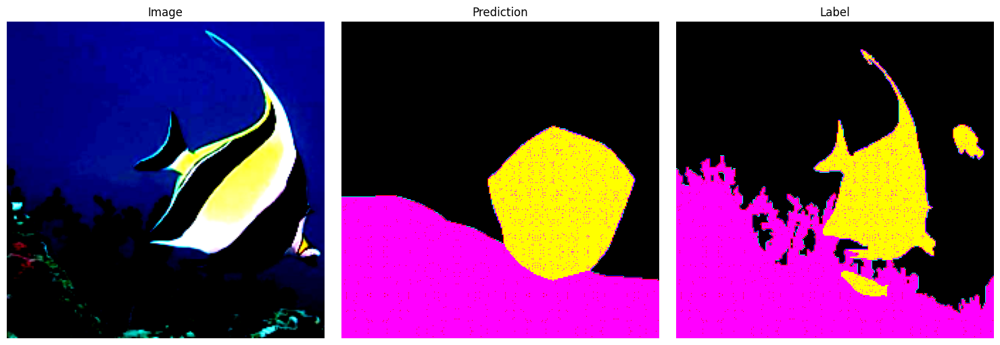

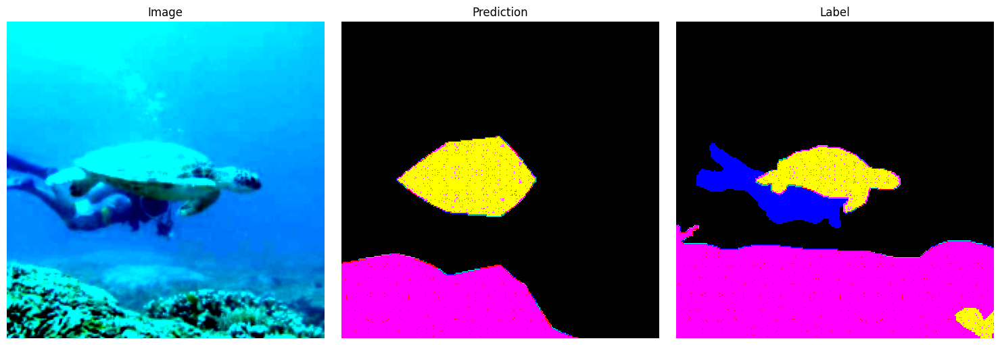

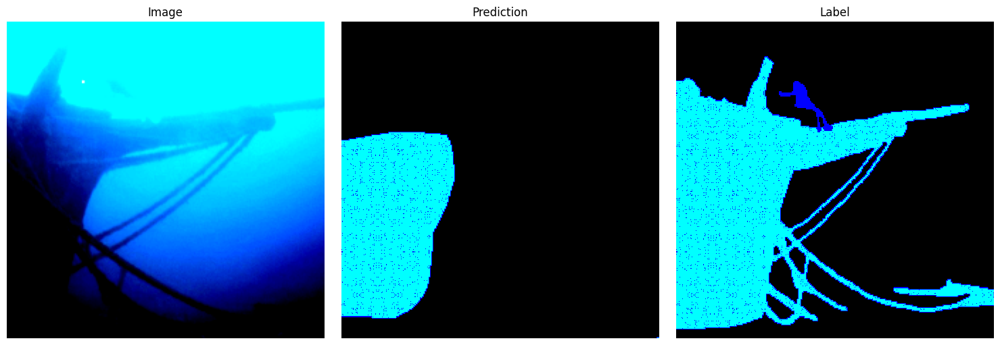

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│   test/f1_class_0_epoch   │    0.7455688714981079     │
│   test/f1_class_1_epoch   │    0.14186367392539978    │
│   test/f1_class_2_epoch   │    0.4373286962509155     │
│   test/f1_class_3_epoch   │    0.2856261730194092     │
│   test/f1_class_4_epoch   │    0.5206040143966675     │
│   test/f1_class_5_epoch   │    0.36650967597961426    │
│  test/iou_class_0_epoch   │    0.8537710905075073     │
│  test/iou_class_1_epoch   │    0.23333154618740082    │
│  test/iou_class_2_epoch   │    0.5360730886459351     │
│  test/iou_class_3_epoch   │    0.3829836845397949     │
│  test/iou_class_4_epoch   │    0.6788432002067566     │
│  test/iou_class_5_epoch   │    0.5245131254196167     │
│      test/loss_epoch      │    0.6396270990371704     │
└───────────────────────────┴───────────────────────────┘

In [ ]:
load_and_test_model(ResNet50Segmentation(num_classes = 6), resnet50_test_dataloader, "lr=1e-6_bs=8_ep=100_am=none",  "ResNet50Segmentation")

### SuimNet VGG16

In diesem Abschnitt wird das Baseline-Modell (SUIM-Net VGG16) versucht zu optimieren.

- Transformationen: Bilder und Labels werden alle auf eine Grösse von 224x224 transformiert und normalisiert `(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])`
- Augmentation: Es wird keine Data Augmentation angewendet
- Modell-Aufbau: Für die vier Encoder-Blöcke werden vortrainierte VGG16 Blöcke verwendet. Danach folgen vier Decoder-Blöcke und ein De-Convolution Layer. Zwischen den Encoder und Decoder Blöcken gibt es Skip-Connections

![](img/suimnet_vgg16.drawio.png "SUIMNet VGG 16 Architektur")

In [16]:
class UpSampleBlockOptimized(nn.Module):
    """
    Optimized upsample block.

    Args:
        in_channels (int): Number of input channels.
        out_channels (int): Number of output channels.
    """

    def __init__(self, in_channels, out_channels):
        """
        Initializes the upsample block.

        Args:
            in_channels (int): Number of input channels.
            out_channels (int): Number of output channels.
        """
        super(UpSampleBlockOptimized, self).__init__()
        self.upsample = nn.UpsamplingNearest2d(scale_factor = 2)
        self.conv = nn.Conv2d(in_channels, out_channels, kernel_size = 3, padding = 1, stride = 1)
        self.relu = nn.ReLU(inplace = True)
        self.bn = nn.BatchNorm2d(out_channels, momentum = 0.8)

    def forward(self, x, skip):
        """
        Forward pass of the upsample block.

        Args:
            x (torch.Tensor): Input tensor.
            skip (torch.Tensor): Skip connection tensor.

        Returns:
            torch.Tensor: The output tensor.
        """
        x = self.upsample(x)
        x = self.conv(x)
        x = self.relu(x)
        x = self.bn(x)
        x = torch.cat([x, skip], dim = 1)
        return x


class SUIMNetVGG16Optimized(nn.Module):
    """
    SUIMNet model based on VGG16 with optimized upsample blocks.

    Args:
        num_classes (int): Number of classes in the dataset.
    """

    def __init__(self, num_classes = 8):
        """
        Initializes the model.

        Args:
            num_classes (int): Number of classes in the dataset.
        """
        super(SUIMNetVGG16Optimized, self).__init__()
        vgg = vgg16(weights = VGG16_Weights.IMAGENET1K_V1)
        self.encoder1 = nn.Sequential(*vgg.features[  : 5])  # Block 1
        self.encoder2 = nn.Sequential(*vgg.features[ 5:10])  # Block 2
        self.encoder3 = nn.Sequential(*vgg.features[10:17])  # Block 3
        self.encoder4 = nn.Sequential(*vgg.features[17:24])  # Block 4

        self.decoder1 = UpSampleBlockOptimized(512,       768)
        self.decoder2 = UpSampleBlockOptimized(768 + 256, 384)
        self.decoder3 = UpSampleBlockOptimized(384 + 128, 192)
        self.decoder4 = nn.UpsamplingNearest2d(scale_factor = 2)
        self.output = nn.Conv2d(192 + 64, num_classes, kernel_size = 3, padding = 1)

    def forward(self, x):
        """
        Forward pass of the model.

        Args:
            x (torch.Tensor): Input tensor.

        Returns:
            torch.Tensor: The output tensor.
        """
        # Encoder
        e1 = self.encoder1(x)
        e2 = self.encoder2(e1)
        e3 = self.encoder3(e2)
        e4 = self.encoder4(e3)

        # Decoder
        d1 = self.decoder1(e4, e3)
        d2 = self.decoder2(d1, e2)
        d3 = self.decoder3(d2, e1)
        d4 = self.decoder4(d3)
        out = self.output(d4)

        return out

#### Testing

In [ ]:
test_model(
    model_6_classes = SUIMNetVGG16Optimized(num_classes = 6),
    model_8_classes = SUIMNetVGG16Optimized(num_classes = 8))

Validation successful


#### Training

In [22]:
batch_size = 32

transform_labels = transforms.Compose([
    transforms.Resize((224, 224)),
])

vgg16optimized_train_dataset = SuimDataset(
    data_tuples_paths   = train_tuples_paths,
    color_mapping       = colors_to_5cats,
    transform_images    = VGG16_Weights.IMAGENET1K_V1.transforms(),
    transform_labels    = transform_labels)
vgg16optimized_train_dataloader = DataLoader(vgg16optimized_train_dataset, batch_size = batch_size, shuffle = True)

vgg16optimized_validation_dataset = SuimDataset(
    data_tuples_paths   = validation_tuples_paths,
    color_mapping       = colors_to_5cats,
    transform_images    = VGG16_Weights.IMAGENET1K_V1.transforms(),
    transform_labels    = transform_labels)
vgg16optimized_validation_dataloader = DataLoader(vgg16optimized_validation_dataset, batch_size = batch_size, shuffle = False)

vgg16optimized_test_dataset = SuimDataset(
    data_tuples_paths   = test_tuples_paths,
    color_mapping       = colors_to_5cats,
    transform_images    = VGG16_Weights.IMAGENET1K_V1.transforms(),
    transform_labels    = transform_labels)
vgg16optimized_test_dataloader = DataLoader(vgg16optimized_test_dataset, batch_size = batch_size, shuffle = False)

path = train_model(
    model                   = SUIMNetVGG16Optimized(num_classes = 6),
    train_dataloader        = vgg16optimized_train_dataloader,
    validation_dataloader   = vgg16optimized_validation_dataloader,
    test_dataloader         = vgg16optimized_test_dataloader,
    model_name              = "SUIMNetVGG16Optimized",
    lr                      = 1e-5)

analyze_metrics(path)

#### Evaluation

Dieses Model wurde mit folgenden Konfigurationen trainiert:

| Run | Learning Rate | Batch Size | Epochs | Augmentation |
|-----|---------------|------------|--------|--------------|
| 1   | $ 10^{-4} $   | 32         | 50     | keine        |
| 2   | $ 10^{-5} $   | 32         | 50     | keine        |
| 3   | $ 10^{-5} $   | 32         | 50     | ja           |
| 4   | $ 10^{-6} $   | 8          | 100    | keine        |
| 5   | $ 10^{-6} $   | 32         | 50     | keine        |
| 6   | $ 10^{-6} $   | 32         | 100    | keine        |
| 7   | $ 10^{-6} $   | 32         | 100    | ja           |

Mit dem VGG16 Modell (inkl. Skip Connections) sind ähnliche Resultate wie mit dem ResNet50 Modell erzielt worden. Ab der Learning Rate $ 10^{-6} $ erhalten wir eine stagnierende Loss-Kurve auf dem Validations-Set, dies bedingt jedoch auch widerum eine Erhöhung der Epochenanzahl. Obschon diese Version der Implementation aus dem Paper entspricht, konnten wir die vom Paper erzielten Accuracy-Werte nicht erreichen. Unsere Werte sind deutlich tiefer. Auch hier sinken die Accuracy-Werte mit kleineren Learning Rates.

Die Data Augmentation wird in einem späteren Kapitel genauer betrachtet.

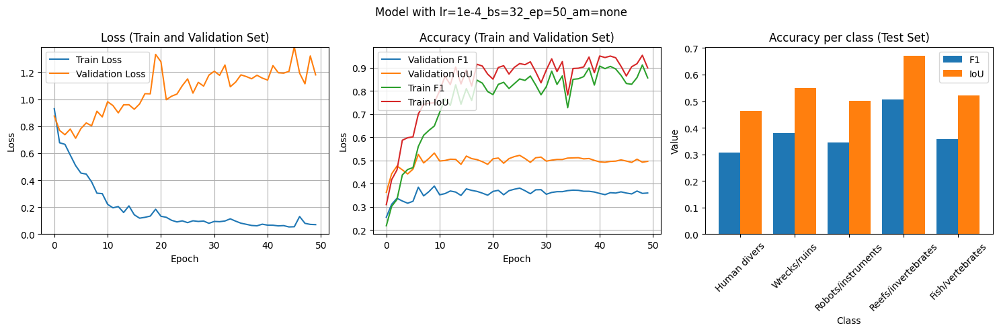

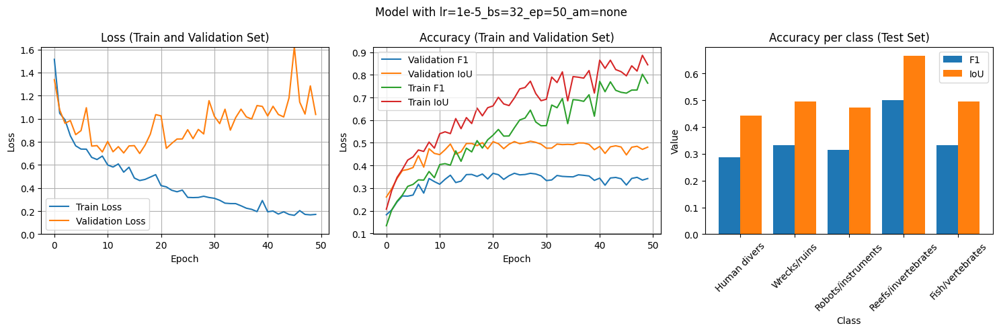

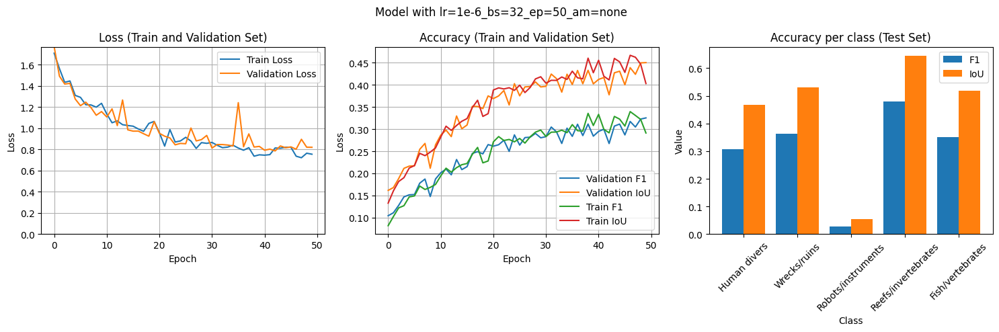

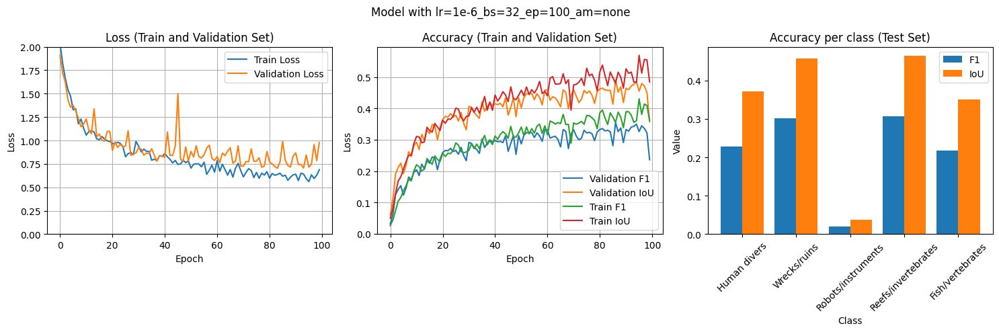

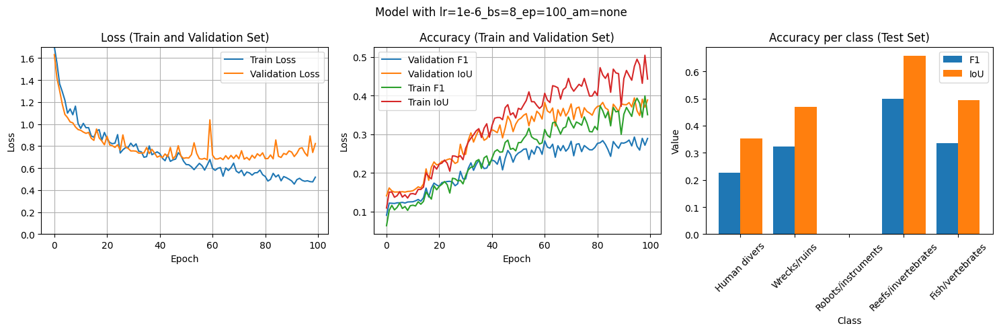

In [ ]:
analyze_metrics(model_name="SUIMNetVGG16Optimized", version="lr=1e-4_bs=32_ep=50_am=none")
analyze_metrics(model_name="SUIMNetVGG16Optimized", version="lr=1e-5_bs=32_ep=50_am=none")
analyze_metrics(model_name="SUIMNetVGG16Optimized", version="lr=1e-6_bs=32_ep=50_am=none")
analyze_metrics(model_name="SUIMNetVGG16Optimized", version="lr=1e-6_bs=32_ep=100_am=none")
analyze_metrics(model_name="SUIMNetVGG16Optimized", version="lr=1e-6_bs=8_ep=100_am=none")

#####  Learning Rate: $10^{-4}$, Batch Size: 32, Epochs: 50, Augmentation: keine

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
c:\Python312\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:425: The 'test_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=7` in the `DataLoader` to improve performance.


Testing: |          | 0/? [00:00<?, ?it/s]

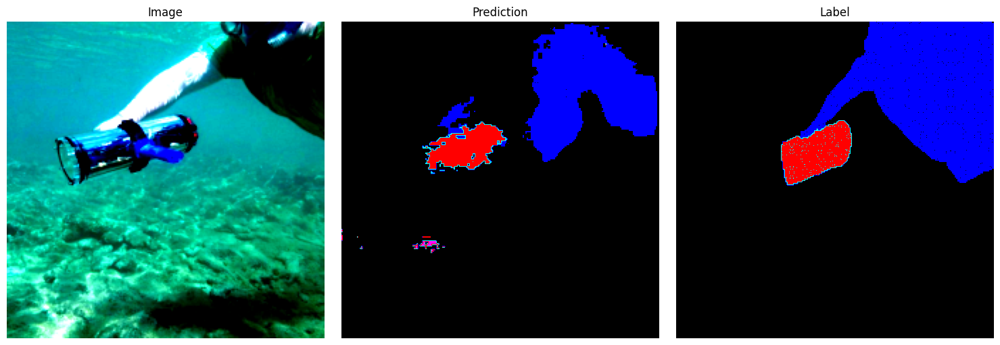

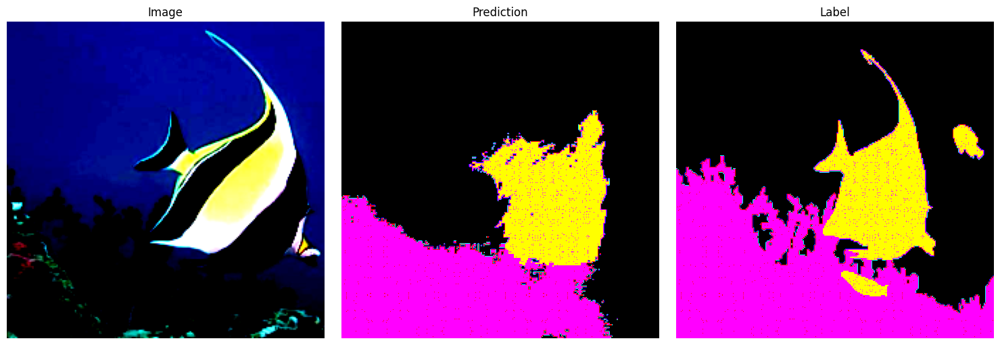

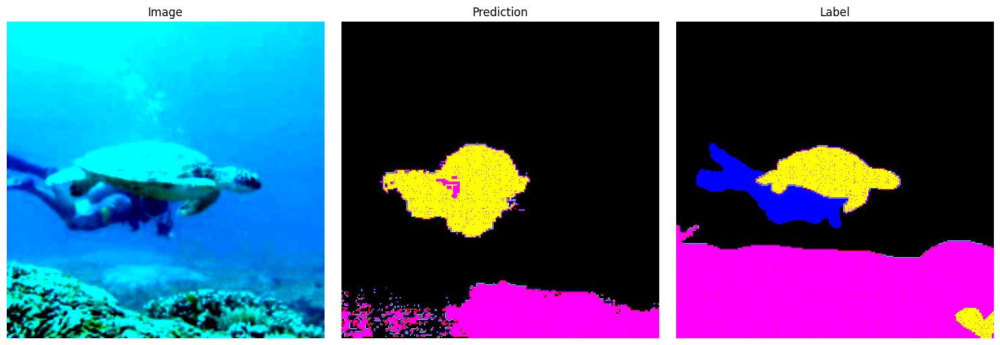

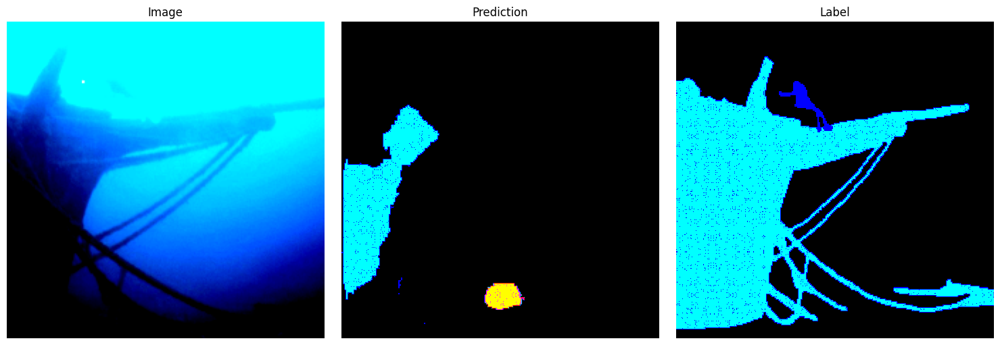

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│   test/f1_class_0_epoch   │    0.7321195006370544     │
│   test/f1_class_1_epoch   │    0.1575901061296463     │
│   test/f1_class_2_epoch   │    0.18679216504096985    │
│   test/f1_class_3_epoch   │    0.13887399435043335    │
│   test/f1_class_4_epoch   │    0.4932573437690735     │
│   test/f1_class_5_epoch   │    0.3520407974720001     │
│  test/iou_class_0_epoch   │    0.8446794152259827     │
│  test/iou_class_1_epoch   │    0.25368401408195496    │
│  test/iou_class_2_epoch   │    0.2940294146537781     │
│  test/iou_class_3_epoch   │    0.2163238227367401     │
│  test/iou_class_4_epoch   │    0.6576929688453674     │
│  test/iou_class_5_epoch   │    0.5005428791046143     │
│      test/loss_epoch      │    0.8062976598739624     │
└───────────────────────────┴───────────────────────────┘

In [ ]:
load_and_test_model(SUIMNetVGG16Optimized(num_classes = 6), vgg16optimized_test_dataloader, "lr=1e-4_bs=32_ep=50_am=none",  "SUIMNetVGG16Optimized")

#####  Learning Rate: $10^{-5}$, Batch Size: 32, Epochs: 50, Augmentation: keine

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: |          | 0/? [00:00<?, ?it/s]

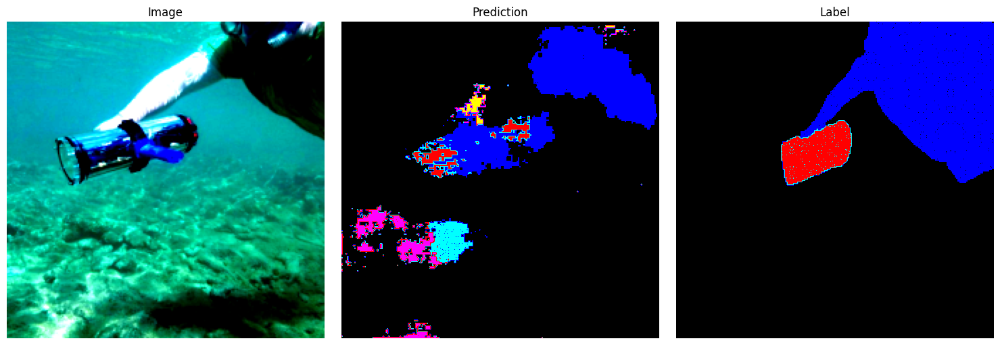

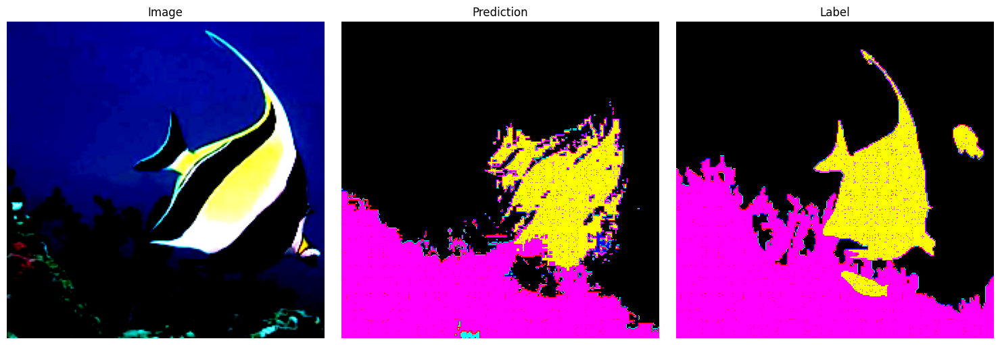

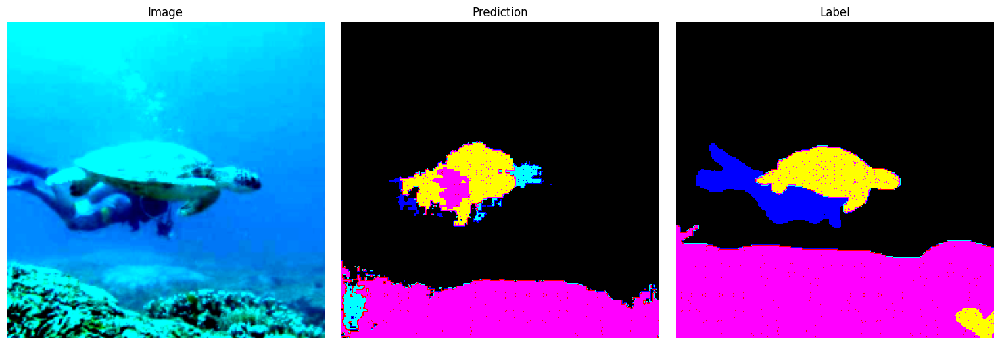

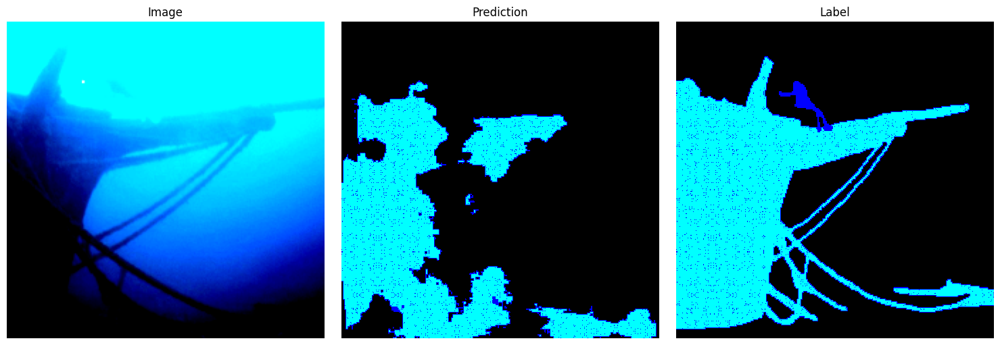

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│   test/f1_class_0_epoch   │    0.7281819581985474     │
│   test/f1_class_1_epoch   │    0.22208164632320404    │
│   test/f1_class_2_epoch   │    0.2243143916130066     │
│   test/f1_class_3_epoch   │    0.10974063724279404    │
│   test/f1_class_4_epoch   │    0.5167009234428406     │
│   test/f1_class_5_epoch   │    0.32255327701568604    │
│  test/iou_class_0_epoch   │     0.842240571975708     │
│  test/iou_class_1_epoch   │    0.3486476540565491     │
│  test/iou_class_2_epoch   │    0.31900545954704285    │
│  test/iou_class_3_epoch   │    0.1844489425420761     │
│  test/iou_class_4_epoch   │    0.6764063835144043     │
│  test/iou_class_5_epoch   │    0.47067034244537354    │
│      test/loss_epoch      │     0.735894501209259     │
└───────────────────────────┴───────────────────────────┘

In [ ]:
load_and_test_model(SUIMNetVGG16Optimized(num_classes = 6), vgg16optimized_test_dataloader, "lr=1e-5_bs=32_ep=50_am=none",  "SUIMNetVGG16Optimized")

#####  Learning Rate: $10^{-6}$, Batch Size: 32, Epochs: 50, Augmentation: keine

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: |          | 0/? [00:00<?, ?it/s]

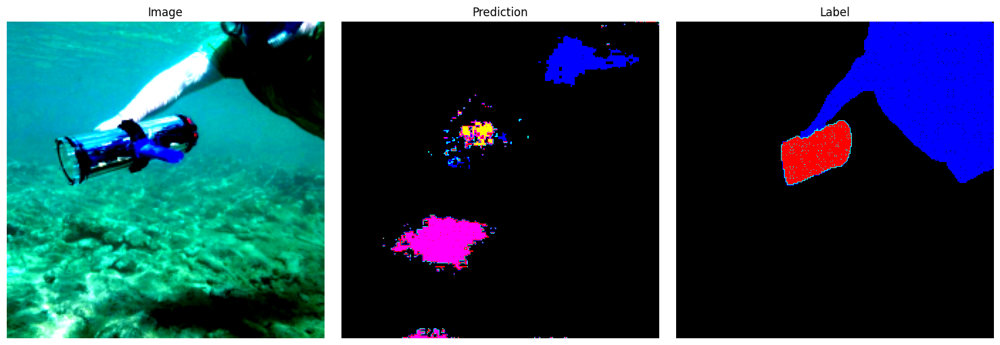

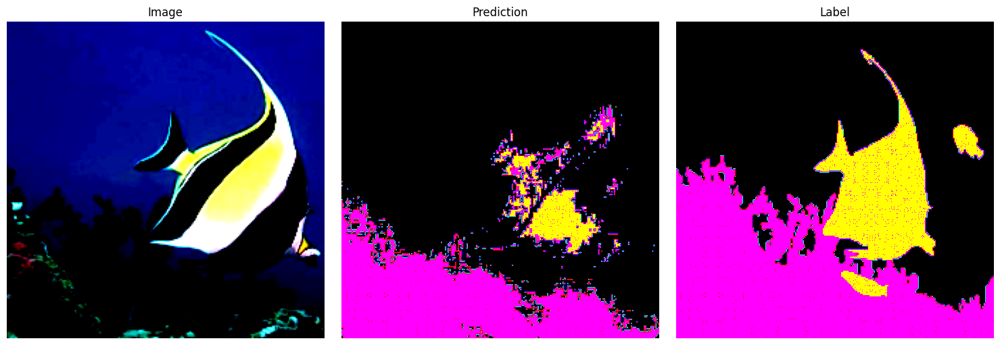

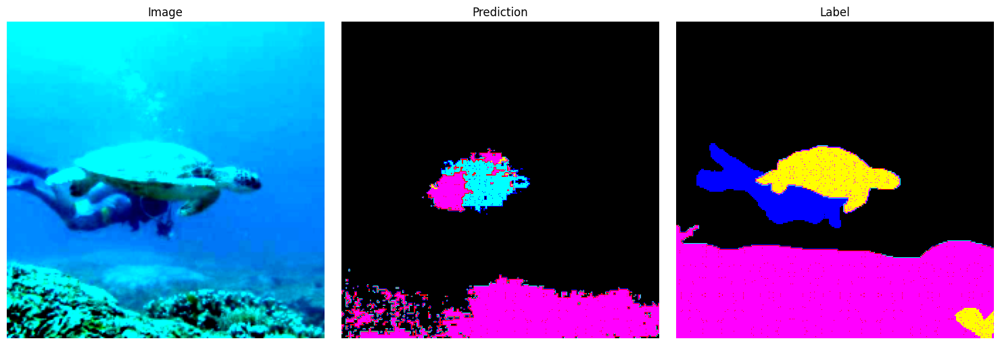

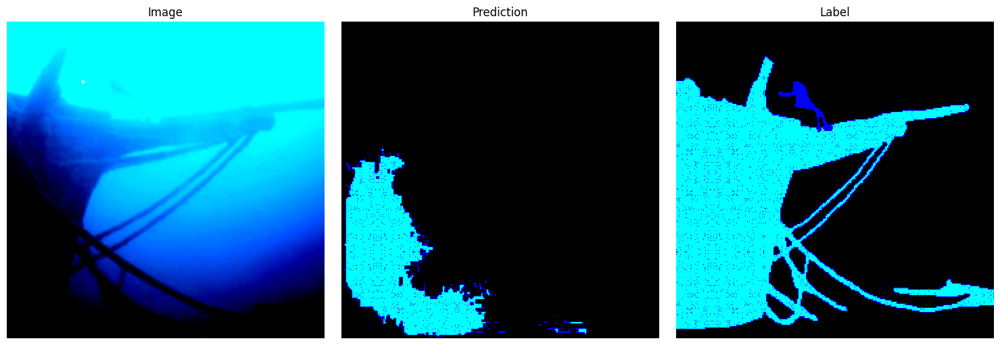

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│   test/f1_class_0_epoch   │    0.7293840646743774     │
│   test/f1_class_1_epoch   │    0.13201917707920074    │
│   test/f1_class_2_epoch   │    0.17537187039852142    │
│   test/f1_class_3_epoch   │   0.004113982431590557    │
│   test/f1_class_4_epoch   │    0.48088669776916504    │
│   test/f1_class_5_epoch   │    0.18719838559627533    │
│  test/iou_class_0_epoch   │    0.8431166410446167     │
│  test/iou_class_1_epoch   │    0.22851596772670746    │
│  test/iou_class_2_epoch   │    0.26912203431129456    │
│  test/iou_class_3_epoch   │    0.00816828291863203    │
│  test/iou_class_4_epoch   │    0.6458145380020142     │
│  test/iou_class_5_epoch   │    0.3105836808681488     │
│      test/loss_epoch      │    0.7996339797973633     │
└───────────────────────────┴───────────────────────────┘

In [ ]:
load_and_test_model(SUIMNetVGG16Optimized(num_classes = 6), vgg16optimized_test_dataloader, "lr=1e-6_bs=32_ep=50_am=none",  "SUIMNetVGG16Optimized")

#####  Learning Rate: $10^{-6}$, Batch Size: 32, Epochs: 100, Augmentation: keine

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: |          | 0/? [00:00<?, ?it/s]

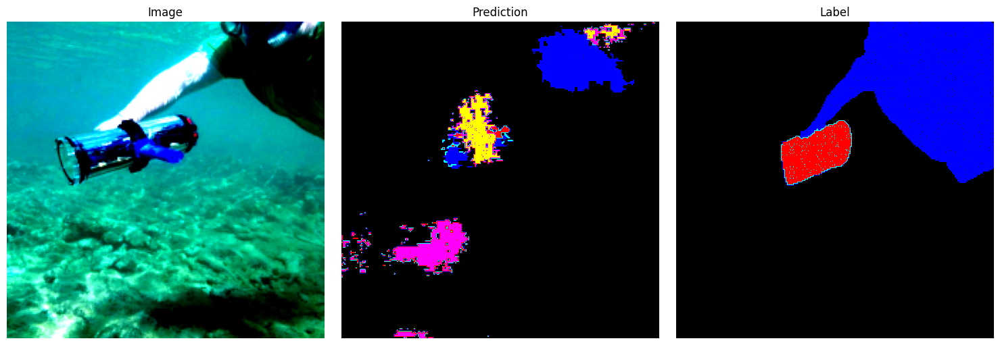

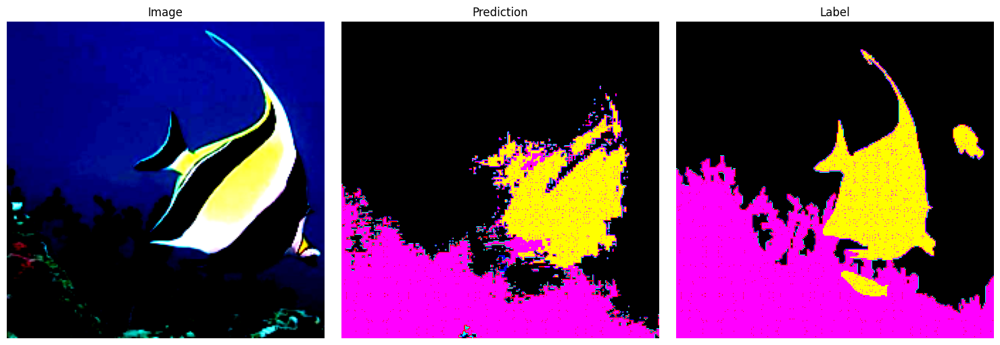

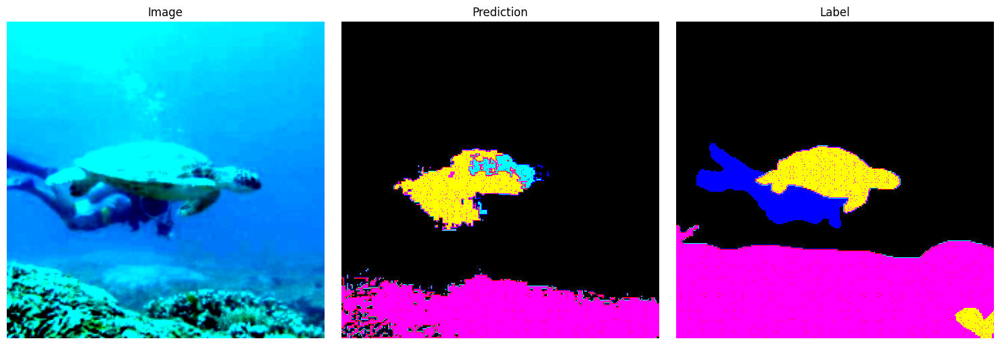

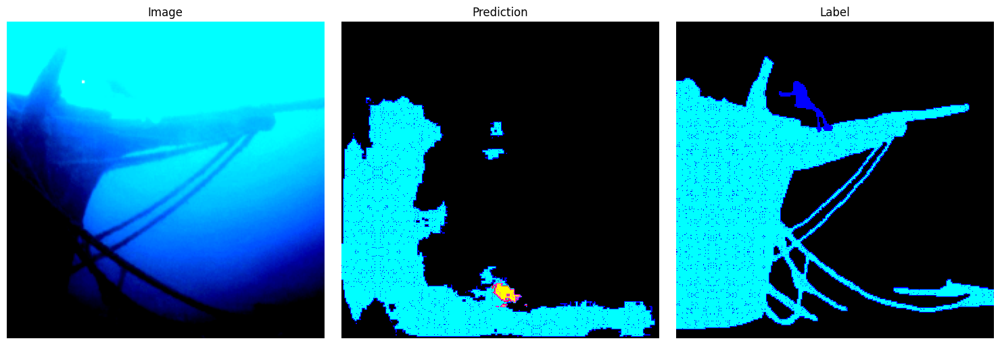

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│   test/f1_class_0_epoch   │    0.7317014932632446     │
│   test/f1_class_1_epoch   │    0.17258387804031372    │
│   test/f1_class_2_epoch   │    0.21997135877609253    │
│   test/f1_class_3_epoch   │    0.04195946455001831    │
│   test/f1_class_4_epoch   │    0.5057006478309631     │
│   test/f1_class_5_epoch   │    0.3342445492744446     │
│  test/iou_class_0_epoch   │    0.8447109460830688     │
│  test/iou_class_1_epoch   │    0.2844487130641937     │
│  test/iou_class_2_epoch   │    0.3236943185329437     │
│  test/iou_class_3_epoch   │    0.07682937383651733    │
│  test/iou_class_4_epoch   │    0.6676543951034546     │
│  test/iou_class_5_epoch   │    0.48339343070983887    │
│      test/loss_epoch      │    0.7449862957000732     │
└───────────────────────────┴───────────────────────────┘

In [ ]:
load_and_test_model(SUIMNetVGG16Optimized(num_classes = 6), vgg16optimized_test_dataloader, "lr=1e-6_bs=32_ep=100_am=none", "SUIMNetVGG16Optimized")

##### Learning Rate: $10^{-6}$, Batch Size: 8, Epochs: 100, Augmentation: keine

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
c:\Python312\Lib\site-packages\pytorch_lightning\core\saving.py:195: Found keys that are not in the model state dict but in the checkpoint: ['model.decoder1.upsample.weight', 'model.decoder1.upsample.bias', 'model.decoder2.upsample.weight', 'model.decoder2.upsample.bias', 'model.decoder3.upsample.weight', 'model.decoder3.upsample.bias', 'model.decoder4.weight', 'model.decoder4.bias']
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: |          | 0/? [00:00<?, ?it/s]

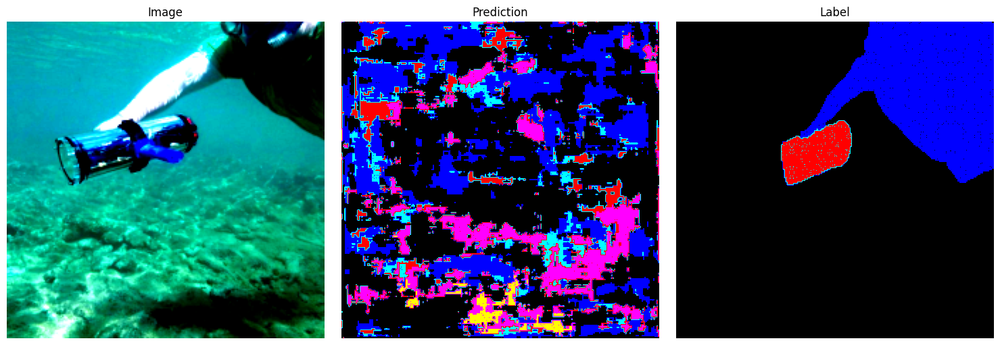

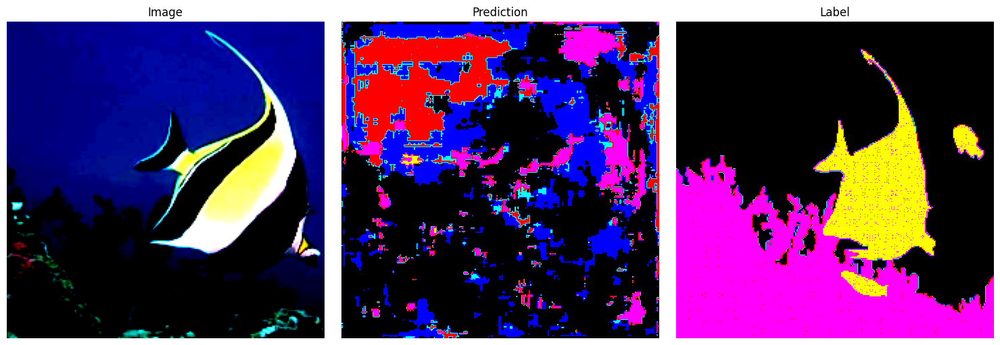

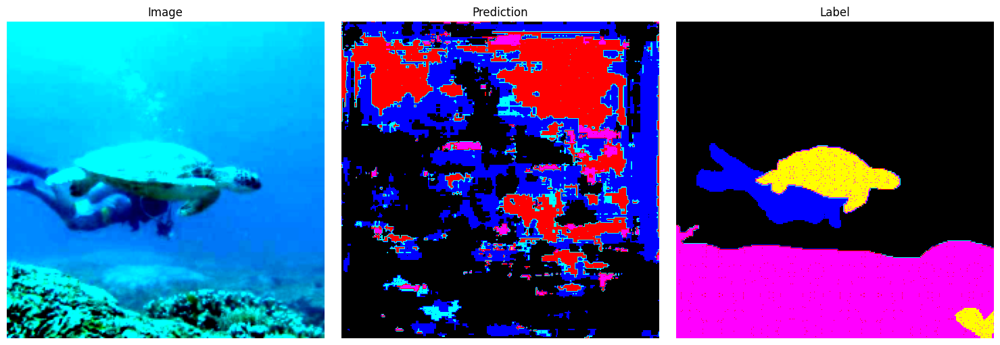

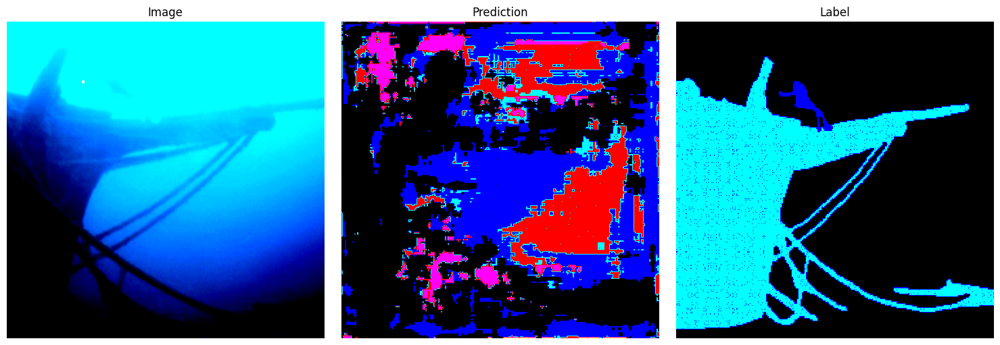

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│   test/f1_class_0_epoch   │    0.3341373801231384     │
│   test/f1_class_1_epoch   │   0.021187780424952507    │
│   test/f1_class_2_epoch   │   0.008415964432060719    │
│   test/f1_class_3_epoch   │   0.0021105287596583366   │
│   test/f1_class_4_epoch   │    0.06494713574647903    │
│   test/f1_class_5_epoch   │   0.0011268546804785728   │
│  test/iou_class_0_epoch   │    0.5000389218330383     │
│  test/iou_class_1_epoch   │   0.040679238736629486    │
│  test/iou_class_2_epoch   │   0.016535062342882156    │
│  test/iou_class_3_epoch   │   0.004205063451081514    │
│  test/iou_class_4_epoch   │    0.12156268954277039    │
│  test/iou_class_5_epoch   │   0.0022502776701003313   │
│      test/loss_epoch      │     7.05270528793335      │
└───────────────────────────┴───────────────────────────┘

In [ ]:
load_and_test_model(SUIMNetVGG16Optimized(num_classes = 6), vgg16optimized_test_dataloader, "lr=1e-6_bs=8_ep=100_am=none",  "SUIMNetVGG16Optimized")

### SuimNet RSB

In diesem Abschnitt wird das SUIM-Net RSB Model aus dem Paper implementiert.

- Transformationen: Bilder und Labels werden alle auf eine Grösse von 256x320 transformiert
- Augmentation: Es wird keine Data Augmentation angewendet
- Modell-Aufbau: Der Encoder besteht aus insgesamt sieben RSB-Blöcken. Ein RSB-Block besteht dabei aus drei Sub-Blöcken, welche wiederum aus einer Convolution, Batch-Normalization und ReLu-Activation bestehen. Zwischen einigen RSB-Blöcken gibt es Skip-Connections. Die Decoder-Blöcke bestehen aus Convolution, Batch-Normalization und De-Convolution.

![](img/suimnet_rsb.drawio.png "SUIMNet RSB Architektur")

In [ ]:
class RSBBlock(nn.Module):
    """
    Residual block with skip connection

    Args:
        input_channels (int): Number of input channels
        output_channels (list): List of 4 integers representing the number of output channels for each sub-block
        stride (int): Stride for the first convolution
        skip (bool): If True, the block will have a skip connection
    """

    def __init__(self, input_channels, output_channels, stride = 1, skip = True):
        """
        Initializes the block

        Args:
            input_channels (int): Number of input channels
            output_channels (list): List of 4 integers representing the number of output channels for each sub-block
            stride (int): Stride for the first convolution
            skip (bool): If True, the block will have a skip connection
        """
        super(RSBBlock, self).__init__()
        self.skip               = skip
        out1, out2, out3, out4  = output_channels

        # sub-block 1
        self.conv1  = nn.Conv2d(in_channels = input_channels, out_channels = out1, kernel_size = 1, stride = stride, padding = 0)
        self.bn1    = nn.BatchNorm2d(out1, momentum=0.8)

        # sub-block 2
        self.conv2  = nn.Conv2d(in_channels = out1, out_channels = out2, kernel_size = 3, padding = 1)
        self.bn2    = nn.BatchNorm2d(out2, momentum = 0.8)

        # sub-block 3
        self.conv3  = nn.Conv2d(in_channels = out2, out_channels = out3, kernel_size = 1, padding = 0)
        self.bn3    = nn.BatchNorm2d(out3, momentum = 0.8)

        if not skip:
            self.conv_shortcut  = nn.Conv2d(in_channels = input_channels, out_channels = out4, kernel_size = 1, stride = stride, padding = 0)
            self.bn_shortcut    = nn.BatchNorm2d(out4, momentum = 0.8)


    def forward(self, x):
        """
        Forward pass through the block

        Args:
            x (torch.Tensor): Input tensor
        """
        # Sub-block 1
        out = F.relu(self.bn1(self.conv1(x)))

        # Sub-block 2
        out = F.relu(self.bn2(self.conv2(out)))

        # Sub-block 3
        out = self.bn3(self.conv3(out))

        # Shortcut connection
        if self.skip:
            shortcut = x
        else:
            shortcut = self.bn_shortcut(self.conv_shortcut(x))

        # Add and activate
        out += shortcut
        out = F.relu(out)
        return out


class ConcatSkipBlock(nn.Module):
    """
    Concatenation block with skip connection

    Args:
        in_channels (int): Number of input channels
        out_channels (int): Number of output channels
        kernel_size (int): Kernel size for the convolution
    """

    def __init__(self, in_channels, out_channels, kernel_size = 3):
        """
        Initializes the block

        Args:
            in_channels (int): Number of input channels
            out_channels (int): Number of output channels
            kernel_size (int): Kernel size for the convolution
        """
        super(ConcatSkipBlock, self).__init__()
        self.conv   = nn.Conv2d(in_channels = in_channels, out_channels = out_channels, kernel_size = kernel_size, stride = 1, padding = 1)
        self.bn     = nn.BatchNorm2d(out_channels, momentum = 0.8)

    def forward(self, layer_input, skip_input):
        """
        Forward pass through the block

        Args:
            layer_input (torch.Tensor): Input tensor
            skip_input (torch.Tensor): Skip connection tensor
        """
        u = self.conv(layer_input)
        u = self.bn(u)
        u = F.relu(u)
        u = torch.cat((u, skip_input), dim = 1)
        return u


class SUIMEncoderRSB(nn.Module):
    """
    Encoder for the SUIMNet with Residual Skip Blocks (RSB)

    Args:
        channels (int): Number of input channels
    """

    def __init__(self, channels=3):
        """
        Initializes the encoder

        Args:
            channels (int): Number of input channels
        """
        super(SUIMEncoderRSB, self).__init__()

        # encoding block 1
        self.conv1  = nn.Conv2d(channels, 64, kernel_size = 5, stride = 1, padding = 2)
        self.bn1    = nn.BatchNorm2d(64, momentum = 0.8)

        # encoding block 2
        self.pool1  = nn.MaxPool2d(kernel_size = 3, stride = 2, padding = 1)
        self.rsb2_1 = RSBBlock(input_channels =  64, output_channels = [64, 64, 128, 128], stride = 2, skip = False)
        self.rsb2_2 = RSBBlock(input_channels = 128, output_channels = [64, 64, 128, 128], stride = 1, skip = True)
        self.rsb2_3 = RSBBlock(input_channels = 128, output_channels = [64, 64, 128, 128], stride = 1, skip = True)

        # encoding block 3
        self.rsb3_1 = RSBBlock(input_channels = 128, output_channels = [128, 128, 256, 256], stride = 2, skip = False)
        self.rsb3_2 = RSBBlock(input_channels = 256, output_channels = [128, 128, 256, 256], stride = 1, skip = True)
        self.rsb3_3 = RSBBlock(input_channels = 256, output_channels = [128, 128, 256, 256], stride = 1, skip = True)
        self.rsb3_4 = RSBBlock(input_channels = 256, output_channels = [128, 128, 256, 256], stride = 1, skip = True)

    def forward(self, x):
        """ Forward pass through the encoder
        Args:
            x (torch.Tensor): Input tensor
        """
        # encoding block 1
        enc_1 = self.conv1(x)

        # encoding block 2
        x       = F.relu(self.bn1(enc_1))
        x       = self.pool1(x)
        x       = self.rsb2_1(x)
        x       = self.rsb2_2(x)
        x       = self.rsb2_3(x)
        enc_2   = x

        # encoding block 3
        x       = self.rsb3_1(x)
        x       = self.rsb3_2(x)
        x       = self.rsb3_3(x)
        x       = self.rsb3_4(x)
        enc_3   = x

        return [enc_1, enc_2, enc_3]

class SUIMDecoderRSB(nn.Module):
    """
    Decoder for the SUIMNet with Residual Skip Blocks (RSB)

    Args:
        num_classes (int): Number of classes
    """

    def __init__(self, num_classes = 8):
        """
        Initializes the decoder

        Args:
            num_classes (int): Number of classes
        """
        super(SUIMDecoderRSB, self).__init__()

        # decoding block 1
        self.conv_dec_1     = nn.Conv2d(in_channels = 256, out_channels = 256, kernel_size = 3, padding = 1)
        self.bn_dec_1       = nn.BatchNorm2d(num_features = 256)
        self.concat_skip_1  = ConcatSkipBlock(in_channels = 128, out_channels = 256)

        # decoding block 2a
        self.conv_dec_2     = nn.Conv2d(in_channels = 512, out_channels = 256, kernel_size = 3, padding = 1)
        self.bn_dec_2       = nn.BatchNorm2d(num_features = 256)

        # decoding block 2b
        self.conv_dec_2s    = nn.Conv2d(in_channels = 256, out_channels = 128, kernel_size = 3, padding = 1)
        self.bn_dec_2s      = nn.BatchNorm2d(num_features = 128)
        self.concat_skip_2  = ConcatSkipBlock(in_channels = 64, out_channels = 128)

        # decoding block 3
        self.conv_dec_3     = nn.Conv2d(in_channels = 256, out_channels = 128, kernel_size = 3, padding = 1)
        self.bn_dec_3       = nn.BatchNorm2d(num_features = 128)
        self.conv_dec_3s    = nn.Conv2d(in_channels = 128, out_channels = 64, kernel_size = 3, padding = 1)
        self.bn_dec_3s      = nn.BatchNorm2d(num_features = 64)

        # output layer
        self.output_conv    = nn.Conv2d(in_channels = 64, out_channels = num_classes, kernel_size = 3, padding = 1)

    def forward(self, enc_1, enc_2, enc_3):
        """ Forward pass through the decoder

        Args:
            enc_1 (torch.Tensor): Output of the first encoder block
            enc_2 (torch.Tensor): Output of the second encoder block
            enc_3 (torch.Tensor): Output of the third encoder block
        """
        # decoding block 1
        dec_1   = self.conv_dec_1(enc_3)
        dec_1   = self.bn_dec_1(dec_1)
        dec_1   = F.interpolate(dec_1, scale_factor = 2, mode = 'bilinear', align_corners = False)

        # padding adjustments
        dec_1s  = self.concat_skip_1(enc_2, dec_1)

        # decoding block 2a
        dec_2a  = self.conv_dec_2(dec_1s)
        dec_2a  = self.bn_dec_2(dec_2a)
        dec_2a  = F.interpolate(dec_2a, scale_factor = 2, mode = 'bilinear', align_corners = False)

        # decoding block 2b
        dec_2b  = self.conv_dec_2s(dec_2a)
        dec_2b  = self.bn_dec_2s(dec_2b)
        dec_2b  = F.interpolate(dec_2b, scale_factor = 2, mode = 'bilinear', align_corners = False)

        # padding adjustments
        dec_2b  = self.concat_skip_2(enc_1, dec_2b)

        # decoding block 3
        dec_3   = self.conv_dec_3(dec_2b)
        dec_3   = self.bn_dec_3(dec_3)
        dec_3s  = self.conv_dec_3s(dec_3)
        dec_3s  = self.bn_dec_3s(dec_3s)

        # output layer
        out     = self.output_conv(dec_3s)
        out     = torch.sigmoid(out)
        return out


class SUIMNetRSB(nn.Module):
    """
    SUIMNet with Residual Skip Blocks (RSB)

    Args:
        num_classes (int): Number of classes
    """

    def __init__(self, num_classes = 6):
        """
        Initializes the model

        Args:
            num_classes (int): Number of classes
        """
        super(SUIMNetRSB, self).__init__()
        self.encoder = SUIMEncoderRSB()
        self.decoder = SUIMDecoderRSB(num_classes)

    def forward(self, x):
        """
        Forward pass through the network

        Args:
            x (torch.Tensor): Input tensor
        """
        enc_1, enc_2, enc_3 = self.encoder(x)
        out                 = self.decoder(enc_1, enc_2, enc_3)
        return out

#### Testing

In [ ]:
test_model(
    model_6_classes = SUIMNetRSB(num_classes = 6),
    model_8_classes = SUIMNetRSB(num_classes = 8))

Validation successful


#### Training

In [ ]:
train_model(
    model                   = SUIMNetRSB(num_classes = 6),
    train_dataloader        = baseline_train_dataloader,
    validation_dataloader   = baseline_validation_dataloader,
    test_dataloader         = baseline_test_dataloader,
    model_name              = "SUIMNetRSB",
    lr                      = 1e-4)

#### Evaluation

Dieses Model wurde mit folgenden Konfigurationen trainiert:

| Run | Learning Rate | Batch Size | Epochs | Augmentation |
|-----|---------------|------------|--------|--------------|
| 1   | $ 10^{-4} $   | 32         | 50     | keine        |
| 2   | $ 10^{-5} $   | 32         | 50     | keine        |
| 5   | $ 10^{-6} $   | 32         | 50     | keine        |

Dieses Modell wurde vom Paper als zweitbestes Modell erwähnt. Wir haben mit diesem Modell ebenfalls keine guten Resultate erzielt, weswegen wir uns auf die anderen Modelle fokussiert haben.

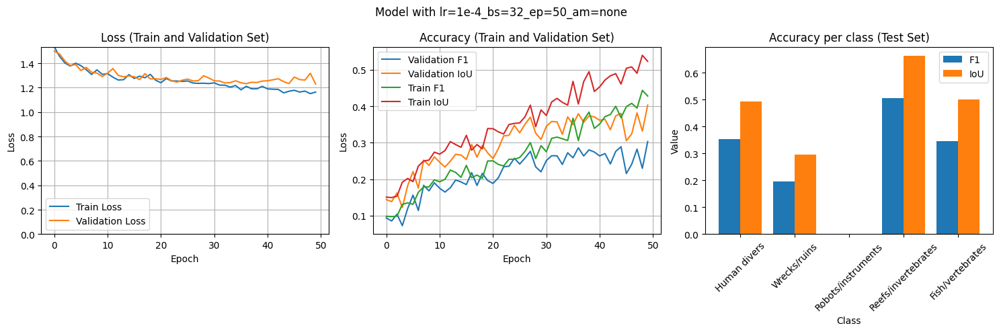

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
c:\Python312\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:425: The 'test_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=7` in the `DataLoader` to improve performance.


Testing: |          | 0/? [00:00<?, ?it/s]

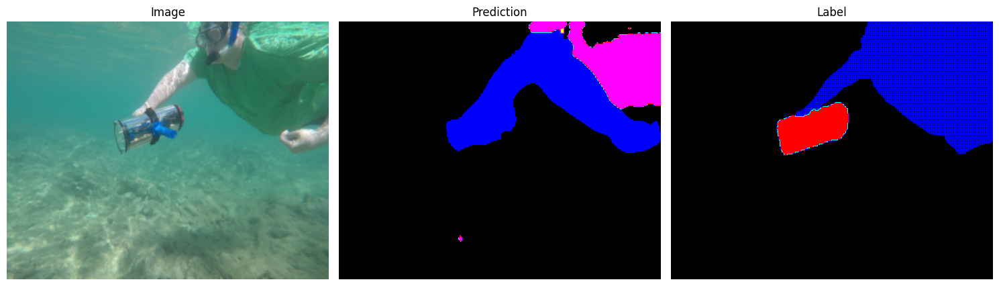

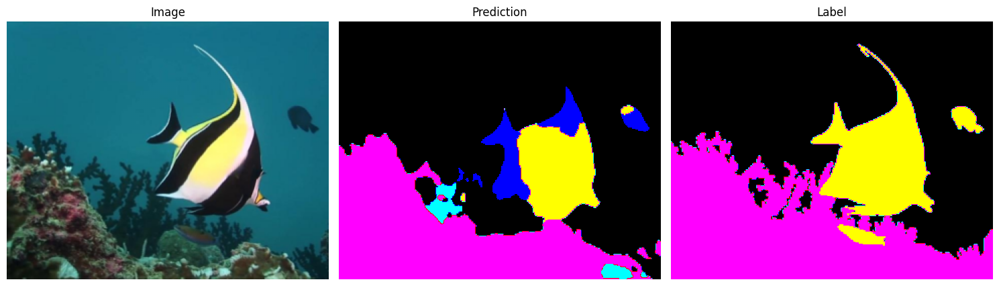

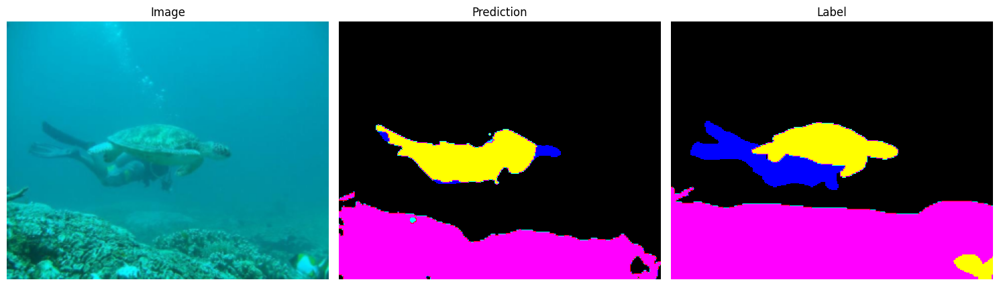

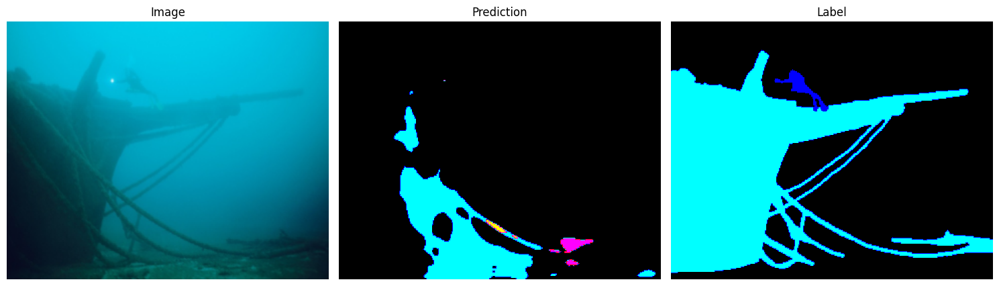

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│   test/f1_class_0_epoch   │    0.7900495529174805     │
│   test/f1_class_1_epoch   │    0.32381758093833923    │
│   test/f1_class_2_epoch   │    0.12580546736717224    │
│   test/f1_class_3_epoch   │            0.0            │
│   test/f1_class_4_epoch   │    0.5068300366401672     │
│   test/f1_class_5_epoch   │    0.3148517906665802     │
│  test/iou_class_0_epoch   │    0.8818959593772888     │
│  test/iou_class_1_epoch   │    0.4673164486885071     │
│  test/iou_class_2_epoch   │     0.196309432387352     │
│  test/iou_class_3_epoch   │            0.0            │
│  test/iou_class_4_epoch   │    0.6633164882659912     │
│  test/iou_class_5_epoch   │    0.4659758508205414     │
│      test/loss_epoch      │    1.2580552101135254     │
└───────────────────────────┴───────────────────────────┘

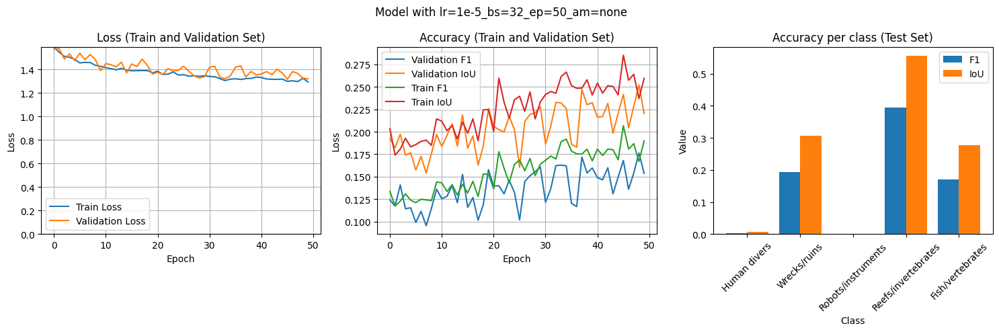

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
c:\Python312\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:425: The 'test_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=7` in the `DataLoader` to improve performance.


Testing: |          | 0/? [00:00<?, ?it/s]

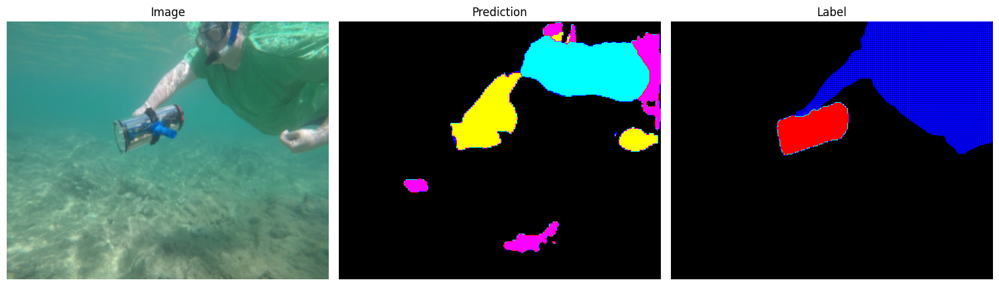

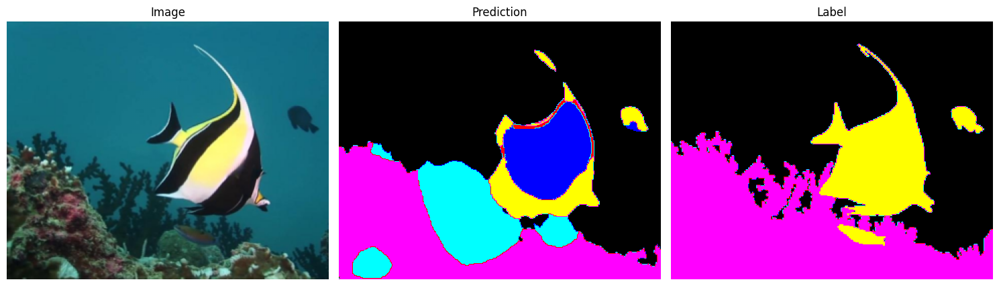

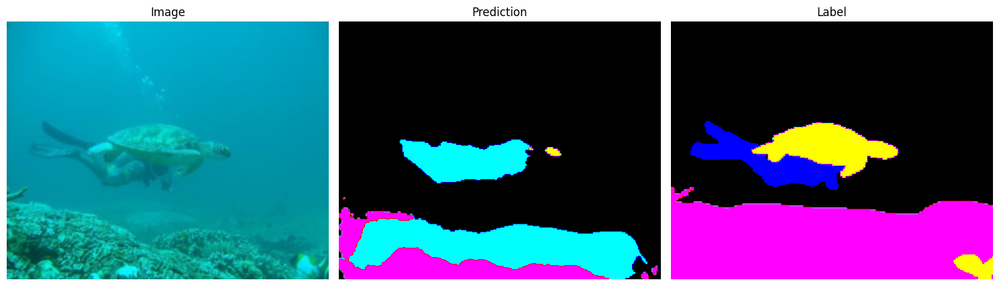

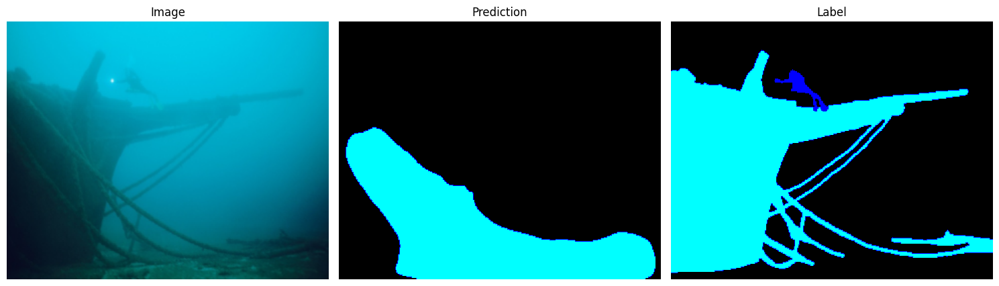

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│   test/f1_class_0_epoch   │    0.7684091329574585     │
│   test/f1_class_1_epoch   │   0.009971444495022297    │
│   test/f1_class_2_epoch   │    0.16016162931919098    │
│   test/f1_class_3_epoch   │            0.0            │
│   test/f1_class_4_epoch   │    0.4061962962150574     │
│   test/f1_class_5_epoch   │    0.1753622591495514     │
│  test/iou_class_0_epoch   │     0.868384599685669     │
│  test/iou_class_1_epoch   │   0.019710469990968704    │
│  test/iou_class_2_epoch   │    0.2336246818304062     │
│  test/iou_class_3_epoch   │            0.0            │
│  test/iou_class_4_epoch   │    0.5693411827087402     │
│  test/iou_class_5_epoch   │    0.29613974690437317    │
│      test/loss_epoch      │    1.2973508834838867     │
└───────────────────────────┴───────────────────────────┘

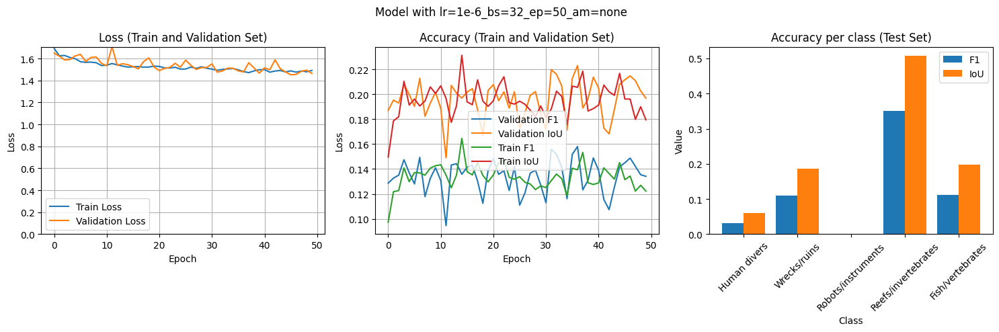

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
c:\Python312\Lib\site-packages\pytorch_lightning\trainer\connectors\data_connector.py:425: The 'test_dataloader' does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` to `num_workers=7` in the `DataLoader` to improve performance.


Testing: |          | 0/? [00:00<?, ?it/s]

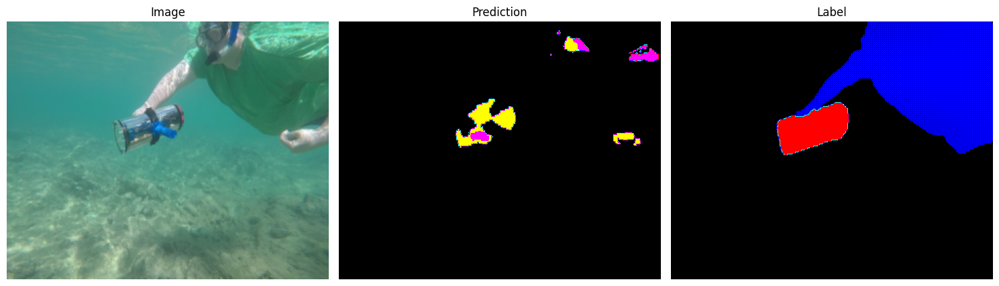

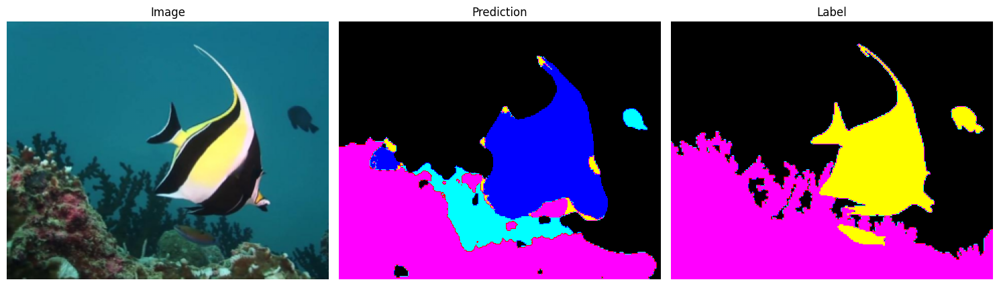

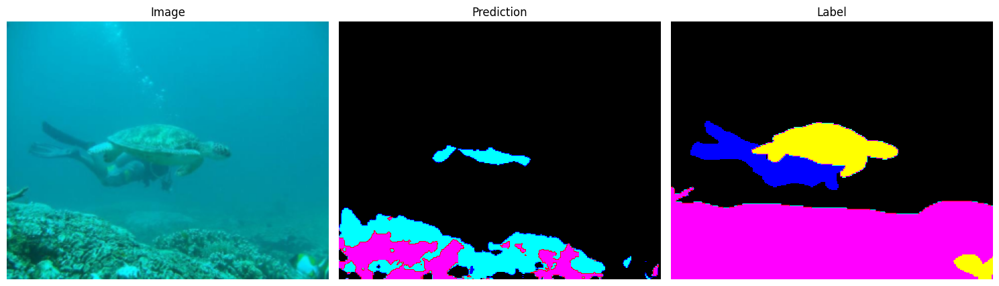

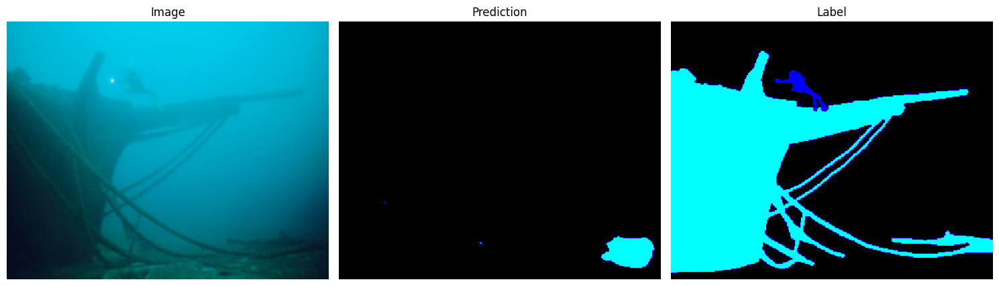

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│   test/f1_class_0_epoch   │    0.7401247024536133     │
│   test/f1_class_1_epoch   │   0.022046197205781937    │
│   test/f1_class_2_epoch   │    0.08705300092697144    │
│   test/f1_class_3_epoch   │   3.563970312825404e-05   │
│   test/f1_class_4_epoch   │    0.3824824392795563     │
│   test/f1_class_5_epoch   │    0.12101157754659653    │
│  test/iou_class_0_epoch   │     0.850065290927887     │
│  test/iou_class_1_epoch   │    0.04270566999912262    │
│  test/iou_class_2_epoch   │    0.14510057866573334    │
│  test/iou_class_3_epoch   │   7.127068238332868e-05   │
│  test/iou_class_4_epoch   │    0.5478124618530273     │
│  test/iou_class_5_epoch   │    0.21442721784114838    │
│      test/loss_epoch      │     1.413517951965332     │
└───────────────────────────┴───────────────────────────┘

In [ ]:
evaluate_model(SUIMNetRSB(num_classes = 6), baseline_test_dataloader, "lr=1e-4_bs=32_ep=50_am=none",  "SUIMNetRSB")
evaluate_model(SUIMNetRSB(num_classes = 6), baseline_test_dataloader, "lr=1e-5_bs=32_ep=50_am=none",  "SUIMNetRSB")
evaluate_model(SUIMNetRSB(num_classes = 6), baseline_test_dataloader, "lr=1e-6_bs=32_ep=50_am=none",  "SUIMNetRSB")

## Data Augmentation

In diesem Abschnitt werden Methoden zur Data Augmentation angwendet, welche auch im Paper aus der Aufgabenstellung erwähnt sind. Es sind dies folgende Operationen:

- Rotation: 0.2, respektive +/- 20 % von 350°
- Shifts in der Höhe und Breite um 0.05
- Zoom um 0.05
- Shearing in x und y Richtung um 0.05
- Horizontaler Flip

Diese Operationen werden zufällig auf Bilder und Labels im Dataset angewandt, mit dem Ziel, Overfitting zu verhindern. Evaluiert wird die Data Augmentation auf diejenigen Modelle, welche in den vorherigen Versuchen die besten Werte geliefert haben, SuimNet VGG16 und ResNet50.

In [ ]:
augmentations = A.Compose([
    # Random rotation
    A.ShiftScaleRotate(
        rotate_limit=0.2 * 360,   # Rotate range ±20% of 360 degrees
        shift_limit=0.05,         # Both width and height shift range
        scale_limit=0.05,         # Zoom range
    ),
    # Random shearing
    A.Affine(
        shear={"x": 0.05, "y": 0.05},  # Apply shear transformations
    ),
    # Horizontal flip
    A.HorizontalFlip(p=0.5)
], is_check_shapes=False)

batch_size = 32

transform_labels = transforms.Compose([
    transforms.Resize((224, 224)),
])

### SuimNet VGG16

#### Training

In [ ]:
vgg16optimized_train_dataset = SuimDataset(
    data_tuples_paths   = train_tuples_paths,
    color_mapping       = colors_to_5cats,
    transform_images    = VGG16_Weights.IMAGENET1K_V1.transforms(),
    transform_labels    = transform_labels,
    augmentations       = augmentations)
vgg16optimized_train_dataloader = DataLoader(vgg16optimized_train_dataset, batch_size = batch_size, shuffle = True)

vgg16optimized_validation_dataset = SuimDataset(
    data_tuples_paths   = validation_tuples_paths,
    color_mapping       = colors_to_5cats,
    transform_images    = VGG16_Weights.IMAGENET1K_V1.transforms(),
    transform_labels    = transform_labels,
    augmentations       = augmentations)
vgg16optimized_validation_dataloader = DataLoader(vgg16optimized_validation_dataset, batch_size = batch_size, shuffle = False)

vgg16optimized_test_dataset = SuimDataset(
    data_tuples_paths   = test_tuples_paths,
    color_mapping       = colors_to_5cats,
    transform_images    = VGG16_Weights.IMAGENET1K_V1.transforms(),
    transform_labels    = transform_labels,
    augmentations       = augmentations)
vgg16optimized_test_dataloader = DataLoader(vgg16optimized_test_dataset, batch_size = batch_size, shuffle = False)

In [ ]:
path = train_model(
    model                   = SUIMNetVGG16Optimized(num_classes = 6),
    train_dataloader        = vgg16optimized_train_dataloader,
    validation_dataloader   = vgg16optimized_validation_dataloader,
    test_dataloader         = vgg16optimized_test_dataloader,
    model_name              = "SUIMNetVGG16Optimized",
    lr                      = 1e-5)

analyze_metrics(path)

In [ ]:
path = train_model(
    model                   = SUIMNetVGG16Optimized(num_classes = 6),
    train_dataloader        = vgg16optimized_train_dataloader,
    validation_dataloader   = vgg16optimized_validation_dataloader,
    test_dataloader         = vgg16optimized_test_dataloader,
    model_name              = "SUIMNetVGG16Optimized",
    lr                      = 1e-6,
    max_epochs              = 100)

analyze_metrics(path)

#### Evaluation

- Learning Rate: $10^{-5}$
- Batch Size: 32
- Epochs: 50
- Data Augmentation: Yes

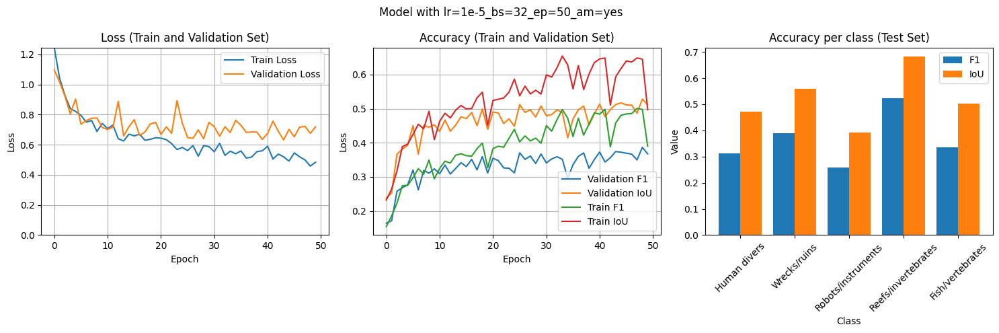

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: |          | 0/? [00:00<?, ?it/s]

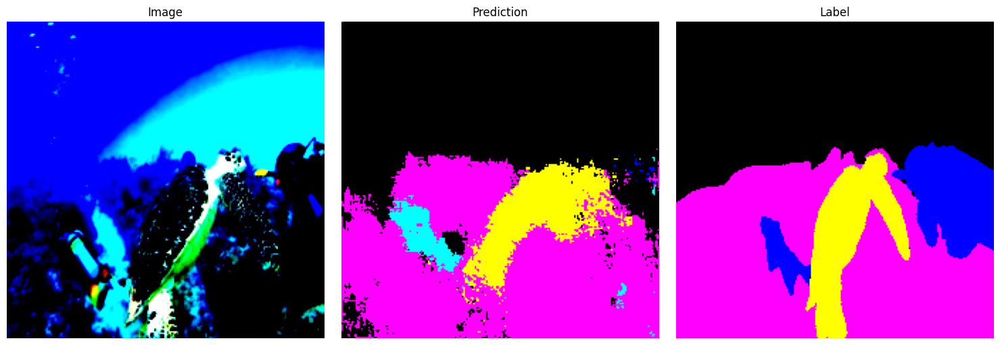

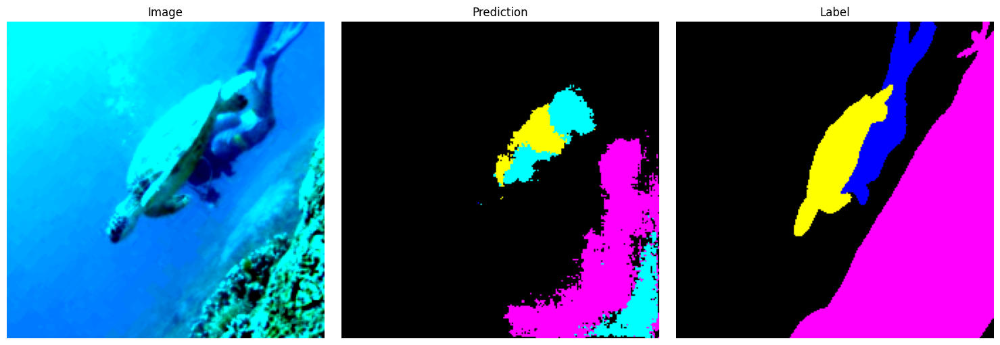

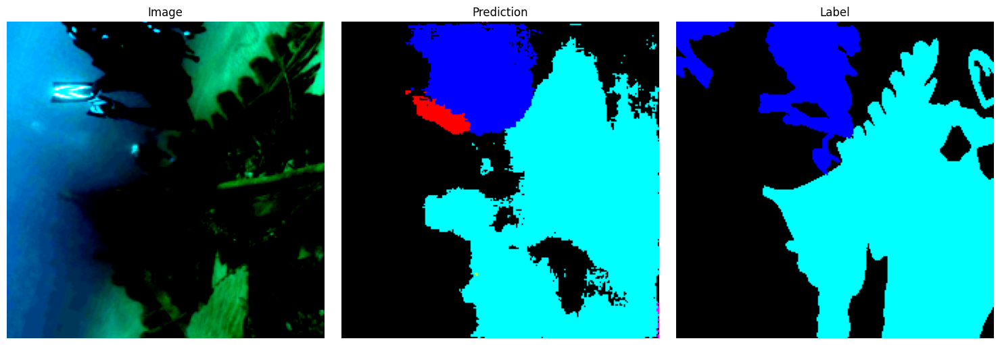

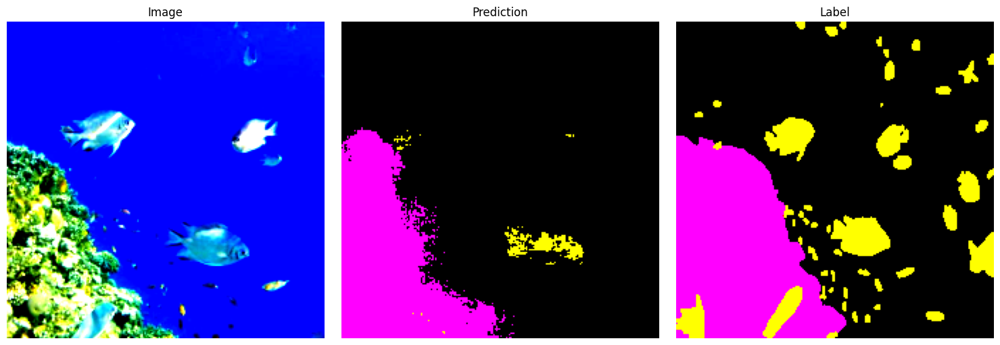

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│   test/f1_class_0_epoch   │    0.7309438586235046     │
│   test/f1_class_1_epoch   │    0.27348241209983826    │
│   test/f1_class_2_epoch   │    0.3870977461338043     │
│   test/f1_class_3_epoch   │    0.2181345820426941     │
│   test/f1_class_4_epoch   │    0.5174452066421509     │
│   test/f1_class_5_epoch   │    0.3878713548183441     │
│  test/iou_class_0_epoch   │    0.8442435264587402     │
│  test/iou_class_1_epoch   │    0.4239017367362976     │
│  test/iou_class_2_epoch   │     0.557240903377533     │
│  test/iou_class_3_epoch   │    0.32879385352134705    │
│  test/iou_class_4_epoch   │    0.6776253581047058     │
│  test/iou_class_5_epoch   │    0.5571999549865723     │
│      test/loss_epoch      │    0.6925320029258728     │
└───────────────────────────┴───────────────────────────┘

In [ ]:
evaluate_model(SUIMNetVGG16Optimized(num_classes = 6), vgg16optimized_test_dataloader, "lr=1e-5_bs=32_ep=50_am=yes",  "SUIMNetVGG16Optimized")

Die Data Augmentation führt beim SuimNet VGG16 Model mit einer Learning Rate von $10^{-5}$ dazu, dass der Validation Loss etwas stärker sinkt, als ohne Augmentation. Train Loss und Validation Loss sind näher beieinander, was sich damit erklären lässt, dass sich sich die Bilder des Trainings-Set in jeder Epoche leicht ändern, und sich das Model damit overfitted. Die Accurracy einzelner Klassen sind leicht höher als ohne Data Augmentation

- Learning Rate: $10^{-6}$
- Batch Size: 32
- Epochs: 100
- Data Augmentation: Yes

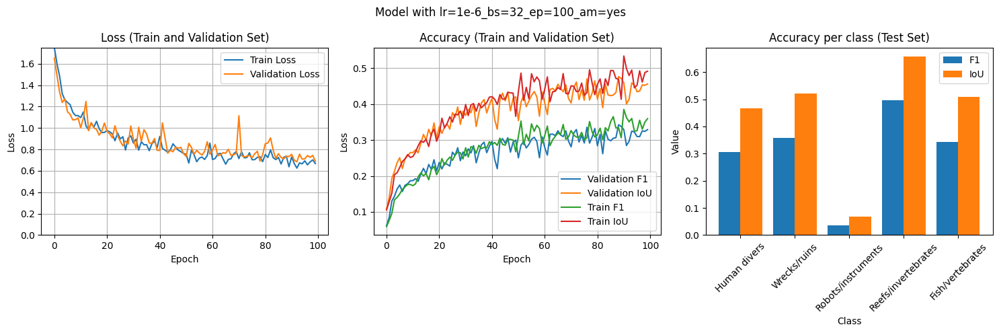

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: |          | 0/? [00:00<?, ?it/s]

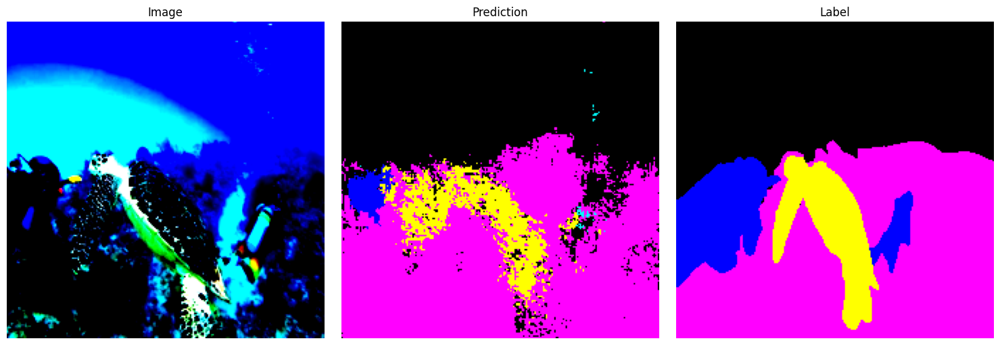

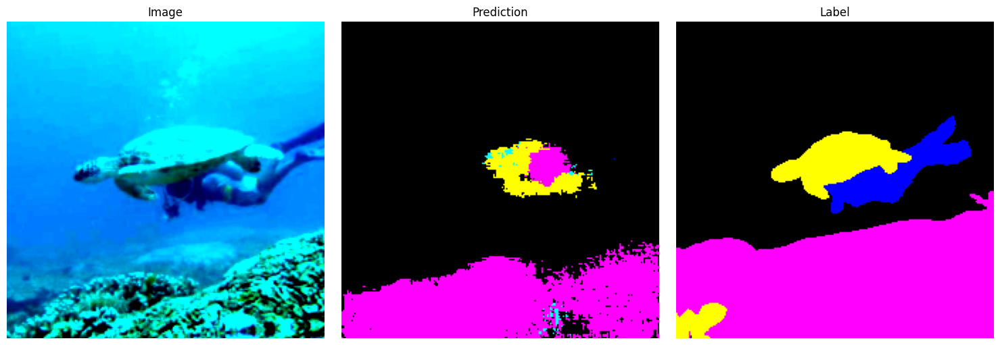

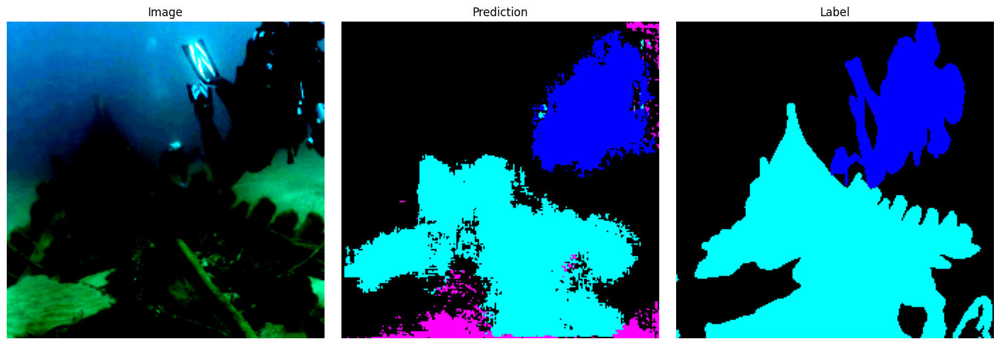

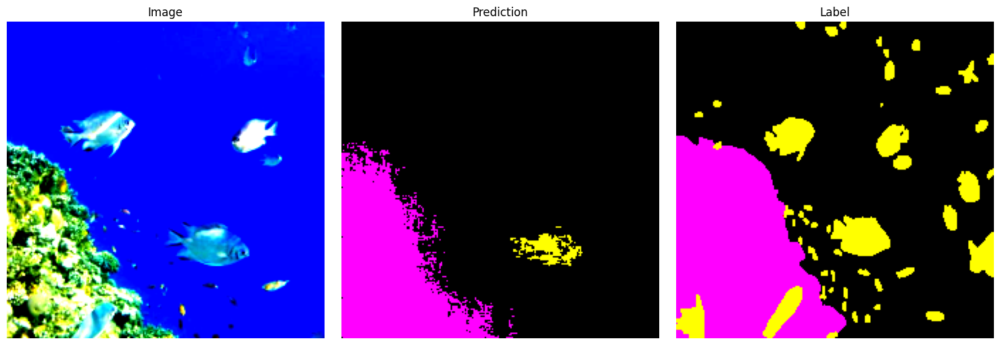

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│   test/f1_class_0_epoch   │    0.7357380986213684     │
│   test/f1_class_1_epoch   │    0.2653788924217224     │
│   test/f1_class_2_epoch   │    0.3243745267391205     │
│   test/f1_class_3_epoch   │   0.004707635845988989    │
│   test/f1_class_4_epoch   │    0.48883071541786194    │
│   test/f1_class_5_epoch   │    0.32276132702827454    │
│  test/iou_class_0_epoch   │    0.8475311994552612     │
│  test/iou_class_1_epoch   │    0.41737282276153564    │
│  test/iou_class_2_epoch   │    0.48589837551116943    │
│  test/iou_class_3_epoch   │   0.009180511347949505    │
│  test/iou_class_4_epoch   │    0.6512126326560974     │
│  test/iou_class_5_epoch   │    0.4867294728755951     │
│      test/loss_epoch      │    0.7139614820480347     │
└───────────────────────────┴───────────────────────────┘

In [ ]:
evaluate_model(SUIMNetVGG16Optimized(num_classes = 6), vgg16optimized_test_dataloader, "lr=1e-6_bs=32_ep=100_am=yes",  "SUIMNetVGG16Optimized")

Bei einer Learning Rate von $10^{-6}$ sind dieselben Effekte zu beobachten. Der Loss wird etwas tiefer, die Accuracy leicht höher. Die Loss- und Accuracy-Werte von Training und Test sind beinahe identisch.

### ResNet50

#### Training

In [ ]:
resnet50_train_dataset = SuimDataset(
    data_tuples_paths   = train_tuples_paths,
    color_mapping       = colors_to_5cats,
    transform_images    = ResNet50_Weights.IMAGENET1K_V1.transforms(),
    transform_labels    = transform_labels,
    augmentations       = augmentations)
resnet50_train_dataloader = DataLoader(resnet50_train_dataset, batch_size = batch_size, shuffle = True)

resnet50_validation_dataset = SuimDataset(
    data_tuples_paths   = validation_tuples_paths,
    color_mapping       = colors_to_5cats,
    transform_images    = ResNet50_Weights.IMAGENET1K_V1.transforms(),
    transform_labels    = transform_labels,
    augmentations       = augmentations)
resnet50_validation_dataloader = DataLoader(resnet50_validation_dataset, batch_size = batch_size, shuffle = False)

resnet50_test_dataset = SuimDataset(
    data_tuples_paths   = test_tuples_paths,
    color_mapping       = colors_to_5cats,
    transform_images    = ResNet50_Weights.IMAGENET1K_V1.transforms(),
    transform_labels    = transform_labels,
    augmentations       = augmentations)
resnet50_test_dataloader = DataLoader(resnet50_test_dataset, batch_size = batch_size, shuffle = False)

In [ ]:
path = train_model(
    model                   = ResNet50Segmentation(num_classes = 6),
    train_dataloader        = resnet50_train_dataloader,
    validation_dataloader   = resnet50_validation_dataloader,
    test_dataloader         = resnet50_test_dataloader,
    model_name              = "ResNet50Segmentation",
    lr                      = 1e-5)

analyze_metrics(path)

In [ ]:
path = train_model(
    model                   = ResNet50Segmentation(num_classes = 6),
    train_dataloader        = resnet50_train_dataloader,
    validation_dataloader   = resnet50_validation_dataloader,
    test_dataloader         = resnet50_test_dataloader,
    model_name              = "ResNet50Segmentation",
    lr                      = 1e-6,
    max_epochs              = 100)

analyze_metrics(path)

#### Evaluation

- Learning Rate: $10^{-5}$
- Batch Size: 32
- Epochs: 50
- Data Augmentation: Yes

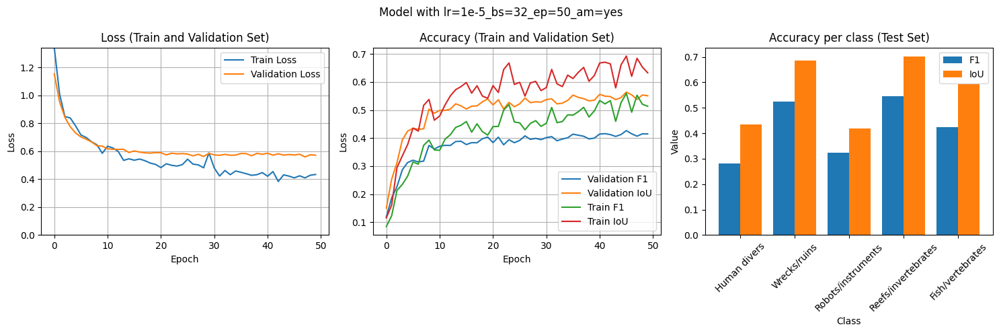

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: |          | 0/? [00:00<?, ?it/s]

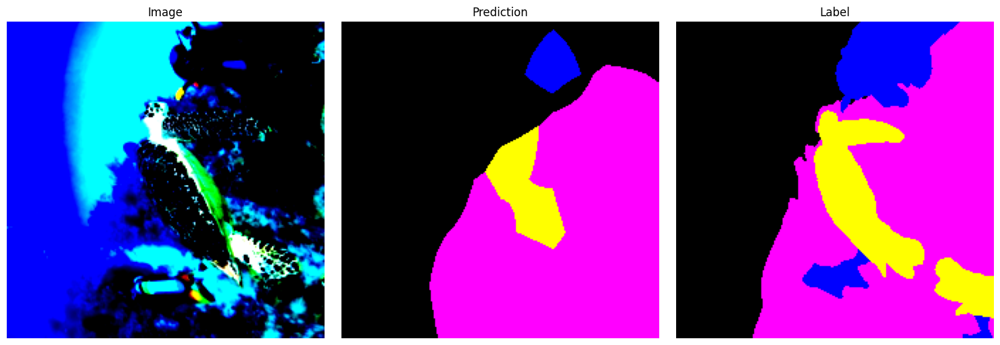

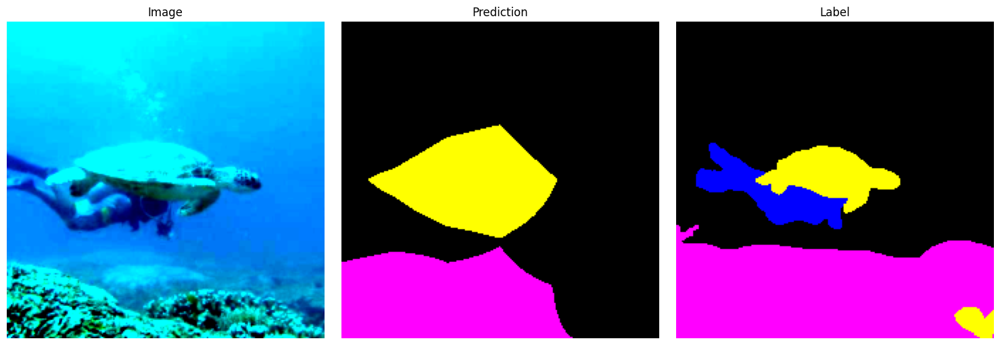

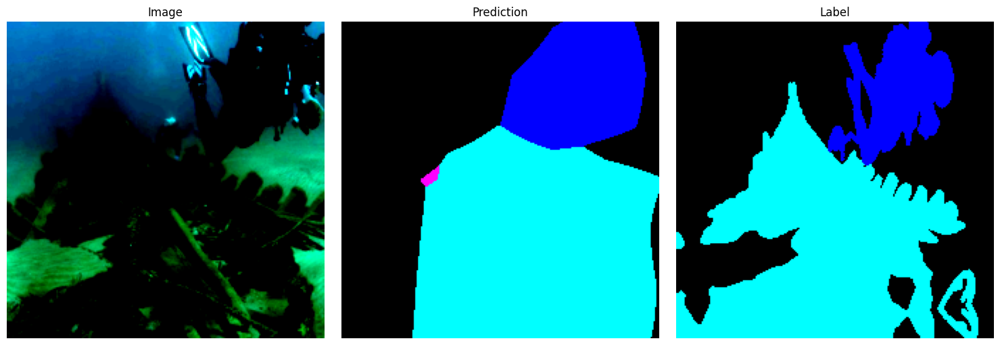

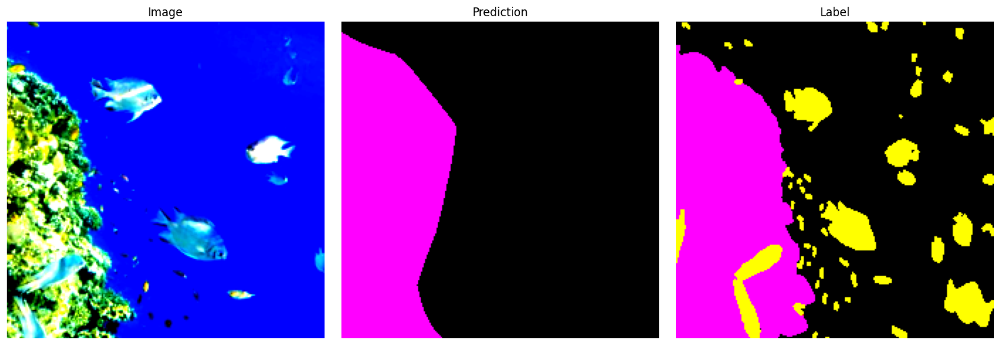

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│   test/f1_class_0_epoch   │    0.7555160522460938     │
│   test/f1_class_1_epoch   │    0.27001211047172546    │
│   test/f1_class_2_epoch   │    0.4934979975223541     │
│   test/f1_class_3_epoch   │    0.2529764473438263     │
│   test/f1_class_4_epoch   │    0.5688368678092957     │
│   test/f1_class_5_epoch   │    0.4072112441062927     │
│  test/iou_class_0_epoch   │    0.8604874610900879     │
│  test/iou_class_1_epoch   │    0.4225962460041046     │
│  test/iou_class_2_epoch   │    0.6599761843681335     │
│  test/iou_class_3_epoch   │    0.3312671184539795     │
│  test/iou_class_4_epoch   │    0.7219045758247375     │
│  test/iou_class_5_epoch   │      0.5753213763237      │
│      test/loss_epoch      │    0.6131362318992615     │
└───────────────────────────┴───────────────────────────┘

In [ ]:
evaluate_model(ResNet50Segmentation(num_classes = 6), resnet50_test_dataloader, "lr=1e-5_bs=32_ep=50_am=yes",  "ResNet50Segmentation")

Beim ResNet50 Model mit einer Learning Rate von $10^{-5}$ ist ein Divergieren der Loss-Kurven von Train und Validation zu erkennen. Wird die Data Augmentation angewendet, wird das Divergieren schwächer, der Validation-Loss wird jedoch nur minim tiefer. Die Accurracy von gewissen Klassen (Human divers) wird etwas schlechter, während die Accuracy von anderen Klassen leicht besser wird (Wrecks / ruins, Robots / instruments).

- Learning Rate: $10^{-6}$
- Batch Size: 32
- Epochs: 100
- Data Augmentation: Yes

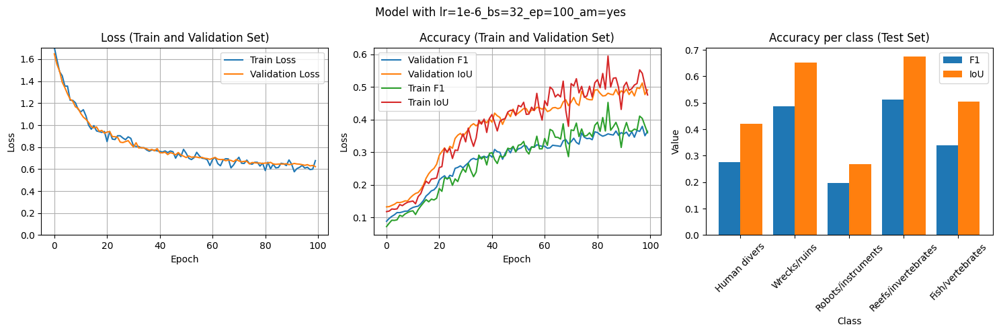

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: |          | 0/? [00:00<?, ?it/s]

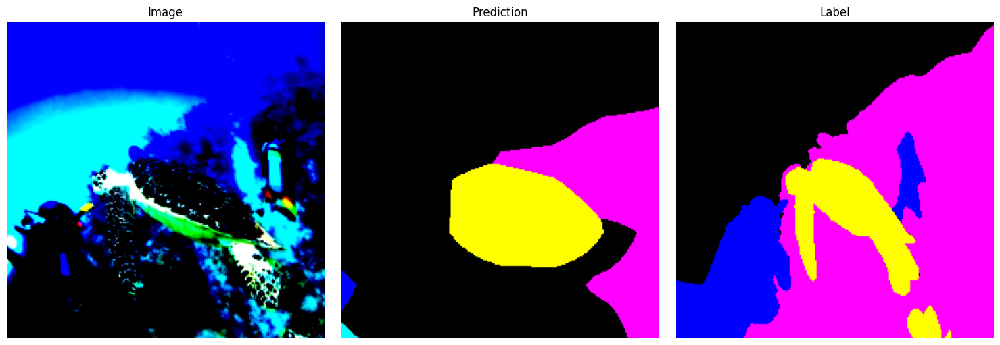

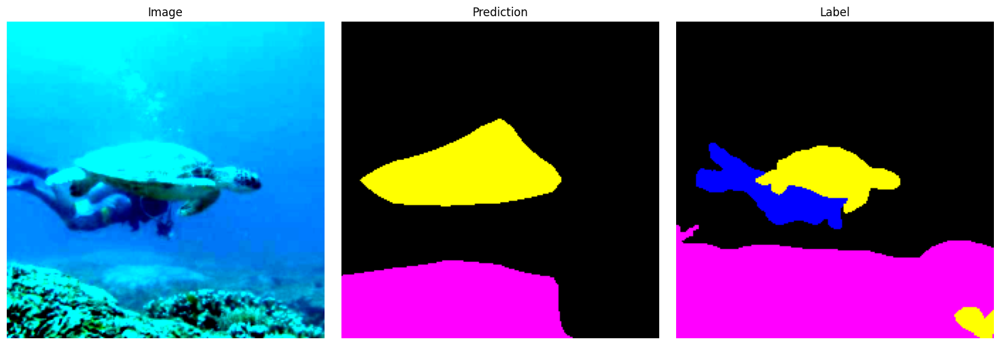

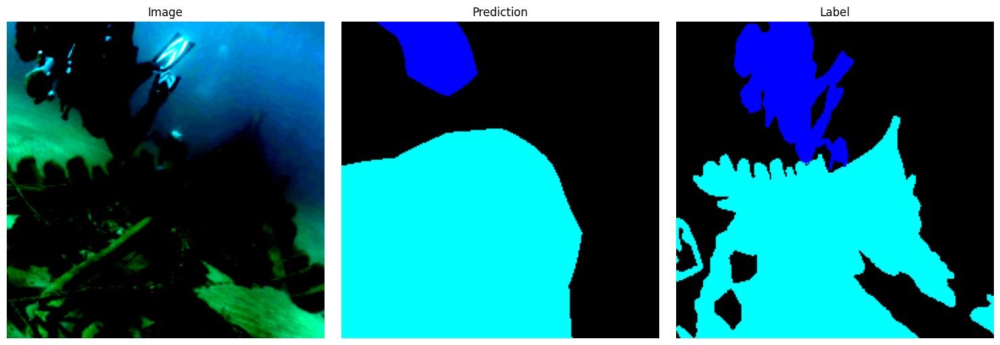

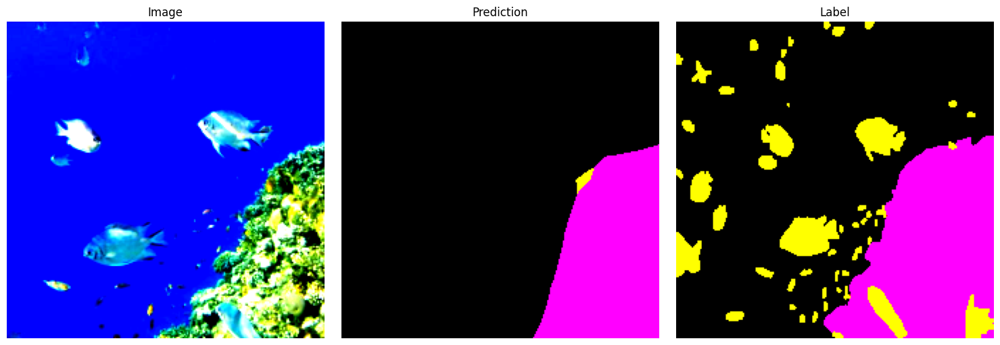

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│   test/f1_class_0_epoch   │    0.7190768718719482     │
│   test/f1_class_1_epoch   │    0.30687835812568665    │
│   test/f1_class_2_epoch   │    0.4806124269962311     │
│   test/f1_class_3_epoch   │    0.05371076241135597    │
│   test/f1_class_4_epoch   │    0.5086132884025574     │
│   test/f1_class_5_epoch   │     0.365963339805603     │
│  test/iou_class_0_epoch   │    0.8363911509513855     │
│  test/iou_class_1_epoch   │    0.46600794792175293    │
│  test/iou_class_2_epoch   │    0.6445927023887634     │
│  test/iou_class_3_epoch   │    0.08175615221261978    │
│  test/iou_class_4_epoch   │    0.6705970764160156     │
│  test/iou_class_5_epoch   │    0.5326460003852844     │
│      test/loss_epoch      │    0.6736091375350952     │
└───────────────────────────┴───────────────────────────┘

In [ ]:
evaluate_model(ResNet50Segmentation(num_classes = 6), resnet50_test_dataloader, "lr=1e-6_bs=32_ep=100_am=yes",  "ResNet50Segmentation")

Bei einer Learning Rate von $10^{-6}$ sind wiederum dieselben Effekte zu beobachten. Die Divergenz zwischen der Train- und Validation-Loss nimmt ab, die beiden Kurven sind fast identisch. Die Accuracy einzelner Klassen wird wiederum leicht besser, während andere etwas schlechter werden.

Zusammenfassen kann gesagt werden, dass die Data Augmentation die Divergenz der Train- und Varianz-Loss-Kurven verkleinert oder verhindert. Auf den Accuracy-Wert hat die Data Augmentation beim SuimNet VGG16 Model einen positiven Einfluss, beim ResNet50 Model kann keine klar positive Tendenz erkennt werden.

## Results

In diesem Abschnitt wird auf die Resultate der beiden besten Modellen eingegangen. Die detailierten Resultate aller Modelle mit unterschiedlichen Konfigurationen sind in den jeweiligen Abschnitten der Modelle zu finden.

### SuimNet VGG16

Die nachfolgende Konfiguration bringt mit dem SuimNet VGG16 Modell die besten Loss- und Accuracy-Werte:

- Learning Rate: $10^{-5}$
- Batch Size: 32
- Epochs: 50
- Data Augmentation: Yes

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: |          | 0/? [00:00<?, ?it/s]

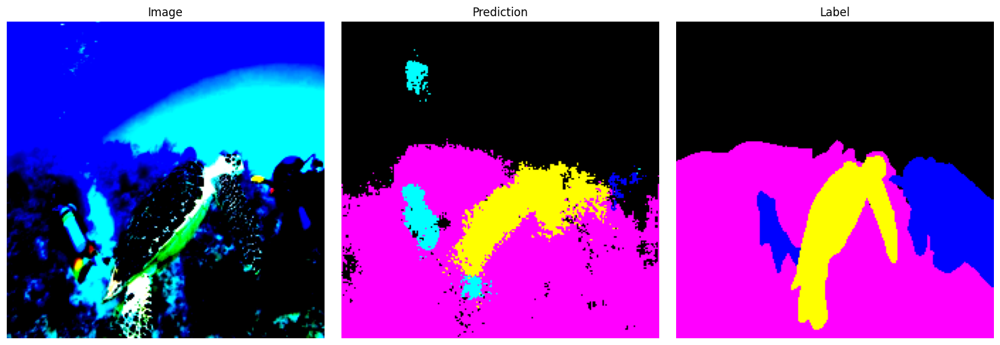

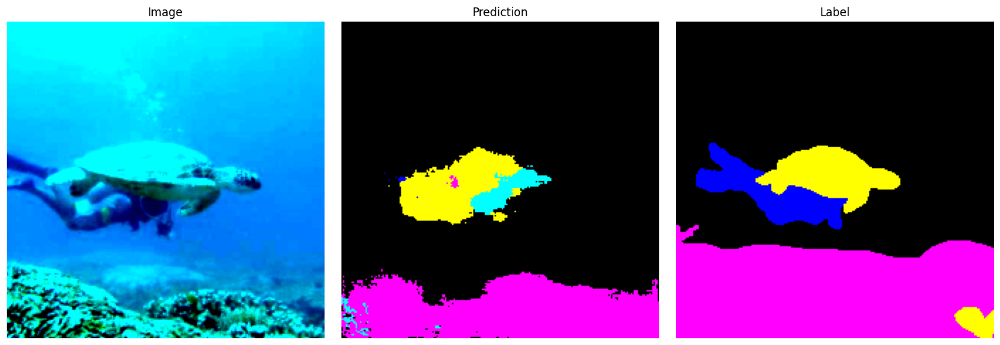

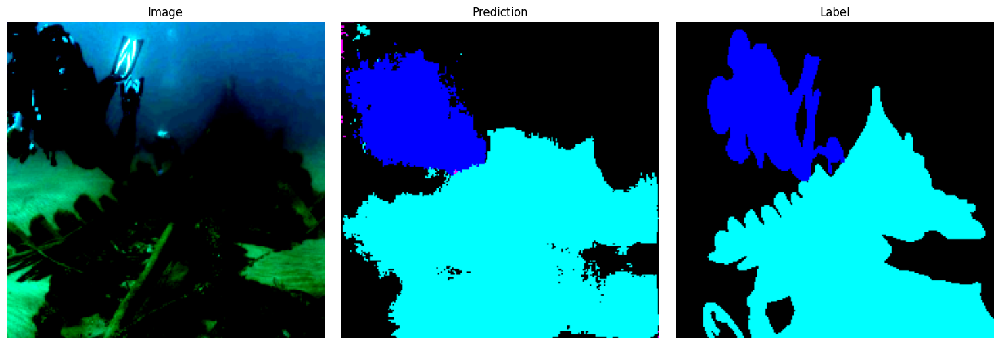

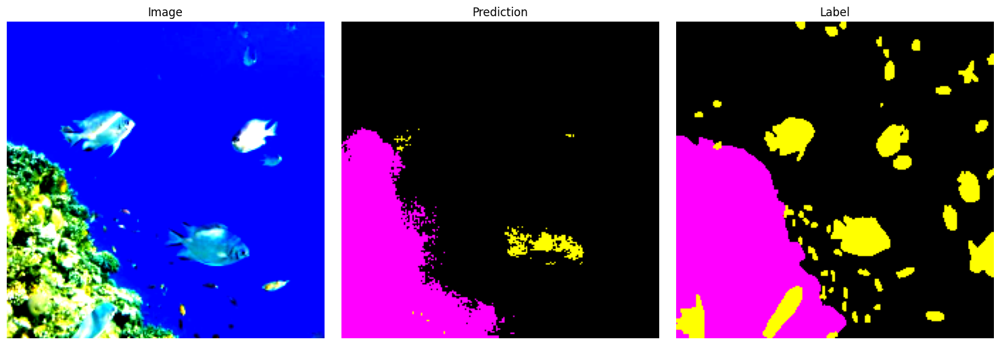

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│   test/f1_class_0_epoch   │    0.7448638677597046     │
│   test/f1_class_1_epoch   │    0.3080383539199829     │
│   test/f1_class_2_epoch   │    0.4453050196170807     │
│   test/f1_class_3_epoch   │    0.2824486792087555     │
│   test/f1_class_4_epoch   │     0.543771505355835     │
│   test/f1_class_5_epoch   │    0.41980278491973877    │
│  test/iou_class_0_epoch   │    0.8533881306648254     │
│  test/iou_class_1_epoch   │    0.4646146297454834     │
│  test/iou_class_2_epoch   │    0.6142866611480713     │
│  test/iou_class_3_epoch   │    0.42031005024909973    │
│  test/iou_class_4_epoch   │    0.6998340487480164     │
│  test/iou_class_5_epoch   │    0.5886681079864502     │
│      test/loss_epoch      │    0.6401612758636475     │
└───────────────────────────┴───────────────────────────┘

In [23]:
load_and_test_model(SUIMNetVGG16Optimized(num_classes = 6), vgg16optimized_test_dataloader, "lr=1e-5_bs=32_ep=50_am=yes",  "SUIMNetVGG16Optimized")

Die obigen Bilder zeigen, dass schemenhaft viele Objekte erkannt werden. Allerdings wird die Kontur oft nicht korrekt erkannt. Auch bei kleinen Objekten, beispielsweise den Fischen im letzten Bild, hat das Modell Mühe.

### ResNet50

Die nachfolgende Konfiguration bringt mit dem ResNet50 Modell die besten Loss- und Accuracy-Werte:

- Learning Rate: $10^{-6}$
- Batch Size: 8
- Epochs: 100
- Data Augmentation: keine

INFO:pytorch_lightning.utilities.rank_zero:GPU available: True (cuda), used: True
INFO:pytorch_lightning.utilities.rank_zero:TPU available: False, using: 0 TPU cores
INFO:pytorch_lightning.utilities.rank_zero:HPU available: False, using: 0 HPUs
INFO:pytorch_lightning.accelerators.cuda:LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]


Testing: |          | 0/? [00:00<?, ?it/s]

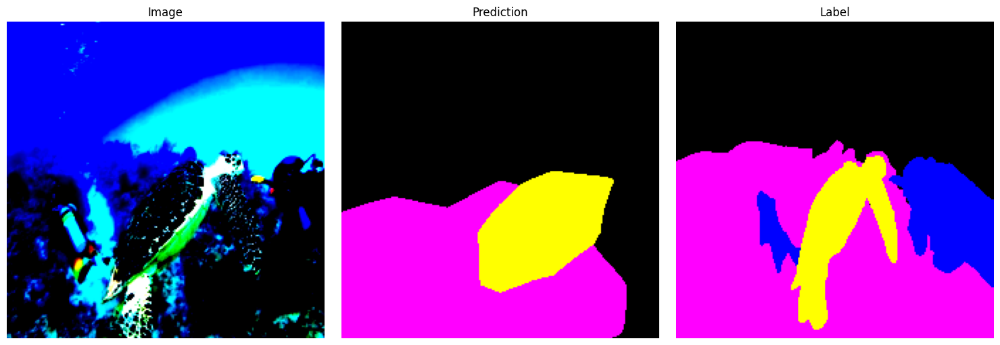

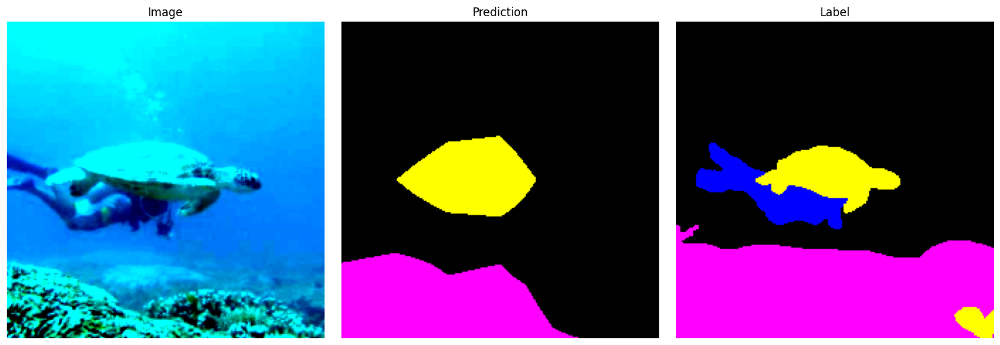

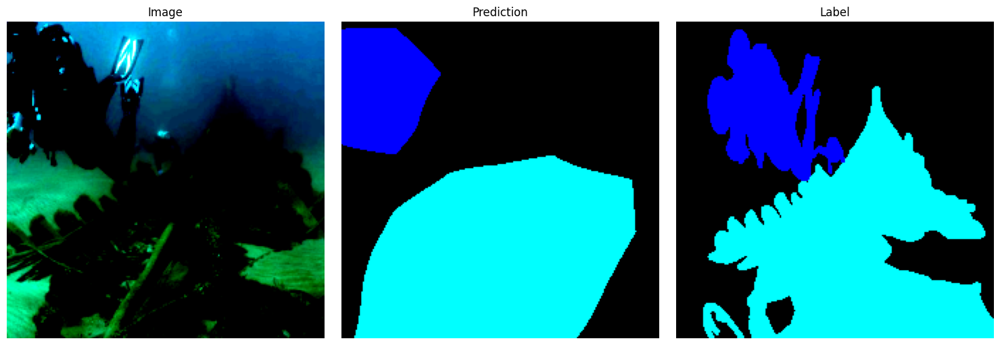

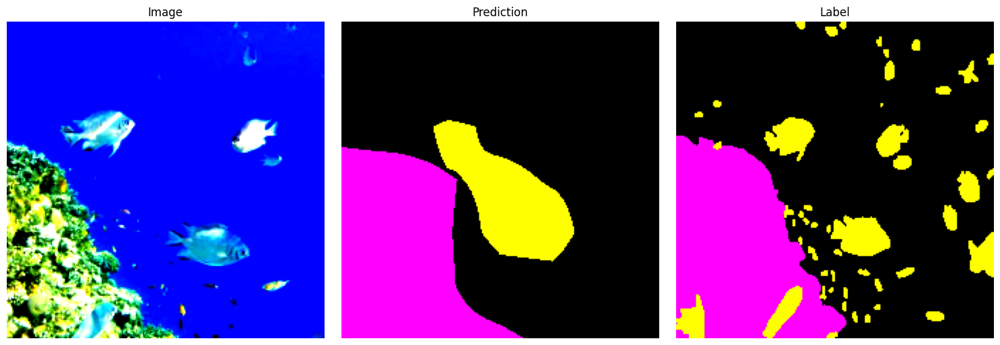

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━━━━┓
┃        Test metric        ┃       DataLoader 0        ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━━━━┩
│   test/f1_class_0_epoch   │    0.7463141679763794     │
│   test/f1_class_1_epoch   │    0.22018039226531982    │
│   test/f1_class_2_epoch   │    0.49483048915863037    │
│   test/f1_class_3_epoch   │    0.4025096297264099     │
│   test/f1_class_4_epoch   │    0.5319672226905823     │
│   test/f1_class_5_epoch   │    0.38851937651634216    │
│  test/iou_class_0_epoch   │    0.8544597029685974     │
│  test/iou_class_1_epoch   │    0.3565761148929596     │
│  test/iou_class_2_epoch   │    0.6571141481399536     │
│  test/iou_class_3_epoch   │    0.5466383099555969     │
│  test/iou_class_4_epoch   │    0.6927664279937744     │
│  test/iou_class_5_epoch   │    0.5546766519546509     │
│      test/loss_epoch      │    0.6199464797973633     │
└───────────────────────────┴───────────────────────────┘

In [25]:
load_and_test_model(ResNet50Segmentation(num_classes = 6), resnet50_test_dataloader, "lr=1e-6_bs=8_ep=100_am=none",  "ResNet50Segmentation")

In den obigen Bilder zeigt sich, dass das Modell grössere Objekte erkennt, diese allerdings mit sehr einfache Formen abdeckt, und so die Kontur nicht korrekt ist. Bei kleinen Objekten hat dieses Modell ebenfalls Mühe.

## Discussion

In diesem Notebook wurden verschiedene Modelle zur Segmentierung evaluiert. Dabei haben sich die Modelle SuimNet VGG16 und ResNet50 als diejenigen Modelle mit der höchsten Accuracy herauskristalisiert.
Beides sind Modelle, welche bereits vortrainierte Elemente verwenden. Dies ist eine mögliche Erklärung, weswegen diese Modelle besser funktionieren als die ebenfalls evaluierten Encoder-Decoder und SuimNet RSB Modelle.

Die angewendeten Data-Augmentation Methoden haben eine leichte Verbesserung der Accuracy erreicht und die Modelle weniger anfällig auf Overfitting gemacht.

Bei der Learning Rate hat sich gezeigt, dass mit tieferer Learning Rate die Loss-Kurve tiefer wird. Auch hat sich der Unterschied der Validation-Loss und Training-Loss Kurve mit tieferer Learning Rate verkleinert, was darauf hinweist, dass das Model weniger Overfitting aufweisst, also eine bessere Generalisierung aufweist. Allerdings hat sich die Accuracy mit tieferer Learning Rate verschlechtert, was wir uns nicht erklären konnten.

Die optimale Batch-Size ist abhängig vom gewählten Model. Bei SuimNet VGG16 performt das Model mit Batch-Size 32 deutlich besser als mit 8. Für ResNet50 liefert eine Batch-Size von 8 leicht bessere Resultate als mit 32.

Grundsätzlich lässt sich sagen, dass der Datensatz einige Probleme aufweisst:
- Zwei Klassen sind stark untervertreten (Human divers und Robots/instruments). Dies spiegelt sich auch in den Accuracy-Werten dieser Klassen wieder.
- Einige Bilder sind nicht korrekt gelabelt
- Einige Labels beinhalten Farbwerte, welcher nicht einer Kategorie entsprechen

Mit einem Pre-Processing konnten die Farbwerte korrigiert werden. Für die Ausgleichung der Untervertretung einiger Klasse müssten weitere Schritte vorgenommen werden, beispielsweise durch eine andere Aufteilung des Trainings- und Validation-Set oder durch Beschaffen von mehr Daten. Auf diese Schritte wurde im Rahmen dieses Miniprojektes verzichtet.

Die Resultate aus dem Paper konnten nicht erreicht werden. Unsere Vermutung ist, dass mit besserer Aufteilung der Trainings- und Validation-Daten bessere Resultate erzielt werden könnte.